In [2]:
import sys
print(sys.version)
print(sys.executable)


3.12.6 (tags/v3.12.6:a4a2d2b, Sep  6 2024, 20:11:23) [MSC v.1940 64 bit (AMD64)]
C:\Users\HDGW0570\AppData\Local\Programs\Python\Python312\python.exe


In [3]:
import mlflow, sklearn, pandas, numpy
import seaborn as sns
import matplotlib.pyplot as plt


In [4]:
import os
import pandas as pd

def import_all_csv_from_folder(folder_path, encoding='latin1'):
    # Dictionnaire pour stocker les DataFrames
    dataframes = {}
    
    # Parcourir tous les fichiers dans le dossier
    for filename in os.listdir(folder_path):
        if filename.endswith('.csv'):
            file_path = os.path.join(folder_path, filename)
            try:
                # Essayer avec l'encodage spécifié
                df = pd.read_csv(file_path, encoding=encoding)
            except UnicodeDecodeError:
                # Si erreur, essayer un autre encodage
                print(f"Erreur d'encodage avec {encoding} pour le fichier {filename}. Essayer avec un autre encodage.")
                continue
            key = os.path.splitext(filename)[0]
            dataframes[key] = df
    
    return dataframes


# Exemple d'utilisation
folder_path = '../data'
all_data = import_all_csv_from_folder(folder_path)

# Accéder à un DataFrame spécifique
# print(all_data['nom_du_fichier_sans_extension'])


# Exploratoire

In [5]:
df_test = all_data['application_test']
df_train = all_data['application_train']
print ('Dimension de df_test : ' + str(df_test.shape))
print ('Dimension de df_train : ' + str(df_train.shape))

Dimension de df_test : (48744, 121)
Dimension de df_train : (307511, 122)


## Distribution de la target

In [6]:
# Distribution de la target
df_train['TARGET'].value_counts()

TARGET
0    282686
1     24825
Name: count, dtype: int64

<Axes: ylabel='Frequency'>

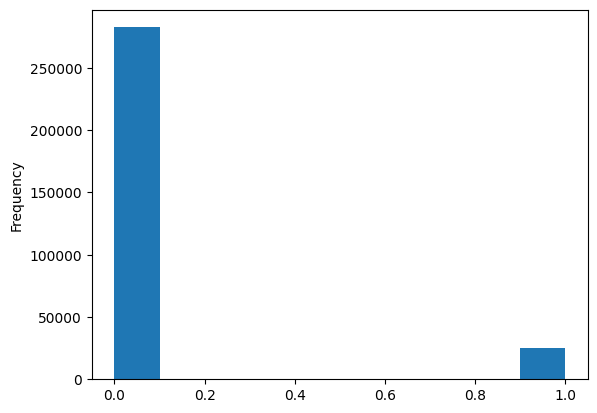

In [7]:
df_train['TARGET'].astype(int).plot.hist()

## Colonnes catégorielles

In [8]:
# Types de colonnes
df_train.dtypes.value_counts()

float64    65
int64      41
object     16
Name: count, dtype: int64

In [9]:
# Colonnes catégorielles
df_train.select_dtypes('object').apply(pd.Series.nunique, axis = 0)

NAME_CONTRACT_TYPE             2
CODE_GENDER                    3
FLAG_OWN_CAR                   2
FLAG_OWN_REALTY                2
NAME_TYPE_SUITE                7
NAME_INCOME_TYPE               8
NAME_EDUCATION_TYPE            5
NAME_FAMILY_STATUS             6
NAME_HOUSING_TYPE              6
OCCUPATION_TYPE               18
WEEKDAY_APPR_PROCESS_START     7
ORGANIZATION_TYPE             58
FONDKAPREMONT_MODE             4
HOUSETYPE_MODE                 3
WALLSMATERIAL_MODE             7
EMERGENCYSTATE_MODE            2
dtype: int64

LabelEncoder pour les catégories avec 2 valeurs

In [10]:
from sklearn.preprocessing import LabelEncoder

# Create a label encoder object
le = LabelEncoder()
le_count = 0

# Iterate through the columns
for col in df_train:
    if df_train[col].dtype == 'object':
        # If 2 or fewer unique categories
        if len(list(df_train[col].unique())) <= 2:
            # Train on the training data
            le.fit(df_train[col])
            # Transform both training and testing data
            df_train[col] = le.transform(df_train[col])
            df_test[col] = le.transform(df_test[col])
            
            # Keep track of how many columns were label encoded
            le_count += 1
            

print(f"{le_count} columns were label encoded:")

3 columns were label encoded:


OneHotEncoder pour les catégories avec au moins 3 valeurs

In [11]:
# One-hot encoding
df_train = pd.get_dummies(df_train)
df_test = pd.get_dummies(df_test)

print('Training Features shape: ', df_test.shape)
print('Testing Features shape: ', df_test.shape)

Training Features shape:  (48744, 239)
Testing Features shape:  (48744, 239)


## Valeurs aberrantes

In [12]:
# Année de naissance
(df_train['DAYS_BIRTH'] / -365).describe()

count    307511.000000
mean         43.936973
std          11.956133
min          20.517808
25%          34.008219
50%          43.150685
75%          53.923288
max          69.120548
Name: DAYS_BIRTH, dtype: float64

Pas de valeur anormale

In [13]:
# Nombre de jours depuis l'embauche (en négatif)
df_train['DAYS_EMPLOYED'].describe()

count    307511.000000
mean      63815.045904
std      141275.766519
min      -17912.000000
25%       -2760.000000
50%       -1213.000000
75%        -289.000000
max      365243.000000
Name: DAYS_EMPLOYED, dtype: float64

Il ne devrait pas y avoir de valeurs positives

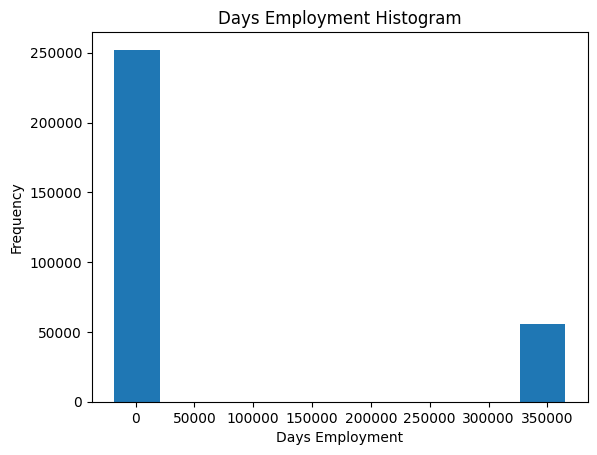

In [14]:

df_train['DAYS_EMPLOYED'].plot.hist(title = 'Days Employment Histogram');
plt.xlabel('Days Employment');

In [15]:
import numpy as np
# Remplacer par des valeurs nulles
df_train['DAYS_EMPLOYED'].replace({365243: np.nan}, inplace = True)

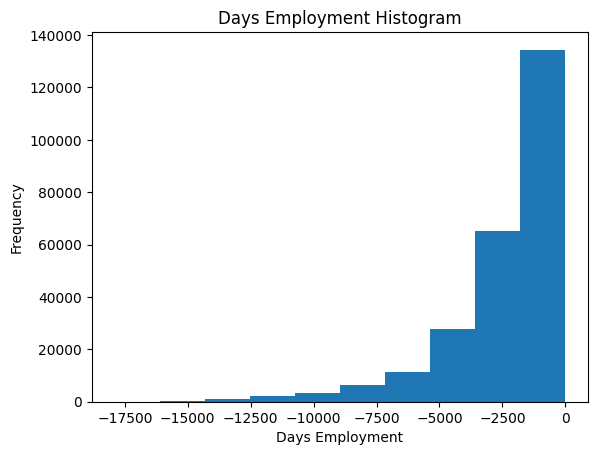

In [16]:

df_train['DAYS_EMPLOYED'].plot.hist(title = 'Days Employment Histogram');
plt.xlabel('Days Employment');

## Corrélations

In [17]:
# Find correlations with the target and sort
correlations = df_train.select_dtypes(include=['number']).corr()['TARGET'].sort_values()

# Display correlations
print('Most Positive Correlations:\n', correlations.tail(10))
print('\nMost Negative Correlations:\n', correlations.head(10))

Most Positive Correlations:
 REG_CITY_NOT_LIVE_CITY         0.044395
FLAG_EMP_PHONE                 0.045982
REG_CITY_NOT_WORK_CITY         0.050994
DAYS_ID_PUBLISH                0.051457
DAYS_LAST_PHONE_CHANGE         0.055218
REGION_RATING_CLIENT           0.058899
REGION_RATING_CLIENT_W_CITY    0.060893
DAYS_EMPLOYED                  0.074958
DAYS_BIRTH                     0.078239
TARGET                         1.000000
Name: TARGET, dtype: float64

Most Negative Correlations:
 EXT_SOURCE_3                 -0.178919
EXT_SOURCE_2                 -0.160472
EXT_SOURCE_1                 -0.155317
FLOORSMAX_AVG                -0.044003
FLOORSMAX_MEDI               -0.043768
FLOORSMAX_MODE               -0.043226
AMT_GOODS_PRICE              -0.039645
REGION_POPULATION_RELATIVE   -0.037227
ELEVATORS_AVG                -0.034199
ELEVATORS_MEDI               -0.033863
Name: TARGET, dtype: float64


In [18]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

def heatmap_corr_significative(df, target_col='TARGET', seuil=0.05):
    # Calculer la corrélation avec la colonne cible
    corr_with_target = df.select_dtypes(include=['number']).corr()[target_col]
    
    # Filtrer les colonnes avec une corrélation absolue >= seuil
    colonnes_filtrees = corr_with_target[abs(corr_with_target) >= seuil].index
    
    # Extraire la sous-matrice de corrélation
    corr_sub = df[colonnes_filtrees].corr()
    
    # Tracer la heatmap
    plt.figure(figsize=(10, 8))
    sns.heatmap(corr_sub, annot=True, fmt=".2f", cmap='coolwarm')
    plt.title(f'Heatmap des corrélations (|corr| >= {seuil}) avec {target_col}')
    plt.show()

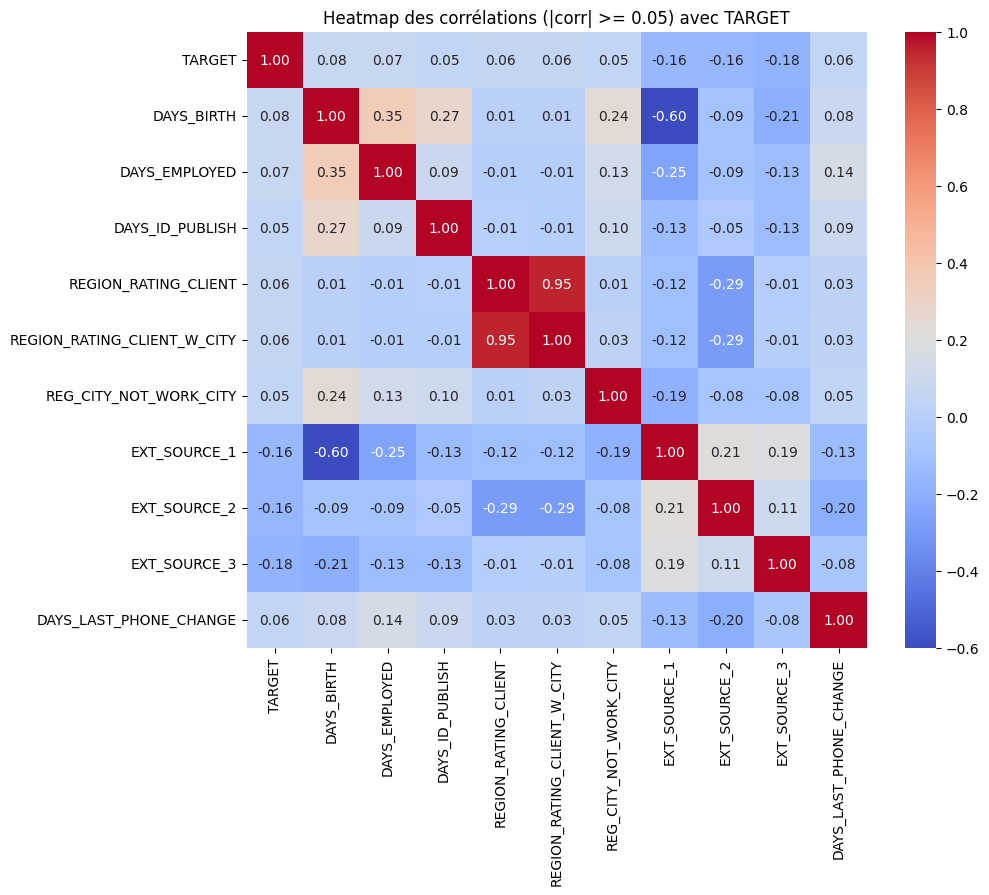

In [19]:
heatmap_corr_significative(df_train, seuil=0.05)

In [20]:
corr_with_target_df = correlations.to_frame(name='Correlation').reset_index().rename(columns={'index': 'feature'})
corr_with_target_df = corr_with_target_df[abs(corr_with_target_df['Correlation']) >= 0.05]

In [21]:
corr_with_target_df

,feature,Correlation
0,EXT_SOURCE_3,-0.178919
1,EXT_SOURCE_2,-0.160472
2,EXT_SOURCE_1,-0.155317
101,REG_CITY_NOT_WORK_CITY,0.050994
102,DAYS_ID_PUBLISH,0.051457
103,DAYS_LAST_PHONE_CHANGE,0.055218
104,REGION_RATING_CLIENT,0.058899
105,REGION_RATING_CLIENT_W_CITY,0.060893
106,DAYS_EMPLOYED,0.074958
107,DAYS_BIRTH,0.078239


In [22]:
cols_corr = corr_with_target_df['feature'].unique().tolist()
cols_corr

['EXT_SOURCE_3',
 'EXT_SOURCE_2',
 'EXT_SOURCE_1',
 'REG_CITY_NOT_WORK_CITY',
 'DAYS_ID_PUBLISH',
 'DAYS_LAST_PHONE_CHANGE',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'DAYS_EMPLOYED',
 'DAYS_BIRTH',
 'TARGET']

## Valeurs manquantes

In [23]:
# Function to calculate missing values by column# Funct 
def missing_values_table(df):
        # Total missing values
        mis_val = df.isnull().sum()
        
        # Percentage of missing values
        mis_val_percent = 100 * df.isnull().sum() / len(df)
        
        # Make a table with the results
        mis_val_table = pd.concat([mis_val, mis_val_percent], axis=1)
        
        # Rename the columns
        mis_val_table_ren_columns = mis_val_table.rename(
        columns = {0 : 'Missing Values', 1 : '% of Total Values'})
        
        # Sort the table by percentage of missing descending
        mis_val_table_ren_columns = mis_val_table_ren_columns[
            mis_val_table_ren_columns.iloc[:,1] != 0].sort_values(
        '% of Total Values', ascending=False).round(1)
        
        # Print some summary information
        print ("Your selected dataframe has " + str(df.shape[1]) + " columns.\n"      
            "There are " + str(mis_val_table_ren_columns.shape[0]) +
              " columns that have missing values.")
        
        # Return the dataframe with missing information
        return mis_val_table_ren_columns

In [24]:
# Valeurs manquantes
missing_values = missing_values_table(df_train)
missing_values.head(20)

Your selected dataframe has 243 columns.
There are 62 columns that have missing values.


,Missing Values,% of Total Values
COMMONAREA_AVG,214865,69.9
COMMONAREA_MODE,214865,69.9
COMMONAREA_MEDI,214865,69.9
NONLIVINGAPARTMENTS_AVG,213514,69.4
NONLIVINGAPARTMENTS_MODE,213514,69.4
NONLIVINGAPARTMENTS_MEDI,213514,69.4
LIVINGAPARTMENTS_MODE,210199,68.4
LIVINGAPARTMENTS_AVG,210199,68.4
LIVINGAPARTMENTS_MEDI,210199,68.4
FLOORSMIN_MODE,208642,67.8


In [25]:
# Valeurs manquantes des features corrélées à la cible
missing_values = missing_values_table(df_train[cols_corr])
missing_values.head(20)

Your selected dataframe has 11 columns.
There are 5 columns that have missing values.


,Missing Values,% of Total Values
EXT_SOURCE_1,173378,56.4
EXT_SOURCE_3,60965,19.8
DAYS_EMPLOYED,55374,18.0
EXT_SOURCE_2,660,0.2
DAYS_LAST_PHONE_CHANGE,1,0.0


# Feature engineering

## Features polynomiales

Test de feature polynomiales obtenues à partir des features les plus corrélées à la target

SimpleImputer pour les valeurs manquantes

In [26]:
cols_corr

['EXT_SOURCE_3',
 'EXT_SOURCE_2',
 'EXT_SOURCE_1',
 'REG_CITY_NOT_WORK_CITY',
 'DAYS_ID_PUBLISH',
 'DAYS_LAST_PHONE_CHANGE',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'DAYS_EMPLOYED',
 'DAYS_BIRTH',
 'TARGET']

In [27]:
# Make a new dataframe for polynomial features
poly_features = df_train[['EXT_SOURCE_3',
 'EXT_SOURCE_2',
 'EXT_SOURCE_1',
 'REG_CITY_NOT_WORK_CITY',
 'DAYS_ID_PUBLISH',
 'DAYS_LAST_PHONE_CHANGE',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'DAYS_EMPLOYED',
 'DAYS_BIRTH',
 'TARGET']]

poly_features_test = df_test[['EXT_SOURCE_3',
 'EXT_SOURCE_2',
 'EXT_SOURCE_1',
 'REG_CITY_NOT_WORK_CITY',
 'DAYS_ID_PUBLISH',
 'DAYS_LAST_PHONE_CHANGE',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'DAYS_EMPLOYED',
 'DAYS_BIRTH']]

# imputer for handling missing values (remplace Imputer par SimpleImputer)
from sklearn.impute import SimpleImputer
imputer = SimpleImputer(strategy='median')

poly_target = poly_features['TARGET']

poly_features = poly_features.drop(columns=['TARGET'])

# Need to impute missing values (fit sur train, transform sur train et test)
poly_features = imputer.fit_transform(poly_features)
poly_features_test = imputer.transform(poly_features_test)

from sklearn.preprocessing import PolynomialFeatures
# Create the polynomial object with specified degree (sans biais)
poly_transformer = PolynomialFeatures(degree=3, include_bias=False)


In [28]:
from sklearn.preprocessing import PolynomialFeatures

# Train the polynomial features
poly_transformer.fit(poly_features)

# Transform the features
poly_features = poly_transformer.transform(poly_features)
poly_features_test = poly_transformer.transform(poly_features_test)
print('Polynomial Features shape: ', poly_features.shape)


Polynomial Features shape:  (307511, 285)


In [29]:
poly_transformer.get_feature_names_out(input_features = ['EXT_SOURCE_3',
 'EXT_SOURCE_2',
 'EXT_SOURCE_1',
 'REG_CITY_NOT_WORK_CITY',
 'DAYS_ID_PUBLISH',
 'DAYS_LAST_PHONE_CHANGE',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'DAYS_EMPLOYED',
 'DAYS_BIRTH'])[:15]

array(['EXT_SOURCE_3', 'EXT_SOURCE_2', 'EXT_SOURCE_1',
       'REG_CITY_NOT_WORK_CITY', 'DAYS_ID_PUBLISH',
       'DAYS_LAST_PHONE_CHANGE', 'REGION_RATING_CLIENT',
       'REGION_RATING_CLIENT_W_CITY', 'DAYS_EMPLOYED', 'DAYS_BIRTH',
       'EXT_SOURCE_3^2', 'EXT_SOURCE_3 EXT_SOURCE_2',
       'EXT_SOURCE_3 EXT_SOURCE_1', 'EXT_SOURCE_3 REG_CITY_NOT_WORK_CITY',
       'EXT_SOURCE_3 DAYS_ID_PUBLISH'], dtype=object)

In [30]:
# Create a dataframe of the features 
poly_features = pd.DataFrame(poly_features, 
                             columns = poly_transformer.get_feature_names_out(['EXT_SOURCE_3',
 'EXT_SOURCE_2',
 'EXT_SOURCE_1',
 'REG_CITY_NOT_WORK_CITY',
 'DAYS_ID_PUBLISH',
 'DAYS_LAST_PHONE_CHANGE',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'DAYS_EMPLOYED',
 'DAYS_BIRTH']))

# Add in the target
poly_features['TARGET'] = poly_target

# Find the correlations with the target
poly_corrs = poly_features.corr()['TARGET'].sort_values()

# Display most negative and most positive
print(poly_corrs.head(10))
print(poly_corrs.tail(5))

EXT_SOURCE_3 EXT_SOURCE_2                               -0.193939
EXT_SOURCE_3 EXT_SOURCE_2 EXT_SOURCE_1                  -0.189605
EXT_SOURCE_3 EXT_SOURCE_2^2                             -0.176428
EXT_SOURCE_3^2 EXT_SOURCE_2                             -0.172282
EXT_SOURCE_2 EXT_SOURCE_1                               -0.166625
EXT_SOURCE_3 EXT_SOURCE_2 REGION_RATING_CLIENT          -0.165712
EXT_SOURCE_3 EXT_SOURCE_2 REGION_RATING_CLIENT_W_CITY   -0.165126
EXT_SOURCE_3 EXT_SOURCE_1                               -0.164065
EXT_SOURCE_2                                            -0.160295
EXT_SOURCE_2^2 EXT_SOURCE_1                             -0.156867
Name: TARGET, dtype: float64
EXT_SOURCE_3 EXT_SOURCE_1 DAYS_BIRTH    0.151816
EXT_SOURCE_2 EXT_SOURCE_1 DAYS_BIRTH    0.155891
EXT_SOURCE_2 DAYS_BIRTH                 0.156873
EXT_SOURCE_3 EXT_SOURCE_2 DAYS_BIRTH    0.181283
TARGET                                  1.000000
Name: TARGET, dtype: float64


## Features métier

In [31]:
df_train['CREDIT_INCOME_PERCENT'] = df_train['AMT_CREDIT'] / df_train['AMT_INCOME_TOTAL']
df_train['ANNUITY_INCOME_PERCENT'] = df_train['AMT_ANNUITY'] / df_train['AMT_INCOME_TOTAL']
df_train['CREDIT_TERM'] = df_train['AMT_ANNUITY'] / df_train['AMT_CREDIT']
df_train['DAYS_EMPLOYED_PERCENT'] = df_train['DAYS_EMPLOYED'] / df_train['DAYS_BIRTH']

df_test['CREDIT_INCOME_PERCENT'] = df_test['AMT_CREDIT'] / df_test['AMT_INCOME_TOTAL']
df_test['ANNUITY_INCOME_PERCENT'] = df_test['AMT_ANNUITY'] / df_test['AMT_INCOME_TOTAL']
df_test['CREDIT_TERM'] = df_test['AMT_ANNUITY'] / df_test['AMT_CREDIT']
df_test['DAYS_EMPLOYED_PERCENT'] = df_test['DAYS_EMPLOYED'] / df_test['DAYS_BIRTH']

features_domain = ['CREDIT_INCOME_PERCENT', 'ANNUITY_INCOME_PERCENT', 'CREDIT_TERM', 'DAYS_EMPLOYED_PERCENT']

df_train[features_domain + ['TARGET']].corr().sort_values(by='TARGET')

,CREDIT_INCOME_PERCENT,ANNUITY_INCOME_PERCENT,CREDIT_TERM,DAYS_EMPLOYED_PERCENT,TARGET
DAYS_EMPLOYED_PERCENT,0.051639,0.017828,-0.050986,1.000000,-0.067955
CREDIT_INCOME_PERCENT,1.000000,0.788113,-0.522148,0.051639,-0.007727
CREDIT_TERM,-0.522148,-0.029720,1.000000,-0.050986,0.012704
ANNUITY_INCOME_PERCENT,0.788113,1.000000,-0.029720,0.017828,0.014265
TARGET,-0.007727,0.014265,0.012704,-0.067955,1.000000


DAYS_EMPLOYED_PERCENT est un peu corrélé à la target

# Modélisation

## Features

In [32]:
df_train['EXT_SOURCE_3 EXT_SOURCE_2'] = df_train['EXT_SOURCE_3'] * df_train['EXT_SOURCE_2']

In [33]:
cols_corr

['EXT_SOURCE_3',
 'EXT_SOURCE_2',
 'EXT_SOURCE_1',
 'REG_CITY_NOT_WORK_CITY',
 'DAYS_ID_PUBLISH',
 'DAYS_LAST_PHONE_CHANGE',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'DAYS_EMPLOYED',
 'DAYS_BIRTH',
 'TARGET']

In [34]:
# 1. Baseline (features brutes les plus corrélées)
features_baseline =['EXT_SOURCE_3',
 'EXT_SOURCE_2',
 'EXT_SOURCE_1',
 'DAYS_BIRTH'] 
features_baseline_extended = ['EXT_SOURCE_3',
 'EXT_SOURCE_2',
 'EXT_SOURCE_1',
 'REG_CITY_NOT_WORK_CITY',
 'DAYS_ID_PUBLISH',
 'DAYS_LAST_PHONE_CHANGE',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'DAYS_EMPLOYED',
 'DAYS_BIRTH']


# 2. Avec features polynomiales
features_poly = features_baseline + ['EXT_SOURCE_3 EXT_SOURCE_2']

# 3. Avec domain features (features métier créées par toi)
features_domain = features_baseline + ['DAYS_EMPLOYED_PERCENT']

# 4. Combinaison complète
features_baseline_ft = features_baseline + ['EXT_SOURCE_3 EXT_SOURCE_2'] + ['DAYS_EMPLOYED_PERCENT']

# 5. Après sélection de features (RFE, importance, etc.)
#features_selected = ['top_20_features_apres_selection']

In [35]:
df_train[features_baseline_extended]

,EXT_SOURCE_3,EXT_SOURCE_2,EXT_SOURCE_1,REG_CITY_NOT_WORK_CITY,DAYS_ID_PUBLISH,DAYS_LAST_PHONE_CHANGE,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,DAYS_EMPLOYED,DAYS_BIRTH
0,0.139376,0.262949,0.083037,0,-2120,-1134.0,2,2,-637.0,-9461
1,NaN,0.622246,0.311267,0,-291,-828.0,1,1,-1188.0,-16765
2,0.729567,0.555912,NaN,0,-2531,-815.0,2,2,-225.0,-19046
3,NaN,0.650442,NaN,0,-2437,-617.0,2,2,-3039.0,-19005
4,NaN,0.322738,NaN,1,-3458,-1106.0,2,2,-3038.0,-19932
...,...,...,...,...,...,...,...,...,...,...
307506,NaN,0.681632,0.145570,0,-1982,-273.0,1,1,-236.0,-9327
307507,NaN,0.115992,NaN,0,-4090,0.0,2,2,NaN,-20775
307508,0.218859,0.535722,0.744026,1,-5150,-1909.0,3,3,-7921.0,-14966
307509,0.661024,0.514163,NaN,1,-931,-322.0,2,2,-4786.0,-11961


In [36]:
import os

def list_tree(start_path, indent=""):
    for element in os.listdir(start_path):
        path = os.path.join(start_path, element)
        print(indent + element)
        if os.path.isdir(path):
            list_tree(path, indent + "    ")

list_tree(".")


.ipynb_checkpoints
    check features-checkpoint.ipynb
    Untitled-checkpoint.ipynb
business_cost_summary.csv
check features.ipynb
mlruns
    .trash
    0
        meta.yaml
    635635877954660313
        1a6c0691826647b095476886376d3046
            artifacts
            meta.yaml
            metrics
                cv_auc_mean
                cv_auc_std
                cv_avg_precision_mean
                cv_avg_precision_std
                cv_best_threshold
                cv_business_cost_total
                final_threshold
                test_auc_roc
                test_avg_precision
                test_business_cost_avg
                test_business_cost_total
                test_f1_score
                test_false_negatives
                test_false_positives
                test_precision
                test_recall
                test_specificity
                test_true_negatives
                test_true_positives
            outputs
                m-efe5cdbefc9f4

## Entrainement

In [41]:
# Définir le nom de l'experiment
mlflow.set_experiment("test_features")
print(f"✅ MLflow experiment set to: test_features")
print(f"📊 Tracking URI: {mlflow.get_tracking_uri()}")

✅ MLflow experiment set to: test_features
📊 Tracking URI: file:///C:/Users/HDGW0570/OneDrive%20-%20orange.com/Documents/Python_notebooks/OpenClassrooms/Projet_7/mlruns


In [42]:
features_domain

['EXT_SOURCE_3',
 'EXT_SOURCE_2',
 'EXT_SOURCE_1',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED_PERCENT']

In [40]:
# Définir les feature sets
feature_sets = {
    #'baseline': features_baseline,
    'baseline_extended': features_baseline_extended,
    'polynomial': features_poly,
    'domain': features_domain,
    'baseline_ft': features_baseline_ft
}


CLASS DISTRIBUTION CHECK
TARGET
0    282686
1     24825
Name: count, dtype: int64

Class imbalance ratio: 11.39:1
Minority class percentage: 8.07%

Testing Feature Set: baseline_extended
⚠️  baseline_extended: Contains NaN, imputation applied

Train class distribution: {0: 226148, 1: 19860}
Test class distribution: {0: 56538, 1: 4965}

  → Training LogisticRegression...
     → Running 5-fold stratified cross-validation...


C:\Users\HDGW0570\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\linear_model\_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\HDGW0570\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\linear_model\_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.

     CV Results: AUC=0.7236±0.0025 | AP=0.1980±0.0049
     → Final training with smote: {0: 226148, 1: 226148}


C:\Users\HDGW0570\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\linear_model\_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


     Test Results: AUC=0.7247 | AP=0.2036
     Precision: 0.1526 | Recall: 0.6489 | F1: 0.2471
     Specificity: 0.6835


C:\Users\HDGW0570\AppData\Local\Temp\1\ipykernel_7784\1722144799.py:374: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(
2025/10/18 21:18:22 WARNING mlflow.models.model: `artifact_path` is deprecated. Please use `name` instead.
2025/10/18 21:18:38 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.



  → Training RandomForest...
     → Running 5-fold stratified cross-validation...
     CV Results: AUC=0.6562±0.0031 | AP=0.1280±0.0023
     → Final training with smote: {0: 226148, 1: 226148}
     Test Results: AUC=0.6604 | AP=0.1302
     Precision: 0.1583 | Recall: 0.1188 | F1: 0.1358
     Specificity: 0.9445


C:\Users\HDGW0570\AppData\Local\Temp\1\ipykernel_7784\1722144799.py:341: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(
2025/10/18 21:52:48 WARNING mlflow.models.model: `artifact_path` is deprecated. Please use `name` instead.
2025/10/18 21:53:05 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.



  → Training LightGBM...
     → Running 5-fold stratified cross-validation...
     CV Results: AUC=0.6703±0.0025 | AP=0.1347±0.0016
     → Final training with smote: {0: 226148, 1: 226148}
     Test Results: AUC=0.6705 | AP=0.1371
     Precision: 0.1725 | Recall: 0.2046 | F1: 0.1872
     Specificity: 0.9138


C:\Users\HDGW0570\AppData\Local\Temp\1\ipykernel_7784\1722144799.py:341: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(
2025/10/18 21:53:33 WARNING mlflow.models.model: `artifact_path` is deprecated. Please use `name` instead.
2025/10/18 21:53:41 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.



  → Training XGBoost...
     → Running 5-fold stratified cross-validation...


C:\Users\HDGW0570\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning: [21:53:43] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
C:\Users\HDGW0570\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning: [21:53:46] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
C:\Users\HDGW0570\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning: [21:53:49] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
C:\Users\HDGW0570\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning: [21:53:51] WARNI

     CV Results: AUC=0.6653±0.0035 | AP=0.1327±0.0004
     → Final training with smote: {0: 226148, 1: 226148}


C:\Users\HDGW0570\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning: [21:53:56] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


     Test Results: AUC=0.6688 | AP=0.1366
     Precision: 0.1679 | Recall: 0.2056 | F1: 0.1849
     Specificity: 0.9105


C:\Users\HDGW0570\AppData\Local\Temp\1\ipykernel_7784\1722144799.py:341: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(
2025/10/18 21:54:04 WARNING mlflow.models.model: `artifact_path` is deprecated. Please use `name` instead.
2025/10/18 21:54:13 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.



Testing Feature Set: polynomial
⚠️  polynomial: Contains NaN, imputation applied

Train class distribution: {0: 226148, 1: 19860}
Test class distribution: {0: 56538, 1: 4965}

  → Training LogisticRegression...
     → Running 5-fold stratified cross-validation...
     CV Results: AUC=0.7187±0.0027 | AP=0.1956±0.0051
     → Final training with smote: {0: 226148, 1: 226148}
     Test Results: AUC=0.7185 | AP=0.2015
     Precision: 0.1522 | Recall: 0.6342 | F1: 0.2455
     Specificity: 0.6897


C:\Users\HDGW0570\AppData\Local\Temp\1\ipykernel_7784\1722144799.py:374: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(
2025/10/18 21:55:22 WARNING mlflow.models.model: `artifact_path` is deprecated. Please use `name` instead.
2025/10/18 21:55:29 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.



  → Training RandomForest...
     → Running 5-fold stratified cross-validation...
     CV Results: AUC=0.6463±0.0047 | AP=0.1253±0.0019
     → Final training with smote: {0: 226148, 1: 226148}
     Test Results: AUC=0.6458 | AP=0.1247
     Precision: 0.1405 | Recall: 0.3615 | F1: 0.2024
     Specificity: 0.8058


C:\Users\HDGW0570\AppData\Local\Temp\1\ipykernel_7784\1722144799.py:341: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(
2025/10/18 22:35:07 WARNING mlflow.models.model: `artifact_path` is deprecated. Please use `name` instead.
2025/10/18 22:35:26 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.



  → Training LightGBM...
     → Running 5-fold stratified cross-validation...
     CV Results: AUC=0.6672±0.0016 | AP=0.1310±0.0015
     → Final training with smote: {0: 226148, 1: 226148}
     Test Results: AUC=0.6675 | AP=0.1308
     Precision: 0.1359 | Recall: 0.4779 | F1: 0.2116
     Specificity: 0.7332


C:\Users\HDGW0570\AppData\Local\Temp\1\ipykernel_7784\1722144799.py:341: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(
2025/10/18 22:35:49 WARNING mlflow.models.model: `artifact_path` is deprecated. Please use `name` instead.
2025/10/18 22:35:58 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.



  → Training XGBoost...
     → Running 5-fold stratified cross-validation...


C:\Users\HDGW0570\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning: [22:35:59] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
C:\Users\HDGW0570\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning: [22:36:01] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
C:\Users\HDGW0570\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning: [22:36:03] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
C:\Users\HDGW0570\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning: [22:36:05] WARNI

     CV Results: AUC=0.6651±0.0016 | AP=0.1304±0.0012
     → Final training with smote: {0: 226148, 1: 226148}


C:\Users\HDGW0570\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning: [22:36:10] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


     Test Results: AUC=0.6670 | AP=0.1314
     Precision: 0.1389 | Recall: 0.4651 | F1: 0.2139
     Specificity: 0.7468


C:\Users\HDGW0570\AppData\Local\Temp\1\ipykernel_7784\1722144799.py:341: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(
2025/10/18 22:36:17 WARNING mlflow.models.model: `artifact_path` is deprecated. Please use `name` instead.
2025/10/18 22:36:25 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.



Testing Feature Set: domain
⚠️  domain: Contains NaN, imputation applied

Train class distribution: {0: 226148, 1: 19860}
Test class distribution: {0: 56538, 1: 4965}

  → Training LogisticRegression...
     → Running 5-fold stratified cross-validation...
     CV Results: AUC=0.7218±0.0025 | AP=0.1962±0.0049
     → Final training with smote: {0: 226148, 1: 226148}
     Test Results: AUC=0.7222 | AP=0.2037
     Precision: 0.1510 | Recall: 0.6455 | F1: 0.2447
     Specificity: 0.6812


C:\Users\HDGW0570\AppData\Local\Temp\1\ipykernel_7784\1722144799.py:374: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(
2025/10/18 22:37:22 WARNING mlflow.models.model: `artifact_path` is deprecated. Please use `name` instead.
2025/10/18 22:37:30 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.



  → Training RandomForest...
     → Running 5-fold stratified cross-validation...
     CV Results: AUC=0.6443±0.0034 | AP=0.1221±0.0019
     → Final training with smote: {0: 226148, 1: 226148}
     Test Results: AUC=0.6483 | AP=0.1231
     Precision: 0.1336 | Recall: 0.4177 | F1: 0.2025
     Specificity: 0.7622


C:\Users\HDGW0570\AppData\Local\Temp\1\ipykernel_7784\1722144799.py:341: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(
2025/10/18 23:16:20 WARNING mlflow.models.model: `artifact_path` is deprecated. Please use `name` instead.
2025/10/18 23:16:40 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.



  → Training LightGBM...
     → Running 5-fold stratified cross-validation...
     CV Results: AUC=0.6629±0.0016 | AP=0.1296±0.0013
     → Final training with smote: {0: 226148, 1: 226148}
     Test Results: AUC=0.6645 | AP=0.1306
     Precision: 0.1344 | Recall: 0.4818 | F1: 0.2101
     Specificity: 0.7274


C:\Users\HDGW0570\AppData\Local\Temp\1\ipykernel_7784\1722144799.py:341: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(
2025/10/18 23:17:03 WARNING mlflow.models.model: `artifact_path` is deprecated. Please use `name` instead.
2025/10/18 23:17:12 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.



  → Training XGBoost...
     → Running 5-fold stratified cross-validation...


C:\Users\HDGW0570\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning: [23:17:14] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
C:\Users\HDGW0570\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning: [23:17:15] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
C:\Users\HDGW0570\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning: [23:17:17] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
C:\Users\HDGW0570\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning: [23:17:19] WARNI

     CV Results: AUC=0.6571±0.0011 | AP=0.1268±0.0011
     → Final training with smote: {0: 226148, 1: 226148}


C:\Users\HDGW0570\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning: [23:17:24] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


     Test Results: AUC=0.6603 | AP=0.1283
     Precision: 0.1332 | Recall: 0.4731 | F1: 0.2078
     Specificity: 0.7295


C:\Users\HDGW0570\AppData\Local\Temp\1\ipykernel_7784\1722144799.py:341: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(
2025/10/18 23:17:31 WARNING mlflow.models.model: `artifact_path` is deprecated. Please use `name` instead.
2025/10/18 23:17:40 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.



Testing Feature Set: baseline_ft
⚠️  baseline_ft: Contains NaN, imputation applied

Train class distribution: {0: 226148, 1: 19860}
Test class distribution: {0: 56538, 1: 4965}

  → Training LogisticRegression...
     → Running 5-fold stratified cross-validation...
     CV Results: AUC=0.7222±0.0025 | AP=0.1976±0.0052
     → Final training with smote: {0: 226148, 1: 226148}
     Test Results: AUC=0.7221 | AP=0.2049
     Precision: 0.1529 | Recall: 0.6381 | F1: 0.2467
     Specificity: 0.6896


C:\Users\HDGW0570\AppData\Local\Temp\1\ipykernel_7784\1722144799.py:374: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(
2025/10/18 23:19:55 WARNING mlflow.models.model: `artifact_path` is deprecated. Please use `name` instead.
2025/10/18 23:20:03 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.



  → Training RandomForest...
     → Running 5-fold stratified cross-validation...
     CV Results: AUC=0.6517±0.0032 | AP=0.1268±0.0017
     → Final training with smote: {0: 226148, 1: 226148}
     Test Results: AUC=0.6551 | AP=0.1273
     Precision: 0.1410 | Recall: 0.3706 | F1: 0.2043
     Specificity: 0.8017


C:\Users\HDGW0570\AppData\Local\Temp\1\ipykernel_7784\1722144799.py:341: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(
2025/10/18 23:58:50 WARNING mlflow.models.model: `artifact_path` is deprecated. Please use `name` instead.
2025/10/18 23:59:09 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.



  → Training LightGBM...
     → Running 5-fold stratified cross-validation...
     CV Results: AUC=0.6663±0.0016 | AP=0.1315±0.0016
     → Final training with smote: {0: 226148, 1: 226148}
     Test Results: AUC=0.6675 | AP=0.1320
     Precision: 0.1385 | Recall: 0.4552 | F1: 0.2124
     Specificity: 0.7514


C:\Users\HDGW0570\AppData\Local\Temp\1\ipykernel_7784\1722144799.py:341: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(
2025/10/18 23:59:32 WARNING mlflow.models.model: `artifact_path` is deprecated. Please use `name` instead.
2025/10/18 23:59:41 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.



  → Training XGBoost...
     → Running 5-fold stratified cross-validation...


C:\Users\HDGW0570\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning: [23:59:42] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
C:\Users\HDGW0570\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning: [23:59:44] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
C:\Users\HDGW0570\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning: [23:59:46] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
C:\Users\HDGW0570\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning: [23:59:48] WARNI

     CV Results: AUC=0.6625±0.0018 | AP=0.1306±0.0018
     → Final training with smote: {0: 226148, 1: 226148}


C:\Users\HDGW0570\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning: [23:59:52] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


     Test Results: AUC=0.6654 | AP=0.1323
     Precision: 0.1410 | Recall: 0.4493 | F1: 0.2146
     Specificity: 0.7595


C:\Users\HDGW0570\AppData\Local\Temp\1\ipykernel_7784\1722144799.py:341: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(
2025/10/19 00:00:00 WARNING mlflow.models.model: `artifact_path` is deprecated. Please use `name` instead.
2025/10/19 00:00:10 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.



SUMMARY: ALL EXPERIMENTS
      feature_set              model resampling  cv_auc_mean  cv_auc_std  cv_avg_precision  test_auc_roc  test_avg_precision  test_precision  test_recall  test_f1_score  test_specificity  n_features
baseline_extended LogisticRegression      smote     0.723557    0.002516          0.197969      0.724659            0.203612        0.152600     0.648943       0.247095          0.683540          10
      baseline_ft LogisticRegression      smote     0.722160    0.002525          0.197628      0.722068            0.204851        0.152911     0.638066       0.246700          0.689589           6
           domain LogisticRegression      smote     0.721850    0.002461          0.196241      0.722243            0.203710        0.150987     0.645519       0.244731          0.681241           5
       polynomial LogisticRegression      smote     0.718736    0.002708          0.195610      0.718545            0.201534        0.152184     0.634240       0.245469          

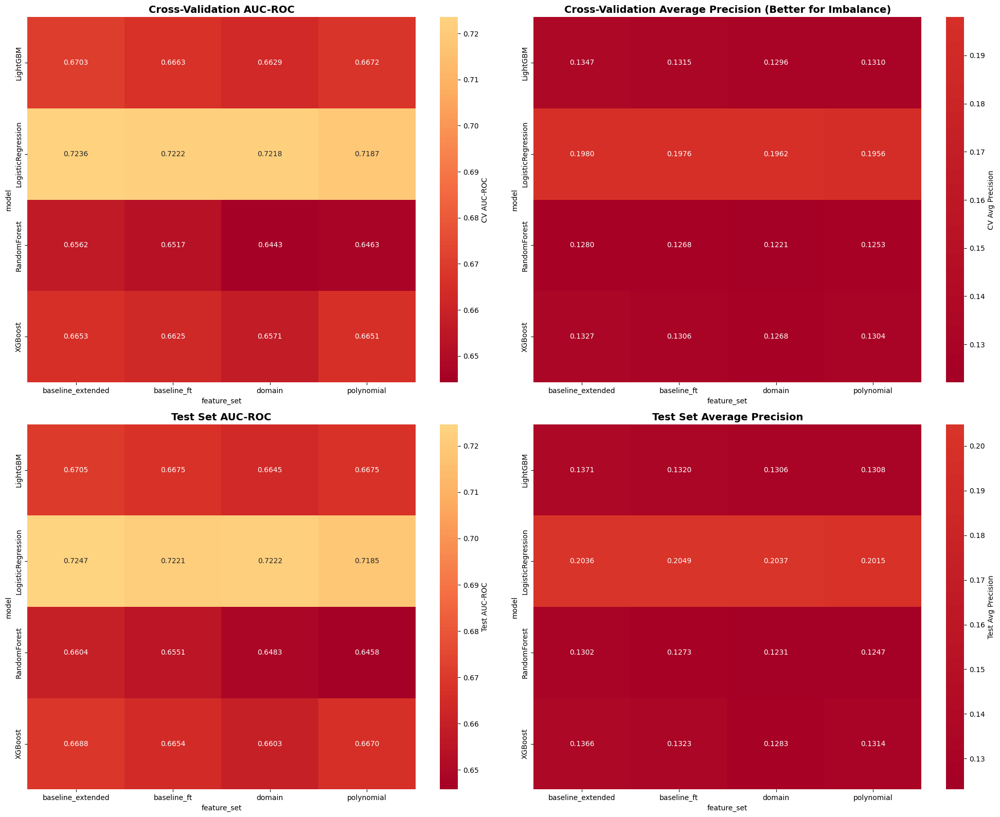


✅ All visualizations saved and logged to MLflow!
🎯 Resampling strategy used: smote
🚀 Run 'mlflow ui' to explore results

💡 TIP: For imbalanced data, focus on Average Precision and Recall metrics!


In [44]:
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from lightgbm import LGBMClassifier
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split, StratifiedKFold, cross_validate
from sklearn.impute import SimpleImputer
from sklearn.metrics import (
    roc_auc_score, roc_curve, confusion_matrix, 
    classification_report, precision_score, recall_score, f1_score,
    average_precision_score, precision_recall_curve
)
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.combine import SMOTEENN
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import mlflow
import mlflow.sklearn

# ============== CONFIGURATION ==============
# Stratégie de gestion du déséquilibre (choisis une)
RESAMPLING_STRATEGY = 'smote'  # Options: None, 'smote', 'undersample', 'smoteenn', 'class_weight'

# Seuil de classification (tu peux l'ajuster selon le métier)
CLASSIFICATION_THRESHOLD = 0.5

# ============== VÉRIFICATION DU DÉSÉQUILIBRE ==============
print("="*70)
print("CLASS DISTRIBUTION CHECK")
print("="*70)
class_distribution = df_train['TARGET'].value_counts()
print(class_distribution)
print(f"\nClass imbalance ratio: {class_distribution[0] / class_distribution[1]:.2f}:1")
print(f"Minority class percentage: {(class_distribution[1] / len(df_train)) * 100:.2f}%")

# Définir les modèles AVEC gestion du déséquilibre
if RESAMPLING_STRATEGY == 'class_weight':
    models = {
        'LogisticRegression': LogisticRegression(
            max_iter=1000, random_state=42, class_weight='balanced'
        ),
        'RandomForest': RandomForestClassifier(
            n_estimators=100, random_state=42, class_weight='balanced'
        ),
        'LightGBM': LGBMClassifier(
            random_state=42, verbose=-1, class_weight='balanced'
        ),
        'XGBoost': XGBClassifier(
            random_state=42, eval_metric='logloss', 
            use_label_encoder=False, scale_pos_weight=class_distribution[0] / class_distribution[1]
        )
    }
else:
    models = {
        'LogisticRegression': LogisticRegression(max_iter=1000, random_state=42),
        'RandomForest': RandomForestClassifier(n_estimators=100, random_state=42),
        'LightGBM': LGBMClassifier(random_state=42, verbose=-1),
        'XGBoost': XGBClassifier(random_state=42, eval_metric='logloss', use_label_encoder=False)
    }

# Tester toutes les combinaisons
results = []

for feature_name, features in feature_sets.items():
    print(f"\n{'='*70}")
    print(f"Testing Feature Set: {feature_name}")
    print(f"{'='*70}")
    
    # Préparer les données
    X = df_train[features]
    y = df_train['TARGET']
    
    # Imputation si nécessaire
    imputer = None
    if X.isnull().any().any():
        print(f"⚠️  {feature_name}: Contains NaN, imputation applied")
        imputer = SimpleImputer(strategy='median')
        X = pd.DataFrame(imputer.fit_transform(X), columns=X.columns, index=X.index)
    
    # Split train/test STRATIFIÉ (pour évaluation finale)
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=0.2, random_state=42, stratify=y
    )
    
    print(f"\nTrain class distribution: {y_train.value_counts().to_dict()}")
    print(f"Test class distribution: {y_test.value_counts().to_dict()}")
    
    # Configuration de la validation croisée stratifiée
    cv_strategy = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    
    for model_name, model in models.items():
        print(f"\n  → Training {model_name}...")
        
        with mlflow.start_run(run_name=f"{model_name}_{feature_name}_{RESAMPLING_STRATEGY}"):
            # ============== LOG PARAMS ==============
            mlflow.log_param("feature_set", feature_name)
            mlflow.log_param("n_features", len(features))
            mlflow.log_param("model", model_name)
            mlflow.log_param("test_size", 0.2)
            mlflow.log_param("cv_folds", 5)
            mlflow.log_param("resampling_strategy", RESAMPLING_STRATEGY or "none")
            mlflow.log_param("classification_threshold", CLASSIFICATION_THRESHOLD)
            mlflow.log_param("class_imbalance_ratio", f"{class_distribution[0] / class_distribution[1]:.2f}")
            
            # ============== CROSS-VALIDATION ==============
            print(f"     → Running 5-fold stratified cross-validation...")
            
            # Fonction pour appliquer le resampling dans chaque fold
            def get_resampled_data(X_fold, y_fold, strategy):
                if strategy == 'smote':
                    sampler = SMOTE(random_state=42)
                    return sampler.fit_resample(X_fold, y_fold)
                elif strategy == 'undersample':
                    sampler = RandomUnderSampler(random_state=42)
                    return sampler.fit_resample(X_fold, y_fold)
                elif strategy == 'smoteenn':
                    sampler = SMOTEENN(random_state=42)
                    return sampler.fit_resample(X_fold, y_fold)
                else:
                    return X_fold, y_fold
            
            # CV avec resampling dans chaque fold
            cv_auc_scores = []
            cv_ap_scores = []
            cv_recall_scores = []
            cv_precision_scores = []
            
            for fold_idx, (train_idx, val_idx) in enumerate(cv_strategy.split(X_train, y_train), 1):
                X_fold_train, X_fold_val = X_train.iloc[train_idx], X_train.iloc[val_idx]
                y_fold_train, y_fold_val = y_train.iloc[train_idx], y_train.iloc[val_idx]
                
                # Appliquer resampling sur ce fold uniquement
                X_fold_resampled, y_fold_resampled = get_resampled_data(
                    X_fold_train, y_fold_train, RESAMPLING_STRATEGY
                )
                
                # Entraîner et évaluer
                model_cv = model.__class__(**model.get_params())  # Clone du modèle
                model_cv.fit(X_fold_resampled, y_fold_resampled)
                
                y_pred_proba_cv = model_cv.predict_proba(X_fold_val)[:, 1]
                y_pred_cv = (y_pred_proba_cv >= CLASSIFICATION_THRESHOLD).astype(int)
                
                cv_auc_scores.append(roc_auc_score(y_fold_val, y_pred_proba_cv))
                cv_ap_scores.append(average_precision_score(y_fold_val, y_pred_proba_cv))
                cv_recall_scores.append(recall_score(y_fold_val, y_pred_cv, zero_division=0))
                cv_precision_scores.append(precision_score(y_fold_val, y_pred_cv, zero_division=0))
            
            # Moyennes CV
            cv_auc_mean = np.mean(cv_auc_scores)
            cv_auc_std = np.std(cv_auc_scores)
            cv_ap_mean = np.mean(cv_ap_scores)
            cv_ap_std = np.std(cv_ap_scores)
            cv_recall_mean = np.mean(cv_recall_scores)
            cv_precision_mean = np.mean(cv_precision_scores)
            
            mlflow.log_metric("cv_auc_mean", cv_auc_mean)
            mlflow.log_metric("cv_auc_std", cv_auc_std)
            mlflow.log_metric("cv_avg_precision_mean", cv_ap_mean)
            mlflow.log_metric("cv_avg_precision_std", cv_ap_std)
            mlflow.log_metric("cv_recall_mean", cv_recall_mean)
            mlflow.log_metric("cv_precision_mean", cv_precision_mean)
            
            print(f"     CV Results: AUC={cv_auc_mean:.4f}±{cv_auc_std:.4f} | AP={cv_ap_mean:.4f}±{cv_ap_std:.4f}")
            
            # ============== TRAINING SUR TOUT LE TRAIN SET ==============
            # Appliquer le resampling sur tout le train set pour le modèle final
            X_train_resampled, y_train_resampled = get_resampled_data(
                X_train, y_train, RESAMPLING_STRATEGY
            )
            if RESAMPLING_STRATEGY:
                print(f"     → Final training with {RESAMPLING_STRATEGY}: {pd.Series(y_train_resampled).value_counts().to_dict()}")
            
            # Entraînement final
            model.fit(X_train_resampled, y_train_resampled)
            
            # ============== PREDICTIONS SUR TEST SET ==============
            y_pred_proba = model.predict_proba(X_test)[:, 1]
            y_pred = (y_pred_proba >= CLASSIFICATION_THRESHOLD).astype(int)
            
            # ============== METRICS SUR TEST SET ==============
            test_auc = roc_auc_score(y_test, y_pred_proba)
            test_precision = precision_score(y_test, y_pred, zero_division=0)
            test_recall = recall_score(y_test, y_pred, zero_division=0)
            test_f1 = f1_score(y_test, y_pred, zero_division=0)
            test_avg_precision = average_precision_score(y_test, y_pred_proba)
            
            # Métriques par classe
            tn, fp, fn, tp = confusion_matrix(y_test, y_pred).ravel()
            test_specificity = tn / (tn + fp) if (tn + fp) > 0 else 0
            
            mlflow.log_metric("test_auc_roc", test_auc)
            mlflow.log_metric("test_avg_precision", test_avg_precision)
            mlflow.log_metric("test_precision", test_precision)
            mlflow.log_metric("test_recall", test_recall)
            mlflow.log_metric("test_f1_score", test_f1)
            mlflow.log_metric("test_specificity", test_specificity)
            mlflow.log_metric("test_true_positives", tp)
            mlflow.log_metric("test_false_positives", fp)
            mlflow.log_metric("test_true_negatives", tn)
            mlflow.log_metric("test_false_negatives", fn)
            
            print(f"     Test Results: AUC={test_auc:.4f} | AP={test_avg_precision:.4f}")
            print(f"     Precision: {test_precision:.4f} | Recall: {test_recall:.4f} | F1: {test_f1:.4f}")
            print(f"     Specificity: {test_specificity:.4f}")
            
            # ============== ROC CURVE ==============
            fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)
            
            fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))
            
            # ROC Curve
            ax1.plot(fpr, tpr, label=f'Test ROC (AUC = {test_auc:.4f})', linewidth=2, color='blue')
            ax1.plot([0, 1], [0, 1], 'k--', label='Random classifier')
            ax1.set_xlim([0.0, 1.0])
            ax1.set_ylim([0.0, 1.05])
            ax1.set_xlabel('False Positive Rate', fontsize=12)
            ax1.set_ylabel('True Positive Rate', fontsize=12)
            ax1.set_title(f'ROC Curve (CV AUC: {cv_auc_mean:.4f}±{cv_auc_std:.4f})', fontsize=14, fontweight='bold')
            ax1.legend(loc="lower right")
            ax1.grid(alpha=0.3)
            
            # Precision-Recall Curve (MEILLEUR pour déséquilibre)
            precision_curve, recall_curve, _ = precision_recall_curve(y_test, y_pred_proba)
            ax2.plot(recall_curve, precision_curve, label=f'Test PR (AP = {test_avg_precision:.4f})', 
                    linewidth=2, color='green')
            ax2.axhline(y=y_test.sum()/len(y_test), color='k', linestyle='--', 
                       label=f'Baseline ({y_test.sum()/len(y_test):.3f})')
            ax2.set_xlim([0.0, 1.0])
            ax2.set_ylim([0.0, 1.05])
            ax2.set_xlabel('Recall', fontsize=12)
            ax2.set_ylabel('Precision', fontsize=12)
            ax2.set_title(f'Precision-Recall Curve (CV AP: {cv_ap_mean:.4f}±{cv_ap_std:.4f})', fontsize=14, fontweight='bold')
            ax2.legend(loc="lower left")
            ax2.grid(alpha=0.3)
            
            plt.suptitle(f'{model_name} - {feature_name}', fontsize=16, fontweight='bold')
            plt.tight_layout()
            
            curves_filename = f"curves_{model_name}_{feature_name}.png"
            plt.savefig(curves_filename, dpi=150)
            mlflow.log_artifact(curves_filename)
            plt.close()
            
            # ============== CONFUSION MATRIX ==============
            cm = confusion_matrix(y_test, y_pred)
            
            # Normaliser pour mieux voir le déséquilibre
            cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
            
            fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))
            
            # Matrice brute
            sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=True, ax=ax1,
                       xticklabels=['No Default (0)', 'Default (1)'],
                       yticklabels=['No Default (0)', 'Default (1)'])
            ax1.set_title('Confusion Matrix (Counts)', fontsize=14, fontweight='bold')
            ax1.set_ylabel('True Label', fontsize=12)
            ax1.set_xlabel('Predicted Label', fontsize=12)
            
            # Matrice normalisée
            sns.heatmap(cm_normalized, annot=True, fmt='.2%', cmap='Blues', cbar=True, ax=ax2,
                       xticklabels=['No Default (0)', 'Default (1)'],
                       yticklabels=['No Default (0)', 'Default (1)'])
            ax2.set_title('Confusion Matrix (Normalized)', fontsize=14, fontweight='bold')
            ax2.set_ylabel('True Label', fontsize=12)
            ax2.set_xlabel('Predicted Label', fontsize=12)
            
            plt.suptitle(f'{model_name} - {feature_name}', fontsize=16, fontweight='bold')
            plt.tight_layout()
            
            cm_filename = f"confusion_matrix_{model_name}_{feature_name}.png"
            plt.savefig(cm_filename, dpi=150)
            mlflow.log_artifact(cm_filename)
            plt.close()
            
            # ============== CLASSIFICATION REPORT ==============
            report = classification_report(y_test, y_pred, output_dict=True, zero_division=0)
            report_df = pd.DataFrame(report).transpose()
            
            report_filename = f"classification_report_{model_name}_{feature_name}.csv"
            report_df.to_csv(report_filename)
            mlflow.log_artifact(report_filename)
            
            # ============== THRESHOLD ANALYSIS ==============
            # Analyser différents seuils pour trouver le meilleur compromis
            thresholds_to_test = np.arange(0.1, 0.9, 0.05)
            threshold_results = []
            
            for thresh in thresholds_to_test:
                y_pred_thresh = (y_pred_proba >= thresh).astype(int)
                prec = precision_score(y_test, y_pred_thresh, zero_division=0)
                rec = recall_score(y_test, y_pred_thresh, zero_division=0)
                f1_thresh = f1_score(y_test, y_pred_thresh, zero_division=0)
                
                threshold_results.append({
                    'threshold': thresh,
                    'precision': prec,
                    'recall': rec,
                    'f1_score': f1_thresh
                })
            
            threshold_df = pd.DataFrame(threshold_results)
            
            plt.figure(figsize=(10, 6))
            plt.plot(threshold_df['threshold'], threshold_df['precision'], label='Precision', marker='o')
            plt.plot(threshold_df['threshold'], threshold_df['recall'], label='Recall', marker='s')
            plt.plot(threshold_df['threshold'], threshold_df['f1_score'], label='F1-Score', marker='^')
            plt.axvline(x=CLASSIFICATION_THRESHOLD, color='red', linestyle='--', 
                       label=f'Current threshold ({CLASSIFICATION_THRESHOLD})')
            plt.xlabel('Classification Threshold', fontsize=12)
            plt.ylabel('Score', fontsize=12)
            plt.title(f'Metrics vs Threshold: {model_name} - {feature_name}', 
                     fontsize=14, fontweight='bold')
            plt.legend()
            plt.grid(alpha=0.3)
            plt.tight_layout()
            
            threshold_filename = f"threshold_analysis_{model_name}_{feature_name}.png"
            plt.savefig(threshold_filename, dpi=150)
            mlflow.log_artifact(threshold_filename)
            plt.close()
            
            threshold_csv = f"threshold_analysis_{model_name}_{feature_name}.csv"
            threshold_df.to_csv(threshold_csv, index=False)
            mlflow.log_artifact(threshold_csv)
            
            # ============== FEATURE IMPORTANCE ==============
            if hasattr(model, 'feature_importances_'):
                importances = model.feature_importances_
                feature_importance_df = pd.DataFrame({
                    'feature': X_train.columns,
                    'importance': importances
                }).sort_values('importance', ascending=False)
                
                top_n = min(20, len(feature_importance_df))
                
                plt.figure(figsize=(10, 8))
                sns.barplot(
                    data=feature_importance_df.head(top_n),
                    x='importance',
                    y='feature',
                    palette='viridis'
                )
                plt.title(f'Top {top_n} Feature Importance: {model_name} - {feature_name}',
                         fontsize=14, fontweight='bold')
                plt.xlabel('Importance', fontsize=12)
                plt.ylabel('Feature', fontsize=12)
                plt.tight_layout()
                
                fi_filename = f"feature_importance_{model_name}_{feature_name}.png"
                plt.savefig(fi_filename, dpi=150)
                mlflow.log_artifact(fi_filename)
                plt.close()
                
                fi_csv = f"feature_importance_{model_name}_{feature_name}.csv"
                feature_importance_df.to_csv(fi_csv, index=False)
                mlflow.log_artifact(fi_csv)
                
            elif hasattr(model, 'coef_'):
                coefficients = model.coef_[0]
                feature_coef_df = pd.DataFrame({
                    'feature': X_train.columns,
                    'coefficient': coefficients,
                    'abs_coefficient': np.abs(coefficients)
                }).sort_values('abs_coefficient', ascending=False)
                
                top_n = min(20, len(feature_coef_df))
                
                plt.figure(figsize=(10, 8))
                colors = ['red' if x < 0 else 'green' for x in feature_coef_df.head(top_n)['coefficient']]
                sns.barplot(
                    data=feature_coef_df.head(top_n),
                    x='coefficient',
                    y='feature',
                    palette=colors
                )
                plt.title(f'Top {top_n} Coefficients: {model_name} - {feature_name}',
                         fontsize=14, fontweight='bold')
                plt.xlabel('Coefficient', fontsize=12)
                plt.ylabel('Feature', fontsize=12)
                plt.axvline(x=0, color='black', linestyle='--', linewidth=0.8)
                plt.tight_layout()
                
                coef_filename = f"feature_coefficients_{model_name}_{feature_name}.png"
                plt.savefig(coef_filename, dpi=150)
                mlflow.log_artifact(coef_filename)
                plt.close()
                
                coef_csv = f"feature_coefficients_{model_name}_{feature_name}.csv"
                feature_coef_df.to_csv(coef_csv, index=False)
                mlflow.log_artifact(coef_csv)
            
            # ============== LOG MODEL ==============
            mlflow.sklearn.log_model(model, "model")
            
            # ============== SAVE TO RESULTS ==============
            results.append({
                'feature_set': feature_name,
                'model': model_name,
                'resampling': RESAMPLING_STRATEGY or 'none',
                'cv_auc_mean': cv_auc_mean,
                'cv_auc_std': cv_auc_std,
                'cv_avg_precision': cv_ap_mean,
                'test_auc_roc': test_auc,
                'test_avg_precision': test_avg_precision,
                'test_precision': test_precision,
                'test_recall': test_recall,
                'test_f1_score': test_f1,
                'test_specificity': test_specificity,
                'n_features': len(features)
            })

# ============== SUMMARY ==============
print("\n" + "="*70)
print("SUMMARY: ALL EXPERIMENTS")
print("="*70)

results_df = pd.DataFrame(results).sort_values('cv_avg_precision', ascending=False)
print(results_df.to_string(index=False))

results_df.to_csv('mlflow_experiments_summary.csv', index=False)
print("\n✅ Summary saved to 'mlflow_experiments_summary.csv'")

# ============== COMPARISON HEATMAPS ==============
fig, axes = plt.subplots(2, 2, figsize=(20, 16))

# CV AUC-ROC
pivot_cv_auc = results_df.pivot_table(values='cv_auc_mean', index='model', columns='feature_set')
sns.heatmap(pivot_cv_auc, annot=True, fmt='.4f', cmap='RdYlGn', center=0.75, 
           cbar_kws={'label': 'CV AUC-ROC'}, ax=axes[0,0])
axes[0,0].set_title('Cross-Validation AUC-ROC', fontsize=14, fontweight='bold')

# CV Average Precision
pivot_cv_ap = results_df.pivot_table(values='cv_avg_precision', index='model', columns='feature_set')
sns.heatmap(pivot_cv_ap, annot=True, fmt='.4f', cmap='RdYlGn', center=0.5,
           cbar_kws={'label': 'CV Avg Precision'}, ax=axes[0,1])
axes[0,1].set_title('Cross-Validation Average Precision (Better for Imbalance)', fontsize=14, fontweight='bold')

# Test AUC-ROC
pivot_test_auc = results_df.pivot_table(values='test_auc_roc', index='model', columns='feature_set')
sns.heatmap(pivot_test_auc, annot=True, fmt='.4f', cmap='RdYlGn', center=0.75,
           cbar_kws={'label': 'Test AUC-ROC'}, ax=axes[1,0])
axes[1,0].set_title('Test Set AUC-ROC', fontsize=14, fontweight='bold')

# Test Average Precision
pivot_test_ap = results_df.pivot_table(values='test_avg_precision', index='model', columns='feature_set')
sns.heatmap(pivot_test_ap, annot=True, fmt='.4f', cmap='RdYlGn', center=0.5,
           cbar_kws={'label': 'Test Avg Precision'}, ax=axes[1,1])
axes[1,1].set_title('Test Set Average Precision', fontsize=14, fontweight='bold')

plt.tight_layout()
plt.savefig('comparison_heatmap.png', dpi=150)
plt.show()

print("\n✅ All visualizations saved and logged to MLflow!")
print(f"🎯 Resampling strategy used: {RESAMPLING_STRATEGY or 'none'}")
print("🚀 Run 'mlflow ui' to explore results")
print("\n💡 TIP: For imbalanced data, focus on Average Precision and Recall metrics!")

## Importance des features

In [57]:
import mlflow
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# ============== CONFIGURATION ==============
# Option 1: Par run_id (trouve-le dans MLflow UI)
RUN_ID = "542ca56cdec94621b98582c6c6b53830"  # Baseline extended, logistic regression

# ============== RÉCUPÉRER PAR RUN_ID ==============
def get_feature_importance_by_run_id(run_id):
    """
    Récupère les feature importances depuis un run MLflow par son ID
    """
    # Charger le run
    run = mlflow.get_run(run_id)
    
    print(f"Run: {run.info.run_name or run.info.run_id}")
    print(f"Status: {run.info.status}")
    print(f"Experiment ID: {run.info.experiment_id}")
    
    # Télécharger les artifacts
    client = mlflow.tracking.MlflowClient()
    
    # Lister tous les artifacts
    artifacts = client.list_artifacts(run_id)
    print(f"\n📦 Artifacts disponibles:")
    for artifact in artifacts:
        print(f"  - {artifact.path}")
    
    # Chercher les fichiers d'importance des features
    importance_files = [a for a in artifacts if 'importance' in a.path.lower() or 'coefficient' in a.path.lower()]
    
    if not importance_files:
        print("\n❌ Aucun fichier d'importance trouvé")
        return None
    
    # Télécharger le CSV d'importance
    for artifact in importance_files:
        if artifact.path.endswith('.csv'):
            artifact_path = client.download_artifacts(run_id, artifact.path)
            print(f"\n✅ Importance trouvée: {artifact.path}")
            
            # Charger le CSV
            df = pd.read_csv(artifact_path)
            return df
    
    return None


# ============== VISUALISATION ==============
def plot_feature_importance(df, top_n=20, title="Feature Importance"):
    """
    Visualise les top N features
    """
    if df is None:
        print("❌ Pas de données à visualiser")
        return
    
    # Déterminer la colonne à utiliser
    if 'importance' in df.columns:
        value_col = 'importance'
    elif 'abs_coefficient' in df.columns:
        value_col = 'abs_coefficient'
    else:
        print("❌ Colonne d'importance non trouvée")
        return
    
    # Top N
    top_features = df.head(top_n)
    
    plt.figure(figsize=(10, 8))
    
    if 'coefficient' in df.columns:
        # Pour les coefficients (avec couleurs pour pos/neg)
        colors = ['red' if x < 0 else 'green' for x in top_features['coefficient']]
        sns.barplot(data=top_features, x='coefficient', y='feature', palette=colors)
        plt.axvline(x=0, color='black', linestyle='--', linewidth=0.8)
        plt.xlabel('Coefficient')
    else:
        # Pour les importances
        sns.barplot(data=top_features, x=value_col, y='feature', palette='viridis')
        plt.xlabel('Importance')
    
    plt.title(title, fontsize=14, fontweight='bold')
    plt.ylabel('Feature')
    plt.tight_layout()
    plt.show()


In [54]:
importance_df = get_feature_importance_by_name(
    run_name="LogisticRegression_baseline_ft_smote",
    experiment_name="test_features"
)

✅ Run trouvé: da8cf9a8b6184188b29e51431756ef7d
Run: LogisticRegression_baseline_ft_smote
Status: FINISHED
Experiment ID: 458359065163754263

📦 Artifacts disponibles:
  - classification_report_LogisticRegression_baseline_ft.csv
  - confusion_matrix_LogisticRegression_baseline_ft.png
  - curves_LogisticRegression_baseline_ft.png
  - feature_coefficients_LogisticRegression_baseline_ft.csv
  - feature_coefficients_LogisticRegression_baseline_ft.png
  - threshold_analysis_LogisticRegression_baseline_ft.csv
  - threshold_analysis_LogisticRegression_baseline_ft.png



✅ Importance trouvée: feature_coefficients_LogisticRegression_baseline_ft.csv


In [55]:
importance_df

,feature,coefficient,abs_coefficient
0,EXT_SOURCE_3,-3.785273,3.785273
1,EXT_SOURCE_2,-3.306157,3.306157
2,EXT_SOURCE_1,-1.924911,1.924911
3,DAYS_EMPLOYED_PERCENT,-1.659197,1.659197
4,EXT_SOURCE_3 EXT_SOURCE_2,1.343911,1.343911
5,DAYS_BIRTH,0.000010,0.000010


C:\Users\HDGW0570\AppData\Local\Temp\1\ipykernel_7784\790746169.py:171: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=top_features, x='coefficient', y='feature', palette=colors)


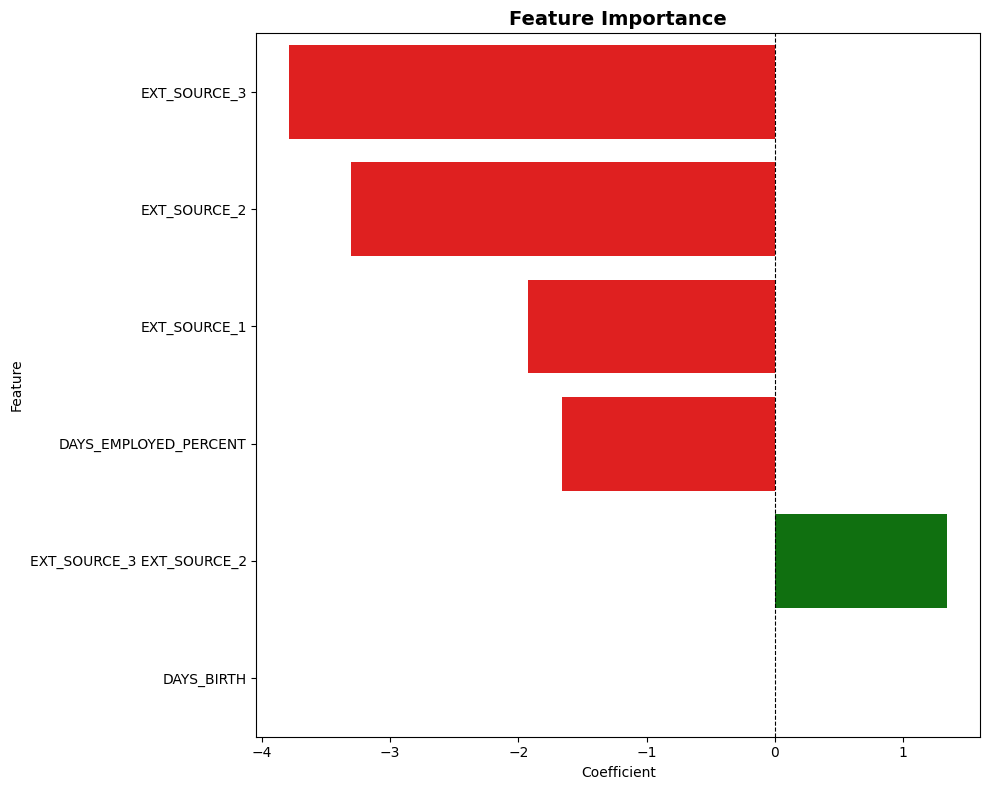

In [56]:
plot_feature_importance(importance_df, top_n=20, title="Feature Importance")

## Calcul du cout métier

In [63]:
import mlflow
print("PYTHON MLflow URI:", mlflow.get_tracking_uri())


PYTHON MLflow URI: file:///C:/Users/HDGW0570/OneDrive - orange.com/Documents/Python_notebooks/OpenClassrooms/Projet_7/mlruns


In [65]:
import math
import mlflow
import pandas as pd
from pathlib import Path

# === Paramètres métier ===
COST_FN = 10000
COST_FP = 500

# === Tracking MLflow ===
tracking_dir = Path(r"C:\Users\HDGW0570\OneDrive - orange.com\Documents\Python_notebooks\OpenClassrooms\Projet_7\mlruns")

# ✅ Encode seulement les espaces, PAS le C:
tracking_uri = "file:///" + tracking_dir.as_posix().replace(" ", "%20")

mlflow.set_tracking_uri(tracking_uri)
print("🔗 Tracking URI (Python) =", mlflow.get_tracking_uri())

mlflow.autolog(disable=True)

EXPERIMENT_NAME = "test_features"

# ✅ charge l’experiment à partir du store
exp = mlflow.get_experiment_by_name(EXPERIMENT_NAME)
if exp is None:
    raise RuntimeError(f"❌ Experiment '{EXPERIMENT_NAME}' introuvable")
print(f"✅ Experiment trouvé : {exp.experiment_id}")

# ✅ Récupère les runs
runs_df = mlflow.search_runs(experiment_ids=[exp.experiment_id])
runs_df = runs_df.dropna(subset=["metrics.test_false_positives", "metrics.test_false_negatives"])
print(f"🔎 Runs avec FP/FN trouvés : {len(runs_df)}")

rows = []

for _, run in runs_df.iterrows():

    run_id = run["run_id"]

    fp = int(run["metrics.test_false_positives"])
    fn = int(run["metrics.test_false_negatives"])
    tp = int(run.get("metrics.test_true_positives", 0))
    tn = int(run.get("metrics.test_true_negatives", 0))

    total_cost = fp * COST_FP + fn * COST_FN
    n_test = fp + fn + tp + tn
    avg_cost = total_cost / n_test if n_test > 0 else float("nan")

    print(f"➡️ MAJ Run {run_id} | FP={fp} FN={fn} COST={total_cost}")

    # ✅ mise à jour du run existant
    mlflow.start_run(run_id=run_id, experiment_id=exp.experiment_id)
    mlflow.log_metric("test_business_cost_total", total_cost)
    mlflow.log_metric("test_business_cost_avg", avg_cost)
    mlflow.end_run()

    rows.append({
        "run_id": run_id,
        "total_cost": total_cost,
        "avg_cost": avg_cost
    })

summary_df = pd.DataFrame(rows).sort_values(["total_cost", "avg_cost"])
summary_df.to_csv("business_cost_summary.csv", index=False)

print("\n✅ business_cost_summary.csv écrit.")
print(summary_df.head(10))


✅ Tracking URI utilisé par Python = file:///C:/Users/HDGW0570/OneDrive%20-%20orange.com/Documents/Python_notebooks/OpenClassrooms/Projet_7/mlruns
✅ Tracking URI utilisé par Python = file:///C:/Users/HDGW0570/OneDrive%20-%20orange.com/Documents/Python_notebooks/OpenClassrooms/Projet_7/mlruns
✅ Experiment trouvé : 458359065163754263
🔎 Runs avec FP / FN trouvés : 20
➡️ MAJ Run 895a311ebcf54c1e82b109edd09abcdd | FP=13596 FN=2734 COST=34138000
➡️ MAJ Run 4ac66e9943e84691b9630f9192a5788b | FP=14054 FN=2705 COST=34077000
➡️ MAJ Run 4529deace98b415bbe53a031ac9b70db | FP=11209 FN=3125 COST=36854500
➡️ MAJ Run da8cf9a8b6184188b29e51431756ef7d | FP=17550 FN=1797 COST=26745000
➡️ MAJ Run 384453b1f5bc43f1a915b01daff63747 | FP=15292 FN=2616 COST=33806000
➡️ MAJ Run cf7cfbc6e2ee4ead9508a4e1cff30f3e | FP=15411 FN=2573 COST=33435500
➡️ MAJ Run 8ed12bd8c96d4cbea96a701462e1202f | FP=13446 FN=2891 COST=35633000
➡️ MAJ Run eefe077081804e29bdf3852dc8a510e2 | FP=18022 FN=1760 COST=26611000
➡️ MAJ Run b402fbd

# Optimisation des hyperparamètres (test)

In [77]:
from imblearn.pipeline import Pipeline      # ✅ obligatoire pour SMOTE
from imblearn.over_sampling import SMOTE
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.model_selection import GridSearchCV, StratifiedKFold, train_test_split
from sklearn.metrics import roc_auc_score, average_precision_score
import mlflow
import mlflow.sklearn
import pandas as pd
import numpy as np

# =========================================
# 1) DATASET
# =========================================
X = df_train[features_baseline_extended]
y = df_train["TARGET"]

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

# =========================================
# 2) PIPELINE (IMPUTATION → SCALER → SMOTE → LOG REG)
# =========================================
pipeline = Pipeline([
    ("imputer", SimpleImputer(strategy="median")),  # ✅ gère les NaN
    ("scaler", StandardScaler()),
    ("smote", SMOTE(random_state=42)),
    ("model", LogisticRegression(max_iter=500, solver="liblinear"))
])

# =========================================
# 3) HYPERPARAM GRID
# =========================================
param_grid = {
    "model__C": [0.01, 0.1, 1, 10],
    "model__penalty": ["l1", "l2"],
    "model__class_weight": [None, "balanced"],   # ✅ gestion du déséquilibre aussi côté modèle
}

cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

grid = GridSearchCV(
    pipeline,
    param_grid,
    cv=cv,
    scoring="average_precision",  # ✅ meilleur scoring pour classes déséquilibrées
    n_jobs=-1
)

# =========================================
# 4) MLflow Tracking
# =========================================

mlflow.set_experiment("baseline_extended_logreg_gridsearch_v2")

with mlflow.start_run(run_name="LogReg_SMOTE_gridsearch"):

    mlflow.log_param("feature_set", "baseline_extended")
    mlflow.log_param("smote", True)

    grid.fit(X_train, y_train)

    mlflow.log_params(grid.best_params_)

    # Predictions
    y_pred_proba = grid.predict_proba(X_test)[:, 1]

    mlflow.log_metric("average_precision", average_precision_score(y_test, y_pred_proba))
    mlflow.log_metric("auc_roc", roc_auc_score(y_test, y_pred_proba))

    mlflow.sklearn.log_model(grid.best_estimator_, "best_model")

print("✅ GridSearch + SMOTE + MLflow terminé")


2025/11/07 02:41:38 WARNING mlflow.models.model: `artifact_path` is deprecated. Please use `name` instead.
2025/11/07 02:41:48 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


✅ GridSearch + SMOTE + MLflow terminé


“Le modèle obtient un AUC-ROC de 0.73, indiquant une bonne capacité de discrimination globale entre clients solvables et non solvables.
En revanche, l’Average Precision de 0.20 révèle une difficulté à prédire avec précision les défauts de paiement, ce qui est typique dans un contexte fortement déséquilibré. Pour un besoin métier orienté détection du risque, la métrique PR-AUC est plus représentative que l’AUC-ROC.”

# Optimisation des hyperparamètres


## ✅ Explication du code : optimisation modèle + features + coût métier

### 🎯 Objectif du script

Optimiser automatiquement le **meilleur modèle de scoring** en testant :

* Plusieurs **ensembles de variables (feature sets)**
* Plusieurs **algorithmes de machine learning (Logistic Regression, LightGBM, XGBoost)**
* Différentes **stratégies de gestion du déséquilibre**
* Différents **hyperparamètres**

Et sélectionner le modèle qui **minimise le coût métier** (fausse acceptation vs. fausse détection).

---

### 🧠 Principes clés

| Élément                           | Description                                                                                  |
| --------------------------------- | -------------------------------------------------------------------------------------------- |
| **Optuna**                        | Moteur d’optimisation Bayesian pour trouver automatiquement les meilleurs hyperparamètres.   |
| **Business cost**                 | Fonction métier utilisée comme objectif de l’optimisation : `cost = FN * 10 000 + FP * 500`. |
| **MLflow**                        | Suivi automatique des essais : paramètres, métriques, modèle sauvegardé.                     |
| **Validation croisée stratifiée** | Assure que chaque fold conserve le même ratio positif/négatif.                               |

---

### ✅ Étapes réalisées par le code

1. **Boucle sur tous les jeux de features**
   `baseline_extended`, `polynomial`, `domain`, `baseline_ft`
   → Chaque set de features est évalué séparément.

2. **Boucle sur les modèles à optimiser**
   → `LogisticRegression`, `LightGBM`, `XGBoost` (RandomForest exclu pour raisons de performance)

3. **Construction dynamique d'une pipeline modulaire (imblearn Pipeline)**

   * Imputation des valeurs manquantes (`SimpleImputer`)
   * Standardisation (`StandardScaler`) si utile au modèle
   * Gestion du déséquilibre : SMOTE ou mécanismes internes du modèle
   * Modèle entraîné avec des hyperparamètres proposés par Optuna

4. **Optimisation automatique avec Optuna**

   * Chaque modèle définit son espace d’hyperparamètres (C, penalty, learning rate, num_leaves, etc.)
   * Optuna propose des combinaisons successives, entraîne et évalue le modèle
   * Objectif à minimiser : **coût métier global sur la validation croisée**

5. **Optimisation du seuil de décision**

   * Pour chaque fold, le code teste plusieurs seuils (0.05 → 0.95)
   * Sélectionne celui qui **minimise le coût métier**
   * Seuil final = moyenne des meilleurs seuils trouvés en validation

6. **Évaluation finale sur un vrai jeu de test (hold-out)**

   * Calcul des métriques :

     * AUC ROC
     * Average Precision
     * Precision, Recall, F1-score
     * Specificity
     * FN, FP, TP, TN
     * **Business cost total et moyen**

7. **Tracking MLflow**

   * Sauvegarde :

     * hyperparamètres retenus
     * métriques CV et test
     * seuil optimal
     * modèle final (pickle + signature scikit)

8. **Export d’un tableau comparatif final**

   * Génération d’un fichier : `optuna_cost_optimization_summary.csv`
   * Compare tous les modèles selon **coût métier et performances prédictives**

---

### 🏆 Résultat final

Ce code permet de :

✅ Identifier automatiquement le meilleur couple **(features + modèle + seuil)**
✅ Réduire le **coût métier** au lieu d’optimiser un score technique uniquement
✅ Sauvegarder toutes les expériences dans **MLflow** pour justification lors de la soutenance

---


In [42]:
# ========== MLflow ==========
import mlflow
from pathlib import Path

tracking_uri = "file:///C:/Users/HDGW0570/OneDrive%20-%20orange.com/Documents/Python_notebooks/OpenClassrooms/Projet_7/mlruns"
mlflow.set_tracking_uri(tracking_uri)

print("✅ Using tracking:", mlflow.get_tracking_uri())

EXPERIMENT_NAME = "v2_optuna_all_models_by_features_cost_optimization"
mlflow.set_experiment(EXPERIMENT_NAME)

✅ Using tracking: file:///C:/Users/HDGW0570/OneDrive%20-%20orange.com/Documents/Python_notebooks/OpenClassrooms/Projet_7/mlruns


<Experiment: artifact_location='file:///C:/Users/HDGW0570/OneDrive%20-%20orange.com/Documents/Python_notebooks/OpenClassrooms/Projet_7/mlruns/716473014140503815', creation_time=1762517935282, experiment_id='716473014140503815', last_update_time=1762517935282, lifecycle_stage='active', name='v2_optuna_all_models_by_features_cost_optimization', tags={}>

In [43]:
# =========================
# OPTUNA + MLflow — optimisation sur business_cost_total
# =========================
import numpy as np
import pandas as pd
import mlflow
import mlflow.sklearn
import optuna
import warnings

from pathlib import Path
from imblearn.pipeline import Pipeline
from imblearn.over_sampling import SMOTE

from sklearn.linear_model import LogisticRegression
from lightgbm import LGBMClassifier
from xgboost import XGBClassifier

from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.metrics import (
    roc_auc_score, average_precision_score, precision_score, recall_score,
    f1_score, confusion_matrix
)

warnings.filterwarnings("ignore")

# ========== PARAMETRES METIER ==========
COST_FN = 10000
COST_FP = 500

# ========== FEATURE SETS ==========
# feature_sets = {
#     'baseline_extended': features_baseline_extended,
#     'polynomial': features_poly,
#     'domain': features_domain,
#     'baseline_ft': features_baseline_ft
# }

assert 'feature_sets' in globals(), "⚠️ 'feature_sets' non défini dans l'environnement courant."

# ========== DONNÉES ==========
assert 'df_train' in globals(), "⚠️ 'df_train' non défini dans l'environnement courant."
assert 'TARGET' in df_train.columns or 'TARGET' in df_train, "⚠️ Colonne TARGET absente de df_train."
TARGET_COL = "TARGET"

# ========== OUTILS ==========
def compute_confusion_and_cost(y_true, y_proba, threshold, cost_fn=COST_FN, cost_fp=COST_FP):
    y_pred = (y_proba >= threshold).astype(int)
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
    total_cost = fn * cost_fn + fp * cost_fp
    return (tn, fp, fn, tp), total_cost

def search_best_threshold_for_cost(y_true, y_proba, cost_fn=COST_FN, cost_fp=COST_FP, grid=None):
    """
    Cherche le seuil qui minimise le coût métier sur un vecteur proba/true (p.ex. fold de validation)
    """
    if grid is None:
        grid = np.linspace(0.05, 0.95, 19)  # 0.05, 0.10, ..., 0.95
    best_thresh, best_cost = None, np.inf
    for t in grid:
        _, cost = compute_confusion_and_cost(y_true, y_proba, t, cost_fn, cost_fp)
        if cost < best_cost:
            best_cost = cost
            best_thresh = t
    return best_thresh, best_cost

def build_pipeline(model_name, trial):
    """
    Construit une pipeline imblearn en fonction du modèle et des hyperparamètres Optuna.
    On garde Imputation + (éventuel) StandardScaler + (optionnel) SMOTE + Model
    """
    steps = []
    steps.append(("imputer", SimpleImputer(strategy="median")))

    # StandardScaler : utile pour la LR ; inoffensif pour GBDT, mais on peut le désactiver via un hyperparam
    use_scaler = True if model_name == "LogisticRegression" else trial.suggest_categorical("use_scaler", [False, True])
    if use_scaler:
        steps.append(("scaler", StandardScaler()))

    use_smote = trial.suggest_categorical("use_smote", [True, False])
    if use_smote:
        smote_k = trial.suggest_int("smote_k_neighbors", 3, 10)
        sampling_strategy = trial.suggest_float("smote_sampling_strategy", 0.3, 1.0)
        steps.append(("smote", SMOTE(random_state=42, k_neighbors=smote_k, sampling_strategy=sampling_strategy)))

    if model_name == "LogisticRegression":
        # On passe sur solver saga pour elasticnet (supporte l1/l2/elasticnet)
        penalty = trial.suggest_categorical("penalty", ["l1", "l2", "elasticnet"])
        C = trial.suggest_float("C", 1e-4, 1e4, log=True)
        class_weight = trial.suggest_categorical("class_weight", [None, "balanced"])
        if penalty == "elasticnet":
            l1_ratio = trial.suggest_float("l1_ratio", 0.0, 1.0)
        else:
            l1_ratio = None
        model = LogisticRegression(
            solver="saga", penalty=penalty, C=C, l1_ratio=l1_ratio,
            class_weight=class_weight, max_iter=2000, random_state=42, n_jobs=-1
        )

    elif model_name == "LightGBM":
        # is_unbalance ou scale_pos_weight se gèrent dans LGBM ; on laisse SMOTE optionnel
        params = {
            "n_estimators": trial.suggest_int("lgbm_n_estimators", 200, 1200),
            "learning_rate": trial.suggest_float("lgbm_lr", 1e-3, 0.2, log=True),
            "num_leaves": trial.suggest_int("lgbm_num_leaves", 16, 256),
            "max_depth": trial.suggest_int("lgbm_max_depth", -1, 16),
            "min_child_samples": trial.suggest_int("lgbm_min_child_samples", 5, 200),
            "subsample": trial.suggest_float("lgbm_subsample", 0.6, 1.0),
            "colsample_bytree": trial.suggest_float("lgbm_colsample", 0.6, 1.0),
            "reg_alpha": trial.suggest_float("lgbm_reg_alpha", 1e-8, 10.0, log=True),
            "reg_lambda": trial.suggest_float("lgbm_reg_lambda", 1e-8, 10.0, log=True),
            "random_state": 42,
            "n_jobs": -1
        }
        # Gestion déséquilibre interne
        is_unbalance = trial.suggest_categorical("lgbm_is_unbalance", [True, False])
        params["is_unbalance"] = is_unbalance
        model = LGBMClassifier(**params)

    elif model_name == "XGBoost":
        # idem : scale_pos_weight interne ; SMOTE optionnel
        params = {
            "n_estimators": trial.suggest_int("xgb_n_estimators", 200, 1200),
            "learning_rate": trial.suggest_float("xgb_lr", 1e-3, 0.3, log=True),
            "max_depth": trial.suggest_int("xgb_max_depth", 3, 12),
            "min_child_weight": trial.suggest_float("xgb_min_child_weight", 1e-2, 20.0, log=True),
            "subsample": trial.suggest_float("xgb_subsample", 0.5, 1.0),
            "colsample_bytree": trial.suggest_float("xgb_colsample_bytree", 0.5, 1.0),
            "gamma": trial.suggest_float("xgb_gamma", 1e-8, 10.0, log=True),
            "reg_alpha": trial.suggest_float("xgb_reg_alpha", 1e-8, 10.0, log=True),
            "reg_lambda": trial.suggest_float("xgb_reg_lambda", 1e-8, 10.0, log=True),
            "eval_metric": "logloss",
            "random_state": 42,
            "n_jobs": -1,
            "tree_method": "auto"
        }
        # scale_pos_weight ~ ratio négatifs/positifs sur le fold ; on laisse Optuna grossièrement l'ajuster
        params["scale_pos_weight"] = trial.suggest_float("xgb_scale_pos_weight", 0.5, 20.0, log=True)
        model = XGBClassifier(**params)

    else:
        raise ValueError(f"Modèle non supporté: {model_name}")

    steps.append(("model", model))
    return Pipeline(steps)

def cross_val_business_cost(trial, X, y, model_name, n_splits=5, random_state=42):
    """
    CV stratifiée : entraîne dans chaque fold, choisit le seuil optimal pour le coût
    et cumule le coût total sur les folds (objectif à minimiser).
    Retourne aussi des métriques pour logging intermédiaire.
    """
    cv = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=random_state)

    fold_costs = []
    fold_thresholds = []
    aucs, aps = [], []

    for train_idx, val_idx in cv.split(X, y):
        X_tr, X_val = X.iloc[train_idx], X.iloc[val_idx]
        y_tr, y_val = y.iloc[train_idx], y.iloc[val_idx]

        pipe = build_pipeline(model_name, trial)
        pipe.fit(X_tr, y_tr)

        y_val_proba = pipe.predict_proba(X_val)[:, 1]

        # métriques probabilistes (seuil-indépendantes)
        aucs.append(roc_auc_score(y_val, y_val_proba))
        aps.append(average_precision_score(y_val, y_val_proba))

        # seuil qui minimise le coût sur le fold de validation
        best_t, best_cost = search_best_threshold_for_cost(y_val, y_val_proba, COST_FN, COST_FP)
        fold_costs.append(best_cost)
        fold_thresholds.append(best_t)

    cv_total_cost = float(np.sum(fold_costs))
    cv_auc_mean, cv_auc_std = float(np.mean(aucs)), float(np.std(aucs))
    cv_ap_mean, cv_ap_std = float(np.mean(aps)), float(np.std(aps))
    cv_best_threshold = float(np.mean(fold_thresholds))  # agrégation simple

    return {
        "cv_total_cost": cv_total_cost,
        "cv_auc_mean": cv_auc_mean,
        "cv_auc_std": cv_auc_std,
        "cv_ap_mean": cv_ap_mean,
        "cv_ap_std": cv_ap_std,
        "cv_best_threshold": cv_best_threshold
    }

def objective_factory(X, y, model_name):
    """
    Crée une fonction objective Optuna spécialisée pour (X, y, model).
    """
    def objective(trial):
        metrics = cross_val_business_cost(trial, X, y, model_name=model_name, n_splits=5, random_state=42)
        # On logue quelques infos sur le trial
        trial.set_user_attr("cv_auc_mean", metrics["cv_auc_mean"])
        trial.set_user_attr("cv_ap_mean", metrics["cv_ap_mean"])
        trial.set_user_attr("cv_best_threshold", metrics["cv_best_threshold"])
        # Objectif = coût total CV (plus c'est petit, mieux c'est)
        return metrics["cv_total_cost"]
    return objective

# ========== BOUCLE PRINCIPALE ==========
models_to_run = ["LogisticRegression", "LightGBM", "XGBoost"]

global_results = []

for feat_name, features in feature_sets.items():
    # Préparer X, y
    X = df_train[features].copy()
    y = df_train[TARGET_COL].copy()

    # Split final pour reporting test (hold-out)
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=0.2, random_state=42, stratify=y
    )

    for model_name in models_to_run:
        run_name = f"Optuna_{model_name}_{feat_name}"
        with mlflow.start_run(run_name=run_name) as run:
            mlflow.log_param("feature_set", feat_name)
            mlflow.log_param("n_features", len(features))
            mlflow.log_param("model", model_name)
            mlflow.log_param("cost_fn", COST_FN)
            mlflow.log_param("cost_fp", COST_FP)
            mlflow.log_param("cv_folds", 5)
            mlflow.log_param("objective", "business_cost_total")

            # ======== OPTUNA STUDY ========
            study = optuna.create_study(direction="minimize", study_name=f"{model_name}_{feat_name}")
            objective = objective_factory(X_train, y_train, model_name)
            study.optimize(objective, n_trials=40, show_progress_bar=False)  # ajuste n_trials selon ressources

            best_trial = study.best_trial
            # Récup métriques CV du meilleur trial
            cv_auc_mean = best_trial.user_attrs.get("cv_auc_mean")
            cv_ap_mean = best_trial.user_attrs.get("cv_ap_mean")
            cv_best_threshold = best_trial.user_attrs.get("cv_best_threshold")
            cv_total_cost = study.best_value

            # Log params/métriques CV
            mlflow.log_metric("cv_auc_mean", cv_auc_mean)
            mlflow.log_metric("cv_avg_precision_mean", cv_ap_mean)
            # (optionnel) écarts-types si on veut les suivre :
            # -> on relance un calcul rapide avec les params gagnants pour std
            def replay_cv_std(best_params):
                class DummyTrial:
                    def __init__(self, params): self.params = params
                    def suggest_categorical(self, k, vals): return self.params[k]
                    def suggest_float(self, k, *args, **kwargs): return self.params[k]
                    def suggest_int(self, k, *args, **kwargs): return self.params[k]
                metrics = cross_val_business_cost(DummyTrial(best_params), X_train, y_train, model_name, n_splits=5, random_state=42)
                return metrics

            # récupérer un dict "params" simple du trial
            best_params = best_trial.params.copy()
            # rejoue pour avoir std
            cv_recomputed = replay_cv_std(best_params)
            mlflow.log_metric("cv_auc_std", cv_recomputed["cv_auc_std"])
            mlflow.log_metric("cv_avg_precision_std", cv_recomputed["cv_ap_std"])
            mlflow.log_metric("cv_business_cost_total", cv_total_cost)
            mlflow.log_metric("cv_best_threshold", cv_recomputed["cv_best_threshold"])

            # Log hyperparams gagnants
            mlflow.log_params(best_params)

            # ======== FIT FINAL SUR TRAIN + EVAL TEST ========
            # Reconstruit pipeline avec les meilleurs hyperparams
            class DummyTrialForBuild:
                def __init__(self, params): self.params = params
                def suggest_categorical(self, k, vals): return self.params[k]
                def suggest_float(self, k, *args, **kwargs): return self.params[k]
                def suggest_int(self, k, *args, **kwargs): return self.params[k]

            final_pipe = build_pipeline(model_name, DummyTrialForBuild(best_params))
            final_pipe.fit(X_train, y_train)

            # Seuil final = moyenne des meilleurs seuils CV (recalculé ci-dessus)
            final_threshold = cv_recomputed["cv_best_threshold"]
            mlflow.log_metric("final_threshold", final_threshold)

            # Probas test
            y_test_proba = final_pipe.predict_proba(X_test)[:, 1]
            y_test_pred = (y_test_proba >= final_threshold).astype(int)

            # Métriques test (mêmes que sans optimisation)
            test_auc = roc_auc_score(y_test, y_test_proba)
            test_ap = average_precision_score(y_test, y_test_proba)
            test_prec = precision_score(y_test, y_test_pred, zero_division=0)
            test_rec = recall_score(y_test, y_test_pred, zero_division=0)
            test_f1 = f1_score(y_test, y_test_pred, zero_division=0)
            tn, fp, fn, tp = confusion_matrix(y_test, y_test_pred).ravel()
            test_spec = tn / (tn + fp) if (tn + fp) > 0 else 0.0
            test_total_cost = fn * COST_FN + fp * COST_FP
            n_test = int(tn + fp + fn + tp)
            test_avg_cost = test_total_cost / n_test if n_test > 0 else np.nan

            # Log MLflow
            mlflow.log_metric("test_auc_roc", test_auc)
            mlflow.log_metric("test_avg_precision", test_ap)
            mlflow.log_metric("test_precision", test_prec)
            mlflow.log_metric("test_recall", test_rec)
            mlflow.log_metric("test_f1_score", test_f1)
            mlflow.log_metric("test_specificity", test_spec)
            mlflow.log_metric("test_true_positives", int(tp))
            mlflow.log_metric("test_false_positives", int(fp))
            mlflow.log_metric("test_true_negatives", int(tn))
            mlflow.log_metric("test_false_negatives", int(fn))

            mlflow.log_metric("test_business_cost_total", float(test_total_cost))
            mlflow.log_metric("test_business_cost_avg", float(test_avg_cost))

            # Log du modèle final
            mlflow.sklearn.log_model(final_pipe, artifact_path="model")

            # Sauvegarde récap locale (optionnel)
            global_results.append({
                "feature_set": feat_name,
                "model": model_name,
                "n_features": len(features),
                "cv_auc_mean": cv_recomputed["cv_auc_mean"],
                "cv_auc_std": cv_recomputed["cv_auc_std"],
                "cv_avg_precision_mean": cv_recomputed["cv_ap_mean"],
                "cv_avg_precision_std": cv_recomputed["cv_ap_std"],
                "cv_business_cost_total": cv_total_cost,
                "final_threshold": final_threshold,
                "test_auc_roc": test_auc,
                "test_avg_precision": test_ap,
                "test_precision": test_prec,
                "test_recall": test_rec,
                "test_f1_score": test_f1,
                "test_specificity": test_spec,
                "test_true_positives": int(tp),
                "test_false_positives": int(fp),
                "test_true_negatives": int(tn),
                "test_false_negatives": int(fn),
                "test_business_cost_total": float(test_total_cost),
                "test_business_cost_avg": float(test_avg_cost),
                "mlflow_run_id": run.info.run_id
            })

# ===== Résumé global =====
summary_df = pd.DataFrame(global_results).sort_values(
    by=["test_business_cost_total", "cv_business_cost_total", "test_avg_precision"],
    ascending=[True, True, False]
)
summary_df.to_csv("optuna_cost_optimization_summary.csv", index=False)
print("✅ Résumé écrit dans optuna_cost_optimization_summary.csv")
summary_df.head(20)


[I 2025-11-07 14:27:14,311] A new study created in memory with name: LogisticRegression_baseline_extended
[I 2025-11-07 14:27:20,970] Trial 0 finished with value: 94660500.0 and parameters: {'use_smote': False, 'penalty': 'l1', 'C': 0.003963734190010888, 'class_weight': None}. Best is trial 0 with value: 94660500.0.
[I 2025-11-07 14:27:33,079] Trial 1 finished with value: 94532500.0 and parameters: {'use_smote': True, 'smote_k_neighbors': 4, 'smote_sampling_strategy': 0.4743849515153432, 'penalty': 'elasticnet', 'C': 0.0007708529387060567, 'class_weight': 'balanced', 'l1_ratio': 0.3893351180475777}. Best is trial 1 with value: 94532500.0.
[I 2025-11-07 14:27:38,135] Trial 2 finished with value: 94795000.0 and parameters: {'use_smote': False, 'penalty': 'l1', 'C': 731.0809334670771, 'class_weight': None}. Best is trial 1 with value: 94532500.0.
[I 2025-11-07 14:27:42,819] Trial 3 finished with value: 94795000.0 and parameters: {'use_smote': False, 'penalty': 'l2', 'C': 511.6733388981329

[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008447 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 14:36:47,536] Trial 0 finished with value: 94874500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 636, 'lgbm_lr': 0.0032371802899843166, 'lgbm_num_leaves': 244, 'lgbm_max_depth': 9, 'lgbm_min_child_samples': 187, 'lgbm_subsample': 0.8496851778580037, 'lgbm_colsample': 0.9311159580595384, 'lgbm_reg_alpha': 1.432382208554059, 'lgbm_reg_lambda': 1.6585332594404456e-06, 'lgbm_is_unbalance': True}. Best is trial 0 with value: 94874500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008431 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 14:37:47,191] Trial 1 finished with value: 95099500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 625, 'lgbm_lr': 0.024791540887232188, 'lgbm_num_leaves': 156, 'lgbm_max_depth': 15, 'lgbm_min_child_samples': 102, 'lgbm_subsample': 0.9462626997776588, 'lgbm_colsample': 0.6453688850314904, 'lgbm_reg_alpha': 0.3719044211632706, 'lgbm_reg_lambda': 0.0515105168306401, 'lgbm_is_unbalance': False}. Best is trial 0 with value: 94874500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007698 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1795
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008502 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1795
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [In

[I 2025-11-07 14:38:33,348] Trial 2 finished with value: 94120500.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 870, 'lgbm_lr': 0.007808360971857097, 'lgbm_num_leaves': 66, 'lgbm_max_depth': 12, 'lgbm_min_child_samples': 85, 'lgbm_subsample': 0.7860076408159218, 'lgbm_colsample': 0.9242958065585181, 'lgbm_reg_alpha': 9.212346930369931e-07, 'lgbm_reg_lambda': 0.018306466850516883, 'lgbm_is_unbalance': True}. Best is trial 2 with value: 94120500.0.


[LightGBM] [Info] Number of positive: 162706, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014726 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1896
[LightGBM] [Info] Number of data points in the train set: 343624, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.473500 -> initscore=-0.106099
[LightGBM] [Info] Start training from score -0.106099
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[I 2025-11-07 14:39:05,501] Trial 3 finished with value: 99243000.0 and parameters: {'use_scaler': True, 'use_smote': True, 'smote_k_neighbors': 5, 'smote_sampling_strategy': 0.8993379405633761, 'lgbm_n_estimators': 351, 'lgbm_lr': 0.020046744499145366, 'lgbm_num_leaves': 71, 'lgbm_max_depth': 7, 'lgbm_min_child_samples': 49, 'lgbm_subsample': 0.8663658245118543, 'lgbm_colsample': 0.8821705642388533, 'lgbm_reg_alpha': 6.06212700289721e-06, 'lgbm_reg_lambda': 6.193721728684846e-06, 'lgbm_is_unbalance': True}. Best is trial 2 with value: 94120500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011433 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008821 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [In

[I 2025-11-07 14:40:08,357] Trial 4 finished with value: 93936500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 653, 'lgbm_lr': 0.009355893756531506, 'lgbm_num_leaves': 139, 'lgbm_max_depth': -1, 'lgbm_min_child_samples': 25, 'lgbm_subsample': 0.7273073636291023, 'lgbm_colsample': 0.7659594592538246, 'lgbm_reg_alpha': 3.0881178460414062e-06, 'lgbm_reg_lambda': 3.7293348497302086, 'lgbm_is_unbalance': False}. Best is trial 4 with value: 93936500.0.


[LightGBM] [Info] Number of positive: 117464, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004725 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2550
[LightGBM] [Info] Number of data points in the train set: 298382, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.393670 -> initscore=-0.431912
[LightGBM] [Info] Start training from score -0.431912
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[I 2025-11-07 14:40:26,882] Trial 5 finished with value: 101198000.0 and parameters: {'use_scaler': False, 'use_smote': True, 'smote_k_neighbors': 7, 'smote_sampling_strategy': 0.6492695805157308, 'lgbm_n_estimators': 741, 'lgbm_lr': 0.007267234957070285, 'lgbm_num_leaves': 158, 'lgbm_max_depth': 1, 'lgbm_min_child_samples': 148, 'lgbm_subsample': 0.8214213218805774, 'lgbm_colsample': 0.9708115223254117, 'lgbm_reg_alpha': 1.3515726554585274e-06, 'lgbm_reg_lambda': 0.0047336224266918995, 'lgbm_is_unbalance': False}. Best is trial 4 with value: 93936500.0.


[LightGBM] [Info] Number of positive: 75798, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011201 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1865
[LightGBM] [Info] Number of data points in the train set: 256716, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.295260 -> initscore=-0.869972
[LightGBM] [Info] Start training from score -0.869972
[LightGBM] [Info] Number of positive: 75798, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010388 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1876
[LightGBM] [Info] Number of data points in the train set: 256716, number of used features: 10
[LightGBM] [In

[I 2025-11-07 14:40:41,966] Trial 6 finished with value: 99135000.0 and parameters: {'use_scaler': True, 'use_smote': True, 'smote_k_neighbors': 7, 'smote_sampling_strategy': 0.4189674640275148, 'lgbm_n_estimators': 245, 'lgbm_lr': 0.0015949931095961666, 'lgbm_num_leaves': 16, 'lgbm_max_depth': 16, 'lgbm_min_child_samples': 187, 'lgbm_subsample': 0.691140378404518, 'lgbm_colsample': 0.660624439979208, 'lgbm_reg_alpha': 0.6472793977265743, 'lgbm_reg_lambda': 7.218971995482831e-05, 'lgbm_is_unbalance': True}. Best is trial 4 with value: 93936500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008389 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1795
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008051 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1795
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [In

[I 2025-11-07 14:41:35,045] Trial 7 finished with value: 100425000.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 529, 'lgbm_lr': 0.00189903223775656, 'lgbm_num_leaves': 134, 'lgbm_max_depth': 11, 'lgbm_min_child_samples': 129, 'lgbm_subsample': 0.8948543585334747, 'lgbm_colsample': 0.8416312487192601, 'lgbm_reg_alpha': 3.265284623924018, 'lgbm_reg_lambda': 9.82275385397558e-07, 'lgbm_is_unbalance': False}. Best is trial 4 with value: 93936500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008819 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008685 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [In

[I 2025-11-07 14:42:20,886] Trial 8 finished with value: 109603500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 586, 'lgbm_lr': 0.0013703415389869594, 'lgbm_num_leaves': 95, 'lgbm_max_depth': 9, 'lgbm_min_child_samples': 132, 'lgbm_subsample': 0.6860669852514254, 'lgbm_colsample': 0.7275268778817598, 'lgbm_reg_alpha': 0.02007313764785802, 'lgbm_reg_lambda': 3.0013283712372472e-05, 'lgbm_is_unbalance': False}. Best is trial 4 with value: 93936500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008861 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1795
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008974 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1795
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [In

[I 2025-11-07 14:44:38,169] Trial 9 finished with value: 94583000.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 1153, 'lgbm_lr': 0.0011435657589965544, 'lgbm_num_leaves': 154, 'lgbm_max_depth': 0, 'lgbm_min_child_samples': 132, 'lgbm_subsample': 0.7394735044636834, 'lgbm_colsample': 0.7966964303699748, 'lgbm_reg_alpha': 0.015466913652891066, 'lgbm_reg_lambda': 0.0003420753339637134, 'lgbm_is_unbalance': True}. Best is trial 4 with value: 93936500.0.


[LightGBM] [Info] Number of positive: 58470, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011729 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2550
[LightGBM] [Info] Number of data points in the train set: 239388, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.244248 -> initscore=-1.129530
[LightGBM] [Info] Start training from score -1.129530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 14:45:09,356] Trial 10 finished with value: 98975500.0 and parameters: {'use_scaler': False, 'use_smote': True, 'smote_k_neighbors': 10, 'smote_sampling_strategy': 0.3231852902477951, 'lgbm_n_estimators': 967, 'lgbm_lr': 0.10903217510950294, 'lgbm_num_leaves': 224, 'lgbm_max_depth': 4, 'lgbm_min_child_samples': 12, 'lgbm_subsample': 0.6084884243720492, 'lgbm_colsample': 0.7560522217807019, 'lgbm_reg_alpha': 1.2666138800345974e-08, 'lgbm_reg_lambda': 7.6437094562506065, 'lgbm_is_unbalance': False}. Best is trial 4 with value: 93936500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008753 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1795
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008320 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1795
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [In

[I 2025-11-07 14:45:56,691] Trial 11 finished with value: 94035000.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 901, 'lgbm_lr': 0.009398342471978498, 'lgbm_num_leaves': 65, 'lgbm_max_depth': 12, 'lgbm_min_child_samples': 65, 'lgbm_subsample': 0.7748348799187803, 'lgbm_colsample': 0.9971470511269478, 'lgbm_reg_alpha': 8.657133775262469e-06, 'lgbm_reg_lambda': 8.260073233845008, 'lgbm_is_unbalance': True}. Best is trial 4 with value: 93936500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008101 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008327 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [In

[I 2025-11-07 14:46:18,994] Trial 12 finished with value: 93477500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 913, 'lgbm_lr': 0.04754618721615394, 'lgbm_num_leaves': 17, 'lgbm_max_depth': 5, 'lgbm_min_child_samples': 43, 'lgbm_subsample': 0.7568610635257449, 'lgbm_colsample': 0.7254634669665087, 'lgbm_reg_alpha': 9.649670907179998e-05, 'lgbm_reg_lambda': 8.786279458331737, 'lgbm_is_unbalance': False}. Best is trial 12 with value: 93477500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008688 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 14:46:42,861] Trial 13 finished with value: 93582000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 1081, 'lgbm_lr': 0.06607065861644727, 'lgbm_num_leaves': 200, 'lgbm_max_depth': 3, 'lgbm_min_child_samples': 9, 'lgbm_subsample': 0.718563585873102, 'lgbm_colsample': 0.7081822443551411, 'lgbm_reg_alpha': 0.00016534047750337127, 'lgbm_reg_lambda': 1.1598312554801516e-08, 'lgbm_is_unbalance': False}. Best is trial 12 with value: 93477500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008451 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 14:47:14,631] Trial 14 finished with value: 94659000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 1197, 'lgbm_lr': 0.06860983346279674, 'lgbm_num_leaves': 19, 'lgbm_max_depth': 4, 'lgbm_min_child_samples': 43, 'lgbm_subsample': 0.6324001001441261, 'lgbm_colsample': 0.7055375077301286, 'lgbm_reg_alpha': 0.00034403911225942406, 'lgbm_reg_lambda': 1.6449470873272322e-08, 'lgbm_is_unbalance': False}. Best is trial 12 with value: 93477500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009421 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 14:47:44,363] Trial 15 finished with value: 94005000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 1037, 'lgbm_lr': 0.046174872295759964, 'lgbm_num_leaves': 204, 'lgbm_max_depth': 4, 'lgbm_min_child_samples': 10, 'lgbm_subsample': 0.6798279056321295, 'lgbm_colsample': 0.6195049835221241, 'lgbm_reg_alpha': 0.00027940942424018714, 'lgbm_reg_lambda': 1.343996812473869e-08, 'lgbm_is_unbalance': False}. Best is trial 12 with value: 93477500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008324 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 14:47:59,721] Trial 16 finished with value: 93241500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 782, 'lgbm_lr': 0.14980910764929645, 'lgbm_num_leaves': 193, 'lgbm_max_depth': 2, 'lgbm_min_child_samples': 42, 'lgbm_subsample': 0.7530744526806008, 'lgbm_colsample': 0.6862536878778154, 'lgbm_reg_alpha': 0.00022044605411225088, 'lgbm_reg_lambda': 0.23488895966393186, 'lgbm_is_unbalance': False}. Best is trial 16 with value: 93241500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008606 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 14:48:30,784] Trial 17 finished with value: 99399500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 782, 'lgbm_lr': 0.13041416718174048, 'lgbm_num_leaves': 183, 'lgbm_max_depth': 6, 'lgbm_min_child_samples': 69, 'lgbm_subsample': 0.9800116171011791, 'lgbm_colsample': 0.6801530799891937, 'lgbm_reg_alpha': 0.0026469221446532294, 'lgbm_reg_lambda': 0.288745919573812, 'lgbm_is_unbalance': False}. Best is trial 16 with value: 93241500.0.


[LightGBM] [Info] Number of positive: 178547, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004425 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2550
[LightGBM] [Info] Number of data points in the train set: 359465, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.496702 -> initscore=-0.013192
[LightGBM] [Info] Start training from score -0.013192
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[I 2025-11-07 14:48:47,440] Trial 18 finished with value: 102120000.0 and parameters: {'use_scaler': False, 'use_smote': True, 'smote_k_neighbors': 3, 'smote_sampling_strategy': 0.9868985257339211, 'lgbm_n_estimators': 480, 'lgbm_lr': 0.03590206120982107, 'lgbm_num_leaves': 98, 'lgbm_max_depth': 2, 'lgbm_min_child_samples': 40, 'lgbm_subsample': 0.7632427100142172, 'lgbm_colsample': 0.6034765907426505, 'lgbm_reg_alpha': 8.080083257360273e-08, 'lgbm_reg_lambda': 0.6455594410331145, 'lgbm_is_unbalance': False}. Best is trial 16 with value: 93241500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007732 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 14:49:20,230] Trial 19 finished with value: 102215500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 807, 'lgbm_lr': 0.1943451963423594, 'lgbm_num_leaves': 243, 'lgbm_max_depth': 6, 'lgbm_min_child_samples': 89, 'lgbm_subsample': 0.8187230667291419, 'lgbm_colsample': 0.8095888977394855, 'lgbm_reg_alpha': 9.572273231370027e-05, 'lgbm_reg_lambda': 0.5029913355901189, 'lgbm_is_unbalance': False}. Best is trial 16 with value: 93241500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008255 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 14:49:40,346] Trial 20 finished with value: 93660500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 968, 'lgbm_lr': 0.1939115965589822, 'lgbm_num_leaves': 112, 'lgbm_max_depth': 2, 'lgbm_min_child_samples': 65, 'lgbm_subsample': 0.6499522115569689, 'lgbm_colsample': 0.7423200102135028, 'lgbm_reg_alpha': 3.5650036564235586e-05, 'lgbm_reg_lambda': 0.0034137452930704548, 'lgbm_is_unbalance': False}. Best is trial 16 with value: 93241500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009002 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 14:50:03,940] Trial 21 finished with value: 93686500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 1076, 'lgbm_lr': 0.07010642648906523, 'lgbm_num_leaves': 184, 'lgbm_max_depth': 3, 'lgbm_min_child_samples': 29, 'lgbm_subsample': 0.7173851267964905, 'lgbm_colsample': 0.7046875034028467, 'lgbm_reg_alpha': 0.0013521227391071118, 'lgbm_reg_lambda': 0.08073383972214784, 'lgbm_is_unbalance': False}. Best is trial 16 with value: 93241500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008191 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 14:50:39,800] Trial 22 finished with value: 96206500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 1072, 'lgbm_lr': 0.07399056036458308, 'lgbm_num_leaves': 201, 'lgbm_max_depth': 5, 'lgbm_min_child_samples': 5, 'lgbm_subsample': 0.7541904008150743, 'lgbm_colsample': 0.6936348640920857, 'lgbm_reg_alpha': 3.473884698743924e-05, 'lgbm_reg_lambda': 1.1810693209595408e-07, 'lgbm_is_unbalance': False}. Best is trial 16 with value: 93241500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008759 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 14:50:55,611] Trial 23 finished with value: 94220000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 862, 'lgbm_lr': 0.04909871091025888, 'lgbm_num_leaves': 216, 'lgbm_max_depth': 1, 'lgbm_min_child_samples': 25, 'lgbm_subsample': 0.8039555987932645, 'lgbm_colsample': 0.6458631891949529, 'lgbm_reg_alpha': 0.01187737845522459, 'lgbm_reg_lambda': 0.00044377183766820274, 'lgbm_is_unbalance': False}. Best is trial 16 with value: 93241500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008639 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008339 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [In

[I 2025-11-07 14:52:25,357] Trial 24 finished with value: 115298500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 960, 'lgbm_lr': 0.12729628768872267, 'lgbm_num_leaves': 183, 'lgbm_max_depth': -1, 'lgbm_min_child_samples': 58, 'lgbm_subsample': 0.7064907471461136, 'lgbm_colsample': 0.7190719320906752, 'lgbm_reg_alpha': 0.0007387991487808044, 'lgbm_reg_lambda': 2.1992746469109195, 'lgbm_is_unbalance': False}. Best is trial 16 with value: 93241500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008522 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008051 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [In

[I 2025-11-07 14:52:50,453] Trial 25 finished with value: 94402000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 725, 'lgbm_lr': 0.028591819882753847, 'lgbm_num_leaves': 35, 'lgbm_max_depth': 8, 'lgbm_min_child_samples': 33, 'lgbm_subsample': 0.6564725830650273, 'lgbm_colsample': 0.7873551137177285, 'lgbm_reg_alpha': 6.871505366010156e-05, 'lgbm_reg_lambda': 0.005623217105564995, 'lgbm_is_unbalance': False}. Best is trial 16 with value: 93241500.0.


[LightGBM] [Info] Number of positive: 121990, number of negative: 180918
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008576 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2550
[LightGBM] [Info] Number of data points in the train set: 302908, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.402730 -> initscore=-0.394105
[LightGBM] [Info] Start training from score -0.394105
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2025-11-07 14:53:30,157] Trial 26 finished with value: 100503000.0 and parameters: {'use_scaler': False, 'use_smote': True, 'smote_k_neighbors': 10, 'smote_sampling_strategy': 0.6742874867430121, 'lgbm_n_estimators': 1113, 'lgbm_lr': 0.018445573099585846, 'lgbm_num_leaves': 229, 'lgbm_max_depth': 3, 'lgbm_min_child_samples': 78, 'lgbm_subsample': 0.7419907925695364, 'lgbm_colsample': 0.6799959742918242, 'lgbm_reg_alpha': 0.10396426026824238, 'lgbm_reg_lambda': 0.9484008245821912, 'lgbm_is_unbalance': False}. Best is trial 16 with value: 93241500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008439 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 14:54:05,183] Trial 27 finished with value: 96971000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 1000, 'lgbm_lr': 0.09625441986038115, 'lgbm_num_leaves': 172, 'lgbm_max_depth': 5, 'lgbm_min_child_samples': 50, 'lgbm_subsample': 0.8497442396744376, 'lgbm_colsample': 0.827357606049608, 'lgbm_reg_alpha': 0.0034630381919073506, 'lgbm_reg_lambda': 0.12678580779256388, 'lgbm_is_unbalance': False}. Best is trial 16 with value: 93241500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008717 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 14:54:20,423] Trial 28 finished with value: 94203000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 898, 'lgbm_lr': 0.04509087685600967, 'lgbm_num_leaves': 203, 'lgbm_max_depth': 1, 'lgbm_min_child_samples': 20, 'lgbm_subsample': 0.8992941790835203, 'lgbm_colsample': 0.7697362452799784, 'lgbm_reg_alpha': 4.103904996868483e-07, 'lgbm_reg_lambda': 1.7881188743510077e-07, 'lgbm_is_unbalance': False}. Best is trial 16 with value: 93241500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008637 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 14:54:55,061] Trial 29 finished with value: 99003000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 683, 'lgbm_lr': 0.14833871444440141, 'lgbm_num_leaves': 254, 'lgbm_max_depth': 8, 'lgbm_min_child_samples': 200, 'lgbm_subsample': 0.7868957189004896, 'lgbm_colsample': 0.7332209611121265, 'lgbm_reg_alpha': 1.4479210375784965e-05, 'lgbm_reg_lambda': 0.001189098668597888, 'lgbm_is_unbalance': True}. Best is trial 16 with value: 93241500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008374 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 14:55:53,000] Trial 30 finished with value: 103018000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 809, 'lgbm_lr': 0.08655579808415621, 'lgbm_num_leaves': 126, 'lgbm_max_depth': 10, 'lgbm_min_child_samples': 101, 'lgbm_subsample': 0.8272460447302327, 'lgbm_colsample': 0.6630157450068965, 'lgbm_reg_alpha': 0.00015335805616469974, 'lgbm_reg_lambda': 6.809897363264864e-05, 'lgbm_is_unbalance': False}. Best is trial 16 with value: 93241500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008648 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 14:56:11,409] Trial 31 finished with value: 93750500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 945, 'lgbm_lr': 0.17115743017983, 'lgbm_num_leaves': 102, 'lgbm_max_depth': 2, 'lgbm_min_child_samples': 55, 'lgbm_subsample': 0.6545659756658962, 'lgbm_colsample': 0.7343659935478797, 'lgbm_reg_alpha': 4.187195384897797e-05, 'lgbm_reg_lambda': 0.019185826410001963, 'lgbm_is_unbalance': False}. Best is trial 16 with value: 93241500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009081 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 14:56:34,715] Trial 32 finished with value: 95984000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 1060, 'lgbm_lr': 0.19081917484408556, 'lgbm_num_leaves': 117, 'lgbm_max_depth': 3, 'lgbm_min_child_samples': 67, 'lgbm_subsample': 0.6606525745988521, 'lgbm_colsample': 0.751464001818702, 'lgbm_reg_alpha': 1.7612362600081488e-05, 'lgbm_reg_lambda': 0.001970565507497117, 'lgbm_is_unbalance': False}. Best is trial 16 with value: 93241500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008715 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 14:56:54,689] Trial 33 finished with value: 93315500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 1016, 'lgbm_lr': 0.06654124933394227, 'lgbm_num_leaves': 47, 'lgbm_max_depth': 2, 'lgbm_min_child_samples': 33, 'lgbm_subsample': 0.6094910428331973, 'lgbm_colsample': 0.6275262397521937, 'lgbm_reg_alpha': 0.0006885226482423887, 'lgbm_reg_lambda': 0.03162931847545931, 'lgbm_is_unbalance': False}. Best is trial 16 with value: 93241500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009149 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 14:57:40,528] Trial 34 finished with value: 97159000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 1139, 'lgbm_lr': 0.06390971547327991, 'lgbm_num_leaves': 45, 'lgbm_max_depth': 6, 'lgbm_min_child_samples': 42, 'lgbm_subsample': 0.6090087857372808, 'lgbm_colsample': 0.6226426236332168, 'lgbm_reg_alpha': 0.000690920980648825, 'lgbm_reg_lambda': 0.019528686660501653, 'lgbm_is_unbalance': False}. Best is trial 16 with value: 93241500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007802 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1795
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008315 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1795
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [In

[I 2025-11-07 14:58:08,907] Trial 35 finished with value: 94043500.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 860, 'lgbm_lr': 0.030276865270825994, 'lgbm_num_leaves': 33, 'lgbm_max_depth': 0, 'lgbm_min_child_samples': 18, 'lgbm_subsample': 0.7152603826941122, 'lgbm_colsample': 0.6365358650078655, 'lgbm_reg_alpha': 0.004310122009363166, 'lgbm_reg_lambda': 1.7129641773593405, 'lgbm_is_unbalance': True}. Best is trial 16 with value: 93241500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007758 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 14:58:43,242] Trial 36 finished with value: 93636500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 1028, 'lgbm_lr': 0.018285564216623317, 'lgbm_num_leaves': 76, 'lgbm_max_depth': 5, 'lgbm_min_child_samples': 36, 'lgbm_subsample': 0.7868922428848738, 'lgbm_colsample': 0.682640383338053, 'lgbm_reg_alpha': 0.06513647435252382, 'lgbm_reg_lambda': 0.16568459701322832, 'lgbm_is_unbalance': False}. Best is trial 16 with value: 93241500.0.


[LightGBM] [Info] Number of positive: 104436, number of negative: 180918
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009804 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2550
[LightGBM] [Info] Number of data points in the train set: 285354, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.365988 -> initscore=-0.549469
[LightGBM] [Info] Start training from score -0.549469
[LightGBM] [Info] Number of positive: 104436, number of negative: 180918
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009746 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2550
[LightGBM] [Info] Number of data points in the train set: 285354, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.365988 -> initscore=-0.549469
[LightGBM] [Info] Start training from score -0.549469
[Light

[I 2025-11-07 15:00:13,448] Trial 37 finished with value: 99082000.0 and parameters: {'use_scaler': False, 'use_smote': True, 'smote_k_neighbors': 3, 'smote_sampling_strategy': 0.5772562386975519, 'lgbm_n_estimators': 1194, 'lgbm_lr': 0.004040179199917093, 'lgbm_num_leaves': 49, 'lgbm_max_depth': 0, 'lgbm_min_child_samples': 83, 'lgbm_subsample': 0.75184624707543, 'lgbm_colsample': 0.6643936674817228, 'lgbm_reg_alpha': 0.00023048801067907643, 'lgbm_reg_lambda': 0.03904626276543159, 'lgbm_is_unbalance': False}. Best is trial 16 with value: 93241500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1795
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 15:00:30,354] Trial 38 finished with value: 93523000.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 762, 'lgbm_lr': 0.05159128385128002, 'lgbm_num_leaves': 163, 'lgbm_max_depth': 3, 'lgbm_min_child_samples': 5, 'lgbm_subsample': 0.6975169792998819, 'lgbm_colsample': 0.8723067089829692, 'lgbm_reg_alpha': 3.6682872989681375e-06, 'lgbm_reg_lambda': 7.448843234035148e-06, 'lgbm_is_unbalance': True}. Best is trial 16 with value: 93241500.0.


[LightGBM] [Info] Number of positive: 147246, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014509 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 328164, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.448696 -> initscore=-0.205939
[LightGBM] [Info] Start training from score -0.205939
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[I 2025-11-07 15:01:26,250] Trial 39 finished with value: 99518500.0 and parameters: {'use_scaler': True, 'use_smote': True, 'smote_k_neighbors': 5, 'smote_sampling_strategy': 0.8138834589374223, 'lgbm_n_estimators': 584, 'lgbm_lr': 0.01219239600712869, 'lgbm_num_leaves': 148, 'lgbm_max_depth': 7, 'lgbm_min_child_samples': 20, 'lgbm_subsample': 0.6275766926410693, 'lgbm_colsample': 0.9076922004889802, 'lgbm_reg_alpha': 1.2876407754359763e-06, 'lgbm_reg_lambda': 6.658216367517143e-06, 'lgbm_is_unbalance': True}. Best is trial 16 with value: 93241500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008536 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1794
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

2025/11/07 15:01:47 WARNING mlflow.models.model: `artifact_path` is deprecated. Please use `name` instead.
2025/11/07 15:01:58 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.
[I 2025-11-07 15:01:59,384] A new study created in memory with name: XGBoost_baseline_extended
[I 2025-11-07 15:03:12,900] Trial 0 finished with value: 97244000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'xgb_n_estimators': 667, 'xgb_lr': 0.0067092010041314995, 'xgb_max_depth': 11, 'xgb_min_child_weight': 0.018619772644981873, 'xgb_subsample': 0.9774656875866853, 'xgb_colsample_bytree': 0.8796722272870485, 'xgb_gamma': 0.0005107044070200814, 'xgb_reg_alpha': 0.002517176139046344, 'xgb_reg_lambda': 0.0021117431544945215, 'xgb_scale_pos_weight': 9.120545962159833}. Best is trial 0 with value: 97244000.0.
[I 2025-11-07 15:03:48,067] Trial 1 finished with value: 145960000.0 a

[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001921 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 15:31:36,834] Trial 0 finished with value: 102088000.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 612, 'lgbm_lr': 0.17000041766172458, 'lgbm_num_leaves': 202, 'lgbm_max_depth': 9, 'lgbm_min_child_samples': 165, 'lgbm_subsample': 0.6306943446264084, 'lgbm_colsample': 0.8996324445636605, 'lgbm_reg_alpha': 0.0006771244510941717, 'lgbm_reg_lambda': 2.540968874048233, 'lgbm_is_unbalance': False}. Best is trial 0 with value: 102088000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001838 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 15:31:45,048] Trial 1 finished with value: 95724000.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 341, 'lgbm_lr': 0.0033962764015930008, 'lgbm_num_leaves': 101, 'lgbm_max_depth': 4, 'lgbm_min_child_samples': 148, 'lgbm_subsample': 0.9302117260305904, 'lgbm_colsample': 0.9152601666557648, 'lgbm_reg_alpha': 3.3768895370084, 'lgbm_reg_lambda': 5.930360677309013e-08, 'lgbm_is_unbalance': True}. Best is trial 1 with value: 95724000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001971 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 15:32:31,689] Trial 2 finished with value: 94712500.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 1054, 'lgbm_lr': 0.009993421494700476, 'lgbm_num_leaves': 192, 'lgbm_max_depth': 7, 'lgbm_min_child_samples': 20, 'lgbm_subsample': 0.919519515789322, 'lgbm_colsample': 0.6604268225611803, 'lgbm_reg_alpha': 8.085265303775218, 'lgbm_reg_lambda': 3.633200782068801, 'lgbm_is_unbalance': False}. Best is trial 2 with value: 94712500.0.


[LightGBM] [Info] Number of positive: 136468, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003003 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 317386, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.429975 -> initscore=-0.281954
[LightGBM] [Info] Start training from score -0.281954
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 136468, number of negative:

[I 2025-11-07 15:33:48,175] Trial 3 finished with value: 96678500.0 and parameters: {'use_scaler': True, 'use_smote': True, 'smote_k_neighbors': 8, 'smote_sampling_strategy': 0.7543097975767474, 'lgbm_n_estimators': 478, 'lgbm_lr': 0.010045538969468087, 'lgbm_num_leaves': 249, 'lgbm_max_depth': 12, 'lgbm_min_child_samples': 83, 'lgbm_subsample': 0.8290105626492009, 'lgbm_colsample': 0.6564475564303863, 'lgbm_reg_alpha': 1.8234847750054175e-08, 'lgbm_reg_lambda': 0.006100997392746467, 'lgbm_is_unbalance': True}. Best is trial 2 with value: 94712500.0.


[LightGBM] [Info] Number of positive: 105291, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003565 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 286209, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.367882 -> initscore=-0.541316
[LightGBM] [Info] Start training from score -0.541316
[LightGBM] [Info] Number of positive: 105291, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002848 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 286209, number of used features: 5
[LightGBM] [In

[I 2025-11-07 15:35:02,568] Trial 4 finished with value: 95686500.0 and parameters: {'use_scaler': True, 'use_smote': True, 'smote_k_neighbors': 10, 'smote_sampling_strategy': 0.5819842412639931, 'lgbm_n_estimators': 998, 'lgbm_lr': 0.002544206244190488, 'lgbm_num_leaves': 90, 'lgbm_max_depth': 16, 'lgbm_min_child_samples': 101, 'lgbm_subsample': 0.9891625078763506, 'lgbm_colsample': 0.9384456191291981, 'lgbm_reg_alpha': 2.7235235204364515e-06, 'lgbm_reg_lambda': 0.02816341156763474, 'lgbm_is_unbalance': False}. Best is trial 2 with value: 94712500.0.


[LightGBM] [Info] Number of positive: 128749, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002969 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 309667, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.415766 -> initscore=-0.340179
[LightGBM] [Info] Start training from score -0.340179
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 15:36:58,033] Trial 5 finished with value: 100700500.0 and parameters: {'use_scaler': False, 'use_smote': True, 'smote_k_neighbors': 7, 'smote_sampling_strategy': 0.7116469994863477, 'lgbm_n_estimators': 973, 'lgbm_lr': 0.009781400560667489, 'lgbm_num_leaves': 246, 'lgbm_max_depth': 13, 'lgbm_min_child_samples': 157, 'lgbm_subsample': 0.8264671652693353, 'lgbm_colsample': 0.7060330292928939, 'lgbm_reg_alpha': 7.343220927120562, 'lgbm_reg_lambda': 8.1520949937533e-06, 'lgbm_is_unbalance': False}. Best is trial 2 with value: 94712500.0.


[LightGBM] [Info] Number of positive: 87416, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002229 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 268334, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.325773 -> initscore=-0.727366
[LightGBM] [Info] Start training from score -0.727366
[LightGBM] [Info] Number of positive: 87416, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002625 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 268334, number of used features: 5
[LightGBM] [Info

[I 2025-11-07 15:37:51,657] Trial 6 finished with value: 99124500.0 and parameters: {'use_scaler': False, 'use_smote': True, 'smote_k_neighbors': 6, 'smote_sampling_strategy': 0.4831804475546466, 'lgbm_n_estimators': 999, 'lgbm_lr': 0.0032808220384144215, 'lgbm_num_leaves': 53, 'lgbm_max_depth': 7, 'lgbm_min_child_samples': 109, 'lgbm_subsample': 0.817063233099447, 'lgbm_colsample': 0.6509093921152531, 'lgbm_reg_alpha': 0.00011772770798975678, 'lgbm_reg_lambda': 2.5719187122993027e-05, 'lgbm_is_unbalance': True}. Best is trial 2 with value: 94712500.0.


[LightGBM] [Info] Number of positive: 123531, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003136 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 304449, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.405753 -> initscore=-0.381552
[LightGBM] [Info] Start training from score -0.381552
[LightGBM] [Info] Number of positive: 123531, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002777 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 304449, number of used features: 5
[LightGBM] [In

[I 2025-11-07 15:38:32,129] Trial 7 finished with value: 95345000.0 and parameters: {'use_scaler': True, 'use_smote': True, 'smote_k_neighbors': 10, 'smote_sampling_strategy': 0.6828055493548019, 'lgbm_n_estimators': 981, 'lgbm_lr': 0.0015958252293880463, 'lgbm_num_leaves': 28, 'lgbm_max_depth': -1, 'lgbm_min_child_samples': 163, 'lgbm_subsample': 0.9719062531793452, 'lgbm_colsample': 0.8055266491278528, 'lgbm_reg_alpha': 1.3815860077930038e-08, 'lgbm_reg_lambda': 5.690149763319253e-07, 'lgbm_is_unbalance': False}. Best is trial 2 with value: 94712500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001809 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001824 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info

[I 2025-11-07 15:38:53,890] Trial 8 finished with value: 94527500.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 571, 'lgbm_lr': 0.005254848448096641, 'lgbm_num_leaves': 41, 'lgbm_max_depth': 16, 'lgbm_min_child_samples': 162, 'lgbm_subsample': 0.6980983971883191, 'lgbm_colsample': 0.8829865615630496, 'lgbm_reg_alpha': 0.4100414922632043, 'lgbm_reg_lambda': 1.7580356089568652e-07, 'lgbm_is_unbalance': False}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001588 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001942 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data p

[I 2025-11-07 15:39:42,682] Trial 9 finished with value: 113948000.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 859, 'lgbm_lr': 0.13899359075453785, 'lgbm_num_leaves': 143, 'lgbm_max_depth': 14, 'lgbm_min_child_samples': 27, 'lgbm_subsample': 0.9593447180119979, 'lgbm_colsample': 0.9039390226237616, 'lgbm_reg_alpha': 0.0004353809572034727, 'lgbm_reg_lambda': 6.312374083795561e-08, 'lgbm_is_unbalance': False}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001851 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 15:39:47,295] Trial 10 finished with value: 94737500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 225, 'lgbm_lr': 0.04048317748857374, 'lgbm_num_leaves': 18, 'lgbm_max_depth': 2, 'lgbm_min_child_samples': 190, 'lgbm_subsample': 0.6448402076310231, 'lgbm_colsample': 0.9998978778527801, 'lgbm_reg_alpha': 0.043155334244028475, 'lgbm_reg_lambda': 0.0004405827334772892, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002151 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 15:40:31,841] Trial 11 finished with value: 95852500.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 736, 'lgbm_lr': 0.017274791532683218, 'lgbm_num_leaves': 163, 'lgbm_max_depth': 8, 'lgbm_min_child_samples': 8, 'lgbm_subsample': 0.7077174169440745, 'lgbm_colsample': 0.7841272576777616, 'lgbm_reg_alpha': 0.04494771922973444, 'lgbm_reg_lambda': 3.6102561443066645, 'lgbm_is_unbalance': False}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001944 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 15:41:03,328] Trial 12 finished with value: 95368500.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 1188, 'lgbm_lr': 0.02396647152271535, 'lgbm_num_leaves': 183, 'lgbm_max_depth': 5, 'lgbm_min_child_samples': 63, 'lgbm_subsample': 0.7328597519391175, 'lgbm_colsample': 0.8071405804500993, 'lgbm_reg_alpha': 0.23766678333576485, 'lgbm_reg_lambda': 0.13581582461651878, 'lgbm_is_unbalance': False}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001889 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001832 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info

[I 2025-11-07 15:41:40,304] Trial 13 finished with value: 95083000.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 577, 'lgbm_lr': 0.0060042654677025875, 'lgbm_num_leaves': 107, 'lgbm_max_depth': 10, 'lgbm_min_child_samples': 47, 'lgbm_subsample': 0.7454759047048704, 'lgbm_colsample': 0.7399966414026591, 'lgbm_reg_alpha': 0.5570262467289138, 'lgbm_reg_lambda': 0.00033337013671264635, 'lgbm_is_unbalance': False}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001868 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 15:42:54,224] Trial 14 finished with value: 101102500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 1166, 'lgbm_lr': 0.0459662237211685, 'lgbm_num_leaves': 206, 'lgbm_max_depth': 11, 'lgbm_min_child_samples': 125, 'lgbm_subsample': 0.8832417138206142, 'lgbm_colsample': 0.8528413985102137, 'lgbm_reg_alpha': 0.008243210009122398, 'lgbm_reg_lambda': 2.113920144398579e-05, 'lgbm_is_unbalance': False}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002233 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 15:43:23,618] Trial 15 finished with value: 103650000.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 736, 'lgbm_lr': 0.0012370855663186935, 'lgbm_num_leaves': 60, 'lgbm_max_depth': 6, 'lgbm_min_child_samples': 191, 'lgbm_subsample': 0.895757583503141, 'lgbm_colsample': 0.6220706485688607, 'lgbm_reg_alpha': 8.156038555996254, 'lgbm_reg_lambda': 1.2706567581791158e-08, 'lgbm_is_unbalance': False}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001884 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001885 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info

[I 2025-11-07 15:44:00,145] Trial 16 finished with value: 95166500.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 445, 'lgbm_lr': 0.006644823412248628, 'lgbm_num_leaves': 128, 'lgbm_max_depth': 16, 'lgbm_min_child_samples': 72, 'lgbm_subsample': 0.6657917480300202, 'lgbm_colsample': 0.7225666671214067, 'lgbm_reg_alpha': 0.5219032862909333, 'lgbm_reg_lambda': 0.002464472085290164, 'lgbm_is_unbalance': False}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001980 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 15:44:12,898] Trial 17 finished with value: 95672000.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 828, 'lgbm_lr': 0.0054882537950467465, 'lgbm_num_leaves': 219, 'lgbm_max_depth': 2, 'lgbm_min_child_samples': 126, 'lgbm_subsample': 0.7719605203436671, 'lgbm_colsample': 0.8552479081888635, 'lgbm_reg_alpha': 1.080386440272683e-05, 'lgbm_reg_lambda': 0.28214783428660223, 'lgbm_is_unbalance': False}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001805 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 15:44:23,659] Trial 18 finished with value: 94629500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 581, 'lgbm_lr': 0.028376655945160756, 'lgbm_num_leaves': 152, 'lgbm_max_depth': 3, 'lgbm_min_child_samples': 7, 'lgbm_subsample': 0.9009432042282364, 'lgbm_colsample': 0.606564066432927, 'lgbm_reg_alpha': 0.005189711657036805, 'lgbm_reg_lambda': 1.5204581967249383e-06, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001858 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001958 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info

[I 2025-11-07 15:45:06,711] Trial 19 finished with value: 99576000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 613, 'lgbm_lr': 0.07963920173814791, 'lgbm_num_leaves': 153, 'lgbm_max_depth': -1, 'lgbm_min_child_samples': 41, 'lgbm_subsample': 0.6053786646909864, 'lgbm_colsample': 0.9781853509810552, 'lgbm_reg_alpha': 0.004664473526521212, 'lgbm_reg_lambda': 1.1996589169240632e-06, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001920 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 15:45:14,819] Trial 20 finished with value: 94690500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 454, 'lgbm_lr': 0.0257106574457999, 'lgbm_num_leaves': 75, 'lgbm_max_depth': 2, 'lgbm_min_child_samples': 137, 'lgbm_subsample': 0.8642991299470383, 'lgbm_colsample': 0.6014226926112478, 'lgbm_reg_alpha': 3.035377327508549e-05, 'lgbm_reg_lambda': 1.9642309320687877e-06, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001872 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 15:45:22,465] Trial 21 finished with value: 94808500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 425, 'lgbm_lr': 0.0316941608550932, 'lgbm_num_leaves': 73, 'lgbm_max_depth': 2, 'lgbm_min_child_samples': 138, 'lgbm_subsample': 0.8815039006131951, 'lgbm_colsample': 0.6113079354048429, 'lgbm_reg_alpha': 1.5239101474734901e-05, 'lgbm_reg_lambda': 1.0182206272373827e-06, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001816 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 15:45:34,427] Trial 22 finished with value: 95268000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 515, 'lgbm_lr': 0.06645448998264508, 'lgbm_num_leaves': 119, 'lgbm_max_depth': 4, 'lgbm_min_child_samples': 181, 'lgbm_subsample': 0.8581052801024304, 'lgbm_colsample': 0.6022004314543256, 'lgbm_reg_alpha': 3.538561815460841e-07, 'lgbm_reg_lambda': 6.036324070641636e-06, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001790 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 15:45:39,955] Trial 23 finished with value: 96593500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 312, 'lgbm_lr': 0.015955113728063824, 'lgbm_num_leaves': 44, 'lgbm_max_depth': 1, 'lgbm_min_child_samples': 103, 'lgbm_subsample': 0.6900396232835357, 'lgbm_colsample': 0.6899932681346489, 'lgbm_reg_alpha': 0.0026007295253263145, 'lgbm_reg_lambda': 8.443467638808681e-08, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001838 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 15:45:55,821] Trial 24 finished with value: 94684000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 684, 'lgbm_lr': 0.025909183316807347, 'lgbm_num_leaves': 86, 'lgbm_max_depth': 4, 'lgbm_min_child_samples': 176, 'lgbm_subsample': 0.7840904978693993, 'lgbm_colsample': 0.7498498434545868, 'lgbm_reg_alpha': 5.097835452833555e-05, 'lgbm_reg_lambda': 2.395029853388643e-07, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001909 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 15:46:09,991] Trial 25 finished with value: 95422500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 662, 'lgbm_lr': 0.06376281298349232, 'lgbm_num_leaves': 169, 'lgbm_max_depth': 4, 'lgbm_min_child_samples': 174, 'lgbm_subsample': 0.7800866100548748, 'lgbm_colsample': 0.7569103731696732, 'lgbm_reg_alpha': 0.03268258907698711, 'lgbm_reg_lambda': 1.7644960028968066e-07, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 57628, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002258 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 238546, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.241580 -> initscore=-1.144035
[LightGBM] [Info] Start training from score -1.144035
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 15:46:34,224] Trial 26 finished with value: 98468500.0 and parameters: {'use_scaler': False, 'use_smote': True, 'smote_k_neighbors': 3, 'smote_sampling_strategy': 0.3185317595257638, 'lgbm_n_estimators': 800, 'lgbm_lr': 0.019770969844236676, 'lgbm_num_leaves': 36, 'lgbm_max_depth': 5, 'lgbm_min_child_samples': 178, 'lgbm_subsample': 0.785437395522134, 'lgbm_colsample': 0.8453644037268053, 'lgbm_reg_alpha': 5.915323032038189e-07, 'lgbm_reg_lambda': 7.520471345217143e-05, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001648 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info

[I 2025-11-07 15:47:02,378] Trial 27 finished with value: 95312500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 541, 'lgbm_lr': 0.012313174562517704, 'lgbm_num_leaves': 82, 'lgbm_max_depth': 0, 'lgbm_min_child_samples': 149, 'lgbm_subsample': 0.7443383176860338, 'lgbm_colsample': 0.8306459409101592, 'lgbm_reg_alpha': 8.061150046154843e-05, 'lgbm_reg_lambda': 1.3606893150246734e-08, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001702 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 15:47:14,072] Trial 28 finished with value: 95557500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 674, 'lgbm_lr': 0.09640204393659955, 'lgbm_num_leaves': 116, 'lgbm_max_depth': 3, 'lgbm_min_child_samples': 200, 'lgbm_subsample': 0.8025621362832469, 'lgbm_colsample': 0.8750670540255279, 'lgbm_reg_alpha': 0.0013572731595408384, 'lgbm_reg_lambda': 2.3328915800807673e-07, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001818 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 15:47:36,848] Trial 29 finished with value: 96819500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 620, 'lgbm_lr': 0.04000237926198304, 'lgbm_num_leaves': 60, 'lgbm_max_depth': 9, 'lgbm_min_child_samples': 87, 'lgbm_subsample': 0.703609609505136, 'lgbm_colsample': 0.7712764833137185, 'lgbm_reg_alpha': 0.0005258182059137013, 'lgbm_reg_lambda': 3.320376616947989e-06, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001896 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001783 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info

[I 2025-11-07 15:48:26,412] Trial 30 finished with value: 95146000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 880, 'lgbm_lr': 0.004412133412664623, 'lgbm_num_leaves': 92, 'lgbm_max_depth': 14, 'lgbm_min_child_samples': 168, 'lgbm_subsample': 0.6670756259425397, 'lgbm_colsample': 0.8761090912769715, 'lgbm_reg_alpha': 0.01102799125292369, 'lgbm_reg_lambda': 6.218428100591338e-05, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001846 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 15:48:32,163] Trial 31 finished with value: 95996500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 356, 'lgbm_lr': 0.028083827984710992, 'lgbm_num_leaves': 73, 'lgbm_max_depth': 1, 'lgbm_min_child_samples': 134, 'lgbm_subsample': 0.856370969439076, 'lgbm_colsample': 0.6735690328605523, 'lgbm_reg_alpha': 5.1269307701084284e-05, 'lgbm_reg_lambda': 1.239187629284054e-06, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001831 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 15:48:39,403] Trial 32 finished with value: 94681000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 384, 'lgbm_lr': 0.028766397614087835, 'lgbm_num_leaves': 131, 'lgbm_max_depth': 3, 'lgbm_min_child_samples': 153, 'lgbm_subsample': 0.9400952140153871, 'lgbm_colsample': 0.6454086312463978, 'lgbm_reg_alpha': 1.1479987613859347e-05, 'lgbm_reg_lambda': 2.8139384717372766e-07, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001816 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 15:48:54,353] Trial 33 finished with value: 94879500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 389, 'lgbm_lr': 0.013811299383485968, 'lgbm_num_leaves': 140, 'lgbm_max_depth': 6, 'lgbm_min_child_samples': 153, 'lgbm_subsample': 0.9282349049147608, 'lgbm_colsample': 0.6338790535558293, 'lgbm_reg_alpha': 6.309015761116363e-06, 'lgbm_reg_lambda': 3.3906159546654165e-07, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001925 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 15:48:59,927] Trial 34 finished with value: 95309000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 278, 'lgbm_lr': 0.00832889223298093, 'lgbm_num_leaves': 100, 'lgbm_max_depth': 3, 'lgbm_min_child_samples': 164, 'lgbm_subsample': 0.9565398196159284, 'lgbm_colsample': 0.6439601150387619, 'lgbm_reg_alpha': 1.1670885299538025e-06, 'lgbm_reg_lambda': 3.165594185971046e-08, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001965 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 15:49:15,235] Trial 35 finished with value: 96052500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 507, 'lgbm_lr': 0.05037408800354591, 'lgbm_num_leaves': 129, 'lgbm_max_depth': 6, 'lgbm_min_child_samples': 186, 'lgbm_subsample': 0.9097714510424898, 'lgbm_colsample': 0.9228096997702435, 'lgbm_reg_alpha': 0.00023810458234142226, 'lgbm_reg_lambda': 1.2916691727475546e-07, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 168699, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003304 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 349617, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.482525 -> initscore=-0.069928
[LightGBM] [Info] Start training from score -0.069928
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 15:49:56,479] Trial 36 finished with value: 97296500.0 and parameters: {'use_scaler': True, 'use_smote': True, 'smote_k_neighbors': 3, 'smote_sampling_strategy': 0.9324655434633902, 'lgbm_n_estimators': 572, 'lgbm_lr': 0.03404571148353476, 'lgbm_num_leaves': 179, 'lgbm_max_depth': 8, 'lgbm_min_child_samples': 115, 'lgbm_subsample': 0.9956318208363409, 'lgbm_colsample': 0.6859207380454533, 'lgbm_reg_alpha': 4.8510749128817233e-08, 'lgbm_reg_lambda': 2.376530131679888e-08, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004462 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive ga

[I 2025-11-07 15:50:10,772] Trial 37 finished with value: 96023000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 742, 'lgbm_lr': 0.00198782456241229, 'lgbm_num_leaves': 155, 'lgbm_max_depth': 3, 'lgbm_min_child_samples': 148, 'lgbm_subsample': 0.9468399528231928, 'lgbm_colsample': 0.7135037657185994, 'lgbm_reg_alpha': 0.14238507891289517, 'lgbm_reg_lambda': 7.800259526279853e-06, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 161624, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003153 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 342542, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.471837 -> initscore=-0.112771
[LightGBM] [Info] Start training from score -0.112771
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 15:50:36,114] Trial 38 finished with value: 100989500.0 and parameters: {'use_scaler': False, 'use_smote': True, 'smote_k_neighbors': 5, 'smote_sampling_strategy': 0.8933565513295625, 'lgbm_n_estimators': 672, 'lgbm_lr': 0.01999377729506326, 'lgbm_num_leaves': 111, 'lgbm_max_depth': 5, 'lgbm_min_child_samples': 200, 'lgbm_subsample': 0.8468129986036674, 'lgbm_colsample': 0.9493378743592268, 'lgbm_reg_alpha': 1.1043493778055957, 'lgbm_reg_lambda': 4.434079760136681e-07, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001881 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001540 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info

[I 2025-11-07 15:51:01,537] Trial 39 finished with value: 97653500.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 373, 'lgbm_lr': 0.0033307862826718604, 'lgbm_num_leaves': 99, 'lgbm_max_depth': 0, 'lgbm_min_child_samples': 170, 'lgbm_subsample': 0.9134224273376714, 'lgbm_colsample': 0.6688789113278294, 'lgbm_reg_alpha': 3.2451912542961804e-06, 'lgbm_reg_lambda': 7.334146374732983e-08, 'lgbm_is_unbalance': False}. Best is trial 8 with value: 94527500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001855 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001846 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info

2025/11/07 15:51:30 WARNING mlflow.models.model: `artifact_path` is deprecated. Please use `name` instead.
2025/11/07 15:51:37 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.
[I 2025-11-07 15:51:37,408] A new study created in memory with name: XGBoost_polynomial
[I 2025-11-07 15:52:56,229] Trial 0 finished with value: 107036000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'xgb_n_estimators': 985, 'xgb_lr': 0.04452196714496454, 'xgb_max_depth': 12, 'xgb_min_child_weight': 0.01064890406063887, 'xgb_subsample': 0.53183825879733, 'xgb_colsample_bytree': 0.7260174266852146, 'xgb_gamma': 0.005104573751136375, 'xgb_reg_alpha': 0.4382483038837779, 'xgb_reg_lambda': 0.7921164271022677, 'xgb_scale_pos_weight': 3.3667301767595834}. Best is trial 0 with value: 107036000.0.
[I 2025-11-07 15:53:12,283] Trial 1 finished with value: 96435000.0 and parameters: {

[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002384 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 16:08:52,026] Trial 0 finished with value: 109685000.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 963, 'lgbm_lr': 0.0010754269442283032, 'lgbm_num_leaves': 206, 'lgbm_max_depth': 3, 'lgbm_min_child_samples': 122, 'lgbm_subsample': 0.9513869955152174, 'lgbm_colsample': 0.6181786276224147, 'lgbm_reg_alpha': 6.442603013726928e-07, 'lgbm_reg_lambda': 0.0003824236606023466, 'lgbm_is_unbalance': False}. Best is trial 0 with value: 109685000.0.


[LightGBM] [Info] Number of positive: 141754, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002987 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 322672, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.439313 -> initscore=-0.243951
[LightGBM] [Info] Start training from score -0.243951
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 16:09:21,261] Trial 1 finished with value: 99190500.0 and parameters: {'use_scaler': False, 'use_smote': True, 'smote_k_neighbors': 3, 'smote_sampling_strategy': 0.7835294785908735, 'lgbm_n_estimators': 883, 'lgbm_lr': 0.0027107121152099016, 'lgbm_num_leaves': 214, 'lgbm_max_depth': 4, 'lgbm_min_child_samples': 44, 'lgbm_subsample': 0.7850328462209666, 'lgbm_colsample': 0.9815212489782733, 'lgbm_reg_alpha': 1.768841452848513e-05, 'lgbm_reg_lambda': 0.031483539953145234, 'lgbm_is_unbalance': False}. Best is trial 1 with value: 99190500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001995 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001584 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info

[I 2025-11-07 16:09:46,509] Trial 2 finished with value: 113074000.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 242, 'lgbm_lr': 0.0014170704358320136, 'lgbm_num_leaves': 167, 'lgbm_max_depth': 11, 'lgbm_min_child_samples': 77, 'lgbm_subsample': 0.7891147759020148, 'lgbm_colsample': 0.6231608211897519, 'lgbm_reg_alpha': 2.917255827426563e-05, 'lgbm_reg_lambda': 7.358030427384998e-08, 'lgbm_is_unbalance': False}. Best is trial 1 with value: 99190500.0.


[LightGBM] [Info] Number of positive: 58557, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001933 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 239475, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.244522 -> initscore=-1.128043
[LightGBM] [Info] Start training from score -1.128043
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 16:11:30,479] Trial 3 finished with value: 99911500.0 and parameters: {'use_scaler': False, 'use_smote': True, 'smote_k_neighbors': 7, 'smote_sampling_strategy': 0.32366721740551246, 'lgbm_n_estimators': 1047, 'lgbm_lr': 0.0075827001433270026, 'lgbm_num_leaves': 204, 'lgbm_max_depth': 12, 'lgbm_min_child_samples': 109, 'lgbm_subsample': 0.7532008934592258, 'lgbm_colsample': 0.9132353605609353, 'lgbm_reg_alpha': 2.0451490527203218e-05, 'lgbm_reg_lambda': 9.585333508260014e-07, 'lgbm_is_unbalance': False}. Best is trial 1 with value: 99190500.0.


[LightGBM] [Info] Number of positive: 178552, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002792 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 359470, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.496709 -> initscore=-0.013164
[LightGBM] [Info] Start training from score -0.013164
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 16:11:45,919] Trial 4 finished with value: 98466500.0 and parameters: {'use_scaler': True, 'use_smote': True, 'smote_k_neighbors': 10, 'smote_sampling_strategy': 0.9869249359300718, 'lgbm_n_estimators': 386, 'lgbm_lr': 0.14735171849011322, 'lgbm_num_leaves': 196, 'lgbm_max_depth': 5, 'lgbm_min_child_samples': 138, 'lgbm_subsample': 0.8029190294950295, 'lgbm_colsample': 0.754619809378514, 'lgbm_reg_alpha': 0.183406141351407, 'lgbm_reg_lambda': 0.00015361147013533545, 'lgbm_is_unbalance': True}. Best is trial 4 with value: 98466500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001834 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 16:12:11,472] Trial 5 finished with value: 95047000.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 794, 'lgbm_lr': 0.026561967893614293, 'lgbm_num_leaves': 117, 'lgbm_max_depth': 6, 'lgbm_min_child_samples': 152, 'lgbm_subsample': 0.7059855924524013, 'lgbm_colsample': 0.6529115104313665, 'lgbm_reg_alpha': 7.420224980198715e-08, 'lgbm_reg_lambda': 0.0009389352819138733, 'lgbm_is_unbalance': False}. Best is trial 5 with value: 95047000.0.


[LightGBM] [Info] Number of positive: 156581, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003239 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 337499, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.463945 -> initscore=-0.144470
[LightGBM] [Info] Start training from score -0.144470
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 16:12:24,931] Trial 6 finished with value: 95578000.0 and parameters: {'use_scaler': True, 'use_smote': True, 'smote_k_neighbors': 9, 'smote_sampling_strategy': 0.865480813757348, 'lgbm_n_estimators': 416, 'lgbm_lr': 0.06401371169279063, 'lgbm_num_leaves': 195, 'lgbm_max_depth': 3, 'lgbm_min_child_samples': 71, 'lgbm_subsample': 0.9637346522637317, 'lgbm_colsample': 0.6538758771716763, 'lgbm_reg_alpha': 0.0001007702485108202, 'lgbm_reg_lambda': 9.225756195696158e-07, 'lgbm_is_unbalance': False}. Best is trial 5 with value: 95047000.0.


[LightGBM] [Info] Number of positive: 94654, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002563 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 275572, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.343482 -> initscore=-0.647816
[LightGBM] [Info] Start training from score -0.647816
[LightGBM] [Info] Number of positive: 94654, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002598 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 275572, number of used features: 5
[LightGBM] [Info

[I 2025-11-07 16:12:47,599] Trial 7 finished with value: 97809000.0 and parameters: {'use_scaler': True, 'use_smote': True, 'smote_k_neighbors': 3, 'smote_sampling_strategy': 0.5231911088230259, 'lgbm_n_estimators': 625, 'lgbm_lr': 0.06512891639098493, 'lgbm_num_leaves': 36, 'lgbm_max_depth': 16, 'lgbm_min_child_samples': 162, 'lgbm_subsample': 0.8919968639372742, 'lgbm_colsample': 0.8874963619263356, 'lgbm_reg_alpha': 0.0063976031269025084, 'lgbm_reg_lambda': 1.2320731543645225, 'lgbm_is_unbalance': False}. Best is trial 5 with value: 95047000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001892 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 16:12:58,894] Trial 8 finished with value: 94048000.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 726, 'lgbm_lr': 0.1524967063118836, 'lgbm_num_leaves': 142, 'lgbm_max_depth': 2, 'lgbm_min_child_samples': 99, 'lgbm_subsample': 0.9429382647427793, 'lgbm_colsample': 0.706967209121518, 'lgbm_reg_alpha': 0.943749364049579, 'lgbm_reg_lambda': 5.2381201008663485e-08, 'lgbm_is_unbalance': False}. Best is trial 8 with value: 94048000.0.


[LightGBM] [Info] Number of positive: 112718, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002881 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 293636, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.383870 -> initscore=-0.473155
[LightGBM] [Info] Start training from score -0.473155
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 16:14:23,480] Trial 9 finished with value: 101545000.0 and parameters: {'use_scaler': True, 'use_smote': True, 'smote_k_neighbors': 7, 'smote_sampling_strategy': 0.6230368515110644, 'lgbm_n_estimators': 1150, 'lgbm_lr': 0.07882304021202173, 'lgbm_num_leaves': 130, 'lgbm_max_depth': 13, 'lgbm_min_child_samples': 148, 'lgbm_subsample': 0.6463229827514199, 'lgbm_colsample': 0.6130101340832367, 'lgbm_reg_alpha': 0.00010385650873550002, 'lgbm_reg_lambda': 0.9903783923045785, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94048000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001916 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001814 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info

[I 2025-11-07 16:14:58,904] Trial 10 finished with value: 94896500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 627, 'lgbm_lr': 0.012090901628428985, 'lgbm_num_leaves': 82, 'lgbm_max_depth': -1, 'lgbm_min_child_samples': 6, 'lgbm_subsample': 0.8720884605034129, 'lgbm_colsample': 0.7472200686174186, 'lgbm_reg_alpha': 4.9294792256466815, 'lgbm_reg_lambda': 4.70810534412159e-08, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94048000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002188 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001690 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info

[I 2025-11-07 16:15:29,143] Trial 11 finished with value: 94823000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 633, 'lgbm_lr': 0.011577917393546808, 'lgbm_num_leaves': 76, 'lgbm_max_depth': -1, 'lgbm_min_child_samples': 9, 'lgbm_subsample': 0.8897425644670616, 'lgbm_colsample': 0.750960370825475, 'lgbm_reg_alpha': 8.674349242193106, 'lgbm_reg_lambda': 1.7179625553638643e-08, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94048000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001641 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001743 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info

[I 2025-11-07 16:16:02,718] Trial 12 finished with value: 94470500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 672, 'lgbm_lr': 0.005378215344814352, 'lgbm_num_leaves': 74, 'lgbm_max_depth': -1, 'lgbm_min_child_samples': 17, 'lgbm_subsample': 0.8972919421707761, 'lgbm_colsample': 0.7256987365148934, 'lgbm_reg_alpha': 7.079791090448408, 'lgbm_reg_lambda': 2.708666027156251e-06, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94048000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001851 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 16:16:13,860] Trial 13 finished with value: 96039500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 757, 'lgbm_lr': 0.004394019080503023, 'lgbm_num_leaves': 252, 'lgbm_max_depth': 1, 'lgbm_min_child_samples': 43, 'lgbm_subsample': 0.9825117704831814, 'lgbm_colsample': 0.7017714945007777, 'lgbm_reg_alpha': 0.06750236043574377, 'lgbm_reg_lambda': 7.143572041905584e-06, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94048000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001922 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 16:16:22,006] Trial 14 finished with value: 94508500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 529, 'lgbm_lr': 0.025872162747681615, 'lgbm_num_leaves': 21, 'lgbm_max_depth': 1, 'lgbm_min_child_samples': 200, 'lgbm_subsample': 0.8495859799589993, 'lgbm_colsample': 0.8324769001713693, 'lgbm_reg_alpha': 0.321803562676088, 'lgbm_reg_lambda': 1.074191634625859e-05, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94048000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001814 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 16:17:03,284] Trial 15 finished with value: 102003000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 837, 'lgbm_lr': 0.18451849153377456, 'lgbm_num_leaves': 91, 'lgbm_max_depth': 9, 'lgbm_min_child_samples': 81, 'lgbm_subsample': 0.9277397791788806, 'lgbm_colsample': 0.8119279846963648, 'lgbm_reg_alpha': 0.0036937444168352773, 'lgbm_reg_lambda': 6.318046264106036e-07, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94048000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001905 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 16:17:10,583] Trial 16 finished with value: 94532000.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 489, 'lgbm_lr': 0.02611419702649495, 'lgbm_num_leaves': 153, 'lgbm_max_depth': 1, 'lgbm_min_child_samples': 43, 'lgbm_subsample': 0.915819481841335, 'lgbm_colsample': 0.707612724508602, 'lgbm_reg_alpha': 0.005710286856710418, 'lgbm_reg_lambda': 1.908606718924467e-05, 'lgbm_is_unbalance': True}. Best is trial 8 with value: 94048000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001845 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003914 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info

[I 2025-11-07 16:17:42,129] Trial 17 finished with value: 94083000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 703, 'lgbm_lr': 0.004399512792737672, 'lgbm_num_leaves': 58, 'lgbm_max_depth': 8, 'lgbm_min_child_samples': 176, 'lgbm_subsample': 0.9993195527241258, 'lgbm_colsample': 0.6789009211139638, 'lgbm_reg_alpha': 1.1642954245776689, 'lgbm_reg_lambda': 2.1839778303933362e-07, 'lgbm_is_unbalance': False}. Best is trial 8 with value: 94048000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001566 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001593 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info

[I 2025-11-07 16:18:19,716] Trial 18 finished with value: 94550500.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 905, 'lgbm_lr': 0.0025329032318029635, 'lgbm_num_leaves': 46, 'lgbm_max_depth': 8, 'lgbm_min_child_samples': 183, 'lgbm_subsample': 0.9955758782763625, 'lgbm_colsample': 0.6753228094438879, 'lgbm_reg_alpha': 1.0133129726972223, 'lgbm_reg_lambda': 2.2104504405750997e-07, 'lgbm_is_unbalance': False}. Best is trial 8 with value: 94048000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001630 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 16:19:02,003] Trial 19 finished with value: 95781500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 738, 'lgbm_lr': 0.01867692830386922, 'lgbm_num_leaves': 110, 'lgbm_max_depth': 10, 'lgbm_min_child_samples': 100, 'lgbm_subsample': 0.9469560013045853, 'lgbm_colsample': 0.7744951695881436, 'lgbm_reg_alpha': 0.0007510881136178565, 'lgbm_reg_lambda': 1.0812899358191276e-08, 'lgbm_is_unbalance': False}. Best is trial 8 with value: 94048000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001601 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 16:19:34,806] Trial 20 finished with value: 95994500.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 996, 'lgbm_lr': 0.040885217209953084, 'lgbm_num_leaves': 148, 'lgbm_max_depth': 6, 'lgbm_min_child_samples': 124, 'lgbm_subsample': 0.8337834438439864, 'lgbm_colsample': 0.8450964663590281, 'lgbm_reg_alpha': 0.0480020035769342, 'lgbm_reg_lambda': 0.007538276948808428, 'lgbm_is_unbalance': False}. Best is trial 8 with value: 94048000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001816 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001601 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info

[I 2025-11-07 16:20:06,658] Trial 21 finished with value: 93997000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 714, 'lgbm_lr': 0.0048194547687795165, 'lgbm_num_leaves': 59, 'lgbm_max_depth': 7, 'lgbm_min_child_samples': 167, 'lgbm_subsample': 0.9940489333280934, 'lgbm_colsample': 0.710512053094885, 'lgbm_reg_alpha': 1.8190581384134747, 'lgbm_reg_lambda': 3.5223121412919727e-06, 'lgbm_is_unbalance': False}. Best is trial 21 with value: 93997000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001547 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 16:20:27,078] Trial 22 finished with value: 98751500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 526, 'lgbm_lr': 0.0026316059740503195, 'lgbm_num_leaves': 55, 'lgbm_max_depth': 6, 'lgbm_min_child_samples': 175, 'lgbm_subsample': 0.9868548659322696, 'lgbm_colsample': 0.6755440921654983, 'lgbm_reg_alpha': 1.1904577061055428, 'lgbm_reg_lambda': 3.860755952422551e-05, 'lgbm_is_unbalance': False}. Best is trial 21 with value: 93997000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001838 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 16:21:08,327] Trial 23 finished with value: 94797500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 720, 'lgbm_lr': 0.007613832051200618, 'lgbm_num_leaves': 106, 'lgbm_max_depth': 8, 'lgbm_min_child_samples': 198, 'lgbm_subsample': 0.99828509379141, 'lgbm_colsample': 0.7859312001283204, 'lgbm_reg_alpha': 0.025593915283957786, 'lgbm_reg_lambda': 2.5123000602776e-07, 'lgbm_is_unbalance': False}. Best is trial 21 with value: 93997000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001839 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001751 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info

[I 2025-11-07 16:21:48,292] Trial 24 finished with value: 94123000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 825, 'lgbm_lr': 0.0053370786271960576, 'lgbm_num_leaves': 62, 'lgbm_max_depth': 14, 'lgbm_min_child_samples': 168, 'lgbm_subsample': 0.9453565415779369, 'lgbm_colsample': 0.6947795215416709, 'lgbm_reg_alpha': 0.9722362253557632, 'lgbm_reg_lambda': 8.230518763581606e-08, 'lgbm_is_unbalance': False}. Best is trial 21 with value: 93997000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001677 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001669 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info

[I 2025-11-07 16:22:03,999] Trial 25 finished with value: 100712500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 570, 'lgbm_lr': 0.0019513876094976472, 'lgbm_num_leaves': 21, 'lgbm_max_depth': 7, 'lgbm_min_child_samples': 133, 'lgbm_subsample': 0.9658341157728128, 'lgbm_colsample': 0.7274862021571816, 'lgbm_reg_alpha': 0.2666599555030013, 'lgbm_reg_lambda': 2.8452274893288296e-06, 'lgbm_is_unbalance': False}. Best is trial 21 with value: 93997000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001480 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 16:23:02,981] Trial 26 finished with value: 94190000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 700, 'lgbm_lr': 0.003958408122101854, 'lgbm_num_leaves': 171, 'lgbm_max_depth': 9, 'lgbm_min_child_samples': 111, 'lgbm_subsample': 0.9255795907278954, 'lgbm_colsample': 0.6513151968066003, 'lgbm_reg_alpha': 1.2869397056746261, 'lgbm_reg_lambda': 7.0702493069024e-05, 'lgbm_is_unbalance': False}. Best is trial 21 with value: 93997000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001768 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 16:23:10,788] Trial 27 finished with value: 94776500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 405, 'lgbm_lr': 0.007815069751750635, 'lgbm_num_leaves': 95, 'lgbm_max_depth': 3, 'lgbm_min_child_samples': 183, 'lgbm_subsample': 0.9989685676136111, 'lgbm_colsample': 0.6767987343372175, 'lgbm_reg_alpha': 0.014984939952310952, 'lgbm_reg_lambda': 2.1311462635500483e-07, 'lgbm_is_unbalance': False}. Best is trial 21 with value: 93997000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001857 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 16:24:15,217] Trial 28 finished with value: 106872500.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 895, 'lgbm_lr': 0.10407334215772875, 'lgbm_num_leaves': 125, 'lgbm_max_depth': 11, 'lgbm_min_child_samples': 92, 'lgbm_subsample': 0.6273956877937923, 'lgbm_colsample': 0.7171262171333809, 'lgbm_reg_alpha': 0.10775935314274017, 'lgbm_reg_lambda': 2.4737201517060664e-06, 'lgbm_is_unbalance': False}. Best is trial 21 with value: 93997000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004127 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive ga

[I 2025-11-07 16:24:48,264] Trial 29 finished with value: 106432000.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 978, 'lgbm_lr': 0.001016935328515068, 'lgbm_num_leaves': 146, 'lgbm_max_depth': 5, 'lgbm_min_child_samples': 152, 'lgbm_subsample': 0.953516605172184, 'lgbm_colsample': 0.6342067989546305, 'lgbm_reg_alpha': 0.0011460996670326136, 'lgbm_reg_lambda': 0.0003021389854114019, 'lgbm_is_unbalance': False}. Best is trial 21 with value: 93997000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001902 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 16:24:54,068] Trial 30 finished with value: 94969500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 301, 'lgbm_lr': 0.016098332960282704, 'lgbm_num_leaves': 65, 'lgbm_max_depth': 2, 'lgbm_min_child_samples': 125, 'lgbm_subsample': 0.8479629424161704, 'lgbm_colsample': 0.8086305508877755, 'lgbm_reg_alpha': 2.1070515871480808e-07, 'lgbm_reg_lambda': 0.0012818403340222409, 'lgbm_is_unbalance': False}. Best is trial 21 with value: 93997000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001861 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001622 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info

[I 2025-11-07 16:25:25,582] Trial 31 finished with value: 93762000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 803, 'lgbm_lr': 0.005425234850048202, 'lgbm_num_leaves': 41, 'lgbm_max_depth': 15, 'lgbm_min_child_samples': 167, 'lgbm_subsample': 0.942288400631611, 'lgbm_colsample': 0.6961020497571049, 'lgbm_reg_alpha': 1.6850411181763592, 'lgbm_reg_lambda': 6.192595623983388e-08, 'lgbm_is_unbalance': False}. Best is trial 31 with value: 93762000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001611 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001709 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info

[I 2025-11-07 16:25:55,886] Trial 32 finished with value: 94092000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 779, 'lgbm_lr': 0.003621244011749109, 'lgbm_num_leaves': 40, 'lgbm_max_depth': 16, 'lgbm_min_child_samples': 184, 'lgbm_subsample': 0.9643643190591571, 'lgbm_colsample': 0.6846862316124204, 'lgbm_reg_alpha': 2.5373393616634816, 'lgbm_reg_lambda': 2.5004835855745837e-08, 'lgbm_is_unbalance': False}. Best is trial 31 with value: 93762000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001416 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001741 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info

[I 2025-11-07 16:26:27,358] Trial 33 finished with value: 98396000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 878, 'lgbm_lr': 0.0016054732951123062, 'lgbm_num_leaves': 38, 'lgbm_max_depth': 13, 'lgbm_min_child_samples': 162, 'lgbm_subsample': 0.9308768633093867, 'lgbm_colsample': 0.605115406738465, 'lgbm_reg_alpha': 2.1903448530552333e-06, 'lgbm_reg_lambda': 7.168466566942583e-08, 'lgbm_is_unbalance': False}. Best is trial 31 with value: 93762000.0.


[LightGBM] [Info] Number of positive: 65609, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002034 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 246527, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.266133 -> initscore=-1.014331
[LightGBM] [Info] Start training from score -1.014331
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 65609, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002343 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=

[I 2025-11-07 16:27:40,228] Trial 34 finished with value: 99618000.0 and parameters: {'use_scaler': False, 'use_smote': True, 'smote_k_neighbors': 5, 'smote_sampling_strategy': 0.36264496937893204, 'lgbm_n_estimators': 685, 'lgbm_lr': 0.00939252295691737, 'lgbm_num_leaves': 173, 'lgbm_max_depth': 14, 'lgbm_min_child_samples': 64, 'lgbm_subsample': 0.9712366738676621, 'lgbm_colsample': 0.9572478507330211, 'lgbm_reg_alpha': 0.38005340611110255, 'lgbm_reg_lambda': 3.54137138693115e-07, 'lgbm_is_unbalance': False}. Best is trial 31 with value: 93762000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001900 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001657 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info

[I 2025-11-07 16:28:05,320] Trial 35 finished with value: 94306000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 582, 'lgbm_lr': 0.005538906906277925, 'lgbm_num_leaves': 54, 'lgbm_max_depth': 11, 'lgbm_min_child_samples': 139, 'lgbm_subsample': 0.9113689973477637, 'lgbm_colsample': 0.7401981032774277, 'lgbm_reg_alpha': 1.3349888816511812e-08, 'lgbm_reg_lambda': 1.09702349117643e-08, 'lgbm_is_unbalance': False}. Best is trial 31 with value: 93762000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001877 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 16:28:28,943] Trial 36 finished with value: 94398500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 1083, 'lgbm_lr': 0.0030345417187189437, 'lgbm_num_leaves': 96, 'lgbm_max_depth': 4, 'lgbm_min_child_samples': 114, 'lgbm_subsample': 0.8692822432362621, 'lgbm_colsample': 0.7686924140293392, 'lgbm_reg_alpha': 2.3214299315790172, 'lgbm_reg_lambda': 8.110770739702222e-08, 'lgbm_is_unbalance': False}. Best is trial 31 with value: 93762000.0.


[LightGBM] [Info] Number of positive: 97047, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002549 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 277965, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.349134 -> initscore=-0.622848
[LightGBM] [Info] Start training from score -0.622848
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 16:28:55,897] Trial 37 finished with value: 95186500.0 and parameters: {'use_scaler': True, 'use_smote': True, 'smote_k_neighbors': 5, 'smote_sampling_strategy': 0.53641639893016, 'lgbm_n_estimators': 835, 'lgbm_lr': 0.0015351759090423461, 'lgbm_num_leaves': 18, 'lgbm_max_depth': 4, 'lgbm_min_child_samples': 191, 'lgbm_subsample': 0.7759941786466069, 'lgbm_colsample': 0.6315407396468917, 'lgbm_reg_alpha': 0.5193757991141367, 'lgbm_reg_lambda': 1.1554940263686206e-06, 'lgbm_is_unbalance': False}. Best is trial 31 with value: 93762000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001872 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 16:29:47,793] Trial 38 finished with value: 94169000.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 918, 'lgbm_lr': 0.006190270561123503, 'lgbm_num_leaves': 230, 'lgbm_max_depth': 7, 'lgbm_min_child_samples': 174, 'lgbm_subsample': 0.739747728343219, 'lgbm_colsample': 0.6629551670151226, 'lgbm_reg_alpha': 0.1444046517685013, 'lgbm_reg_lambda': 5.909647646132765, 'lgbm_is_unbalance': False}. Best is trial 31 with value: 93762000.0.


[LightGBM] [Info] Number of positive: 138306, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003206 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 319224, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.433257 -> initscore=-0.268575
[LightGBM] [Info] Start training from score -0.268575
[LightGBM] [Info] Number of positive: 138306, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002924 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 319224, number of used features: 5
[LightGBM] [In

[I 2025-11-07 16:30:16,544] Trial 39 finished with value: 101333500.0 and parameters: {'use_scaler': False, 'use_smote': True, 'smote_k_neighbors': 9, 'smote_sampling_strategy': 0.7644700274399685, 'lgbm_n_estimators': 771, 'lgbm_lr': 0.041132068902966876, 'lgbm_num_leaves': 30, 'lgbm_max_depth': 15, 'lgbm_min_child_samples': 144, 'lgbm_subsample': 0.811631894669581, 'lgbm_colsample': 0.7023203727101128, 'lgbm_reg_alpha': 6.076061843937762e-06, 'lgbm_reg_lambda': 1.367305909682101e-07, 'lgbm_is_unbalance': False}. Best is trial 31 with value: 93762000.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001851 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001675 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 5
[LightGBM] [Info

2025/11/07 16:30:55 WARNING mlflow.models.model: `artifact_path` is deprecated. Please use `name` instead.
2025/11/07 16:31:05 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.
[I 2025-11-07 16:31:06,103] A new study created in memory with name: XGBoost_domain
[I 2025-11-07 16:31:21,829] Trial 0 finished with value: 96910000.0 and parameters: {'use_scaler': True, 'use_smote': False, 'xgb_n_estimators': 274, 'xgb_lr': 0.0027655152348169993, 'xgb_max_depth': 9, 'xgb_min_child_weight': 0.012029356874989548, 'xgb_subsample': 0.9997286183065694, 'xgb_colsample_bytree': 0.6433056188930181, 'xgb_gamma': 3.2676163847069763e-08, 'xgb_reg_alpha': 8.963403911562603, 'xgb_reg_lambda': 6.600237616309986e-07, 'xgb_scale_pos_weight': 3.981372555544039}. Best is trial 0 with value: 96910000.0.
[I 2025-11-07 16:31:33,554] Trial 1 finished with value: 98712500.0 and parameters: {

[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002160 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001989 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info

[I 2025-11-07 16:50:35,096] Trial 0 finished with value: 105638500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 315, 'lgbm_lr': 0.002372464917342223, 'lgbm_num_leaves': 58, 'lgbm_max_depth': 12, 'lgbm_min_child_samples': 82, 'lgbm_subsample': 0.9731436917110298, 'lgbm_colsample': 0.9498950971046813, 'lgbm_reg_alpha': 0.0007456096169526878, 'lgbm_reg_lambda': 0.0005600332038510923, 'lgbm_is_unbalance': False}. Best is trial 0 with value: 105638500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001865 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 16:51:03,107] Trial 1 finished with value: 93861500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 736, 'lgbm_lr': 0.005805953851848531, 'lgbm_num_leaves': 105, 'lgbm_max_depth': 6, 'lgbm_min_child_samples': 176, 'lgbm_subsample': 0.8731252796275397, 'lgbm_colsample': 0.8442519104888233, 'lgbm_reg_alpha': 0.20616452968117077, 'lgbm_reg_lambda': 0.0007722909644727343, 'lgbm_is_unbalance': True}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001991 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 16:51:11,485] Trial 2 finished with value: 95470500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 477, 'lgbm_lr': 0.005552046000251688, 'lgbm_num_leaves': 198, 'lgbm_max_depth': 2, 'lgbm_min_child_samples': 157, 'lgbm_subsample': 0.7920315167181341, 'lgbm_colsample': 0.9660391056431343, 'lgbm_reg_alpha': 3.409153771658685e-05, 'lgbm_reg_lambda': 6.432346030786507e-07, 'lgbm_is_unbalance': True}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005147 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002026 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480


[I 2025-11-07 16:52:00,167] Trial 3 finished with value: 94274500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 852, 'lgbm_lr': 0.0017272305785839713, 'lgbm_num_leaves': 75, 'lgbm_max_depth': 12, 'lgbm_min_child_samples': 65, 'lgbm_subsample': 0.8429635829181646, 'lgbm_colsample': 0.916400739077112, 'lgbm_reg_alpha': 1.5745264720469594e-05, 'lgbm_reg_lambda': 0.07595671455034764, 'lgbm_is_unbalance': True}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002281 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001705 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info

[I 2025-11-07 16:52:31,459] Trial 4 finished with value: 94249500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 873, 'lgbm_lr': 0.0010222993569210341, 'lgbm_num_leaves': 32, 'lgbm_max_depth': 16, 'lgbm_min_child_samples': 65, 'lgbm_subsample': 0.6404319599788045, 'lgbm_colsample': 0.7319749482739185, 'lgbm_reg_alpha': 2.8527348059129225e-06, 'lgbm_reg_lambda': 0.020184172697736494, 'lgbm_is_unbalance': True}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 55741, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 236659, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.235533 -> initscore=-1.177328
[LightGBM] [Info] Start training from score -1.177328
[LightGBM] [Info] Number of positive: 55741, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002402 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 236659, number of used features: 6
[LightGBM] [Info

[I 2025-11-07 16:53:05,939] Trial 5 finished with value: 101056000.0 and parameters: {'use_scaler': False, 'use_smote': True, 'smote_k_neighbors': 3, 'smote_sampling_strategy': 0.30810131937388263, 'lgbm_n_estimators': 973, 'lgbm_lr': 0.15290573108255714, 'lgbm_num_leaves': 51, 'lgbm_max_depth': 0, 'lgbm_min_child_samples': 142, 'lgbm_subsample': 0.7718864048349472, 'lgbm_colsample': 0.9258953945660984, 'lgbm_reg_alpha': 2.5018010966831748e-08, 'lgbm_reg_lambda': 1.8357528165888704e-06, 'lgbm_is_unbalance': False}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002025 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001705 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info

[I 2025-11-07 16:54:29,331] Trial 6 finished with value: 94899500.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 901, 'lgbm_lr': 0.0021295744642406797, 'lgbm_num_leaves': 160, 'lgbm_max_depth': 0, 'lgbm_min_child_samples': 172, 'lgbm_subsample': 0.6389231318475287, 'lgbm_colsample': 0.6602937957481597, 'lgbm_reg_alpha': 1.4621473983361433, 'lgbm_reg_lambda': 0.04571714863208998, 'lgbm_is_unbalance': True}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002000 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001727 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info

[I 2025-11-07 16:55:06,913] Trial 7 finished with value: 108051500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 757, 'lgbm_lr': 0.11991670650544523, 'lgbm_num_leaves': 119, 'lgbm_max_depth': 13, 'lgbm_min_child_samples': 34, 'lgbm_subsample': 0.6780474071495679, 'lgbm_colsample': 0.9478739214448265, 'lgbm_reg_alpha': 0.056870404827149224, 'lgbm_reg_lambda': 2.2986835113790293e-07, 'lgbm_is_unbalance': False}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002009 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004749 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480


[I 2025-11-07 16:55:47,221] Trial 8 finished with value: 97175000.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 387, 'lgbm_lr': 0.0030744505911463444, 'lgbm_num_leaves': 188, 'lgbm_max_depth': 11, 'lgbm_min_child_samples': 139, 'lgbm_subsample': 0.6092876668016618, 'lgbm_colsample': 0.645804433933753, 'lgbm_reg_alpha': 1.5754517477818454e-05, 'lgbm_reg_lambda': 9.457900578188586e-07, 'lgbm_is_unbalance': False}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001756 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 16:57:19,600] Trial 9 finished with value: 98209500.0 and parameters: {'use_scaler': True, 'use_smote': False, 'lgbm_n_estimators': 1060, 'lgbm_lr': 0.018784936662880024, 'lgbm_num_leaves': 249, 'lgbm_max_depth': 15, 'lgbm_min_child_samples': 177, 'lgbm_subsample': 0.9098063581952349, 'lgbm_colsample': 0.6571197241252676, 'lgbm_reg_alpha': 0.001173810297124672, 'lgbm_reg_lambda': 0.00034604467923187484, 'lgbm_is_unbalance': False}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 175978, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003695 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 356896, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.493079 -> initscore=-0.027685
[LightGBM] [Info] Start training from score -0.027685
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 16:57:49,589] Trial 10 finished with value: 96368500.0 and parameters: {'use_scaler': True, 'use_smote': True, 'smote_k_neighbors': 10, 'smote_sampling_strategy': 0.9726953343307736, 'lgbm_n_estimators': 564, 'lgbm_lr': 0.02017219461424714, 'lgbm_num_leaves': 110, 'lgbm_max_depth': 6, 'lgbm_min_child_samples': 109, 'lgbm_subsample': 0.9933143638121207, 'lgbm_colsample': 0.8277639714030152, 'lgbm_reg_alpha': 3.9903657602197393, 'lgbm_reg_lambda': 3.541603516368549, 'lgbm_is_unbalance': True}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 110295, number of negative: 180918
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.007388 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 291213, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.378743 -> initscore=-0.494885
[LightGBM] [Info] Start training from score -0.494885
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

[I 2025-11-07 16:58:55,051] Trial 11 finished with value: 100213000.0 and parameters: {'use_scaler': False, 'use_smote': True, 'smote_k_neighbors': 6, 'smote_sampling_strategy': 0.6096456983517358, 'lgbm_n_estimators': 1180, 'lgbm_lr': 0.007814261716521845, 'lgbm_num_leaves': 90, 'lgbm_max_depth': 7, 'lgbm_min_child_samples': 18, 'lgbm_subsample': 0.7145688751629574, 'lgbm_colsample': 0.767558093414019, 'lgbm_reg_alpha': 1.2375109568248865e-07, 'lgbm_reg_lambda': 0.010167066436035347, 'lgbm_is_unbalance': True}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002164 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 16:59:12,846] Trial 12 finished with value: 95157500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 660, 'lgbm_lr': 0.0011203886339652773, 'lgbm_num_leaves': 29, 'lgbm_max_depth': 5, 'lgbm_min_child_samples': 108, 'lgbm_subsample': 0.876570052903901, 'lgbm_colsample': 0.7671150495760486, 'lgbm_reg_alpha': 0.06916273845659442, 'lgbm_reg_lambda': 2.4341717159531986, 'lgbm_is_unbalance': True}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004783 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480


[I 2025-11-07 16:59:29,527] Trial 13 finished with value: 94539000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 709, 'lgbm_lr': 0.030680474390267404, 'lgbm_num_leaves': 18, 'lgbm_max_depth': 16, 'lgbm_min_child_samples': 199, 'lgbm_subsample': 0.7379839028969014, 'lgbm_colsample': 0.8458873451625715, 'lgbm_reg_alpha': 6.440051122112816e-07, 'lgbm_reg_lambda': 3.1348971184240665e-05, 'lgbm_is_unbalance': True}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 179521, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003516 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 360439, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.498062 -> initscore=-0.007752
[LightGBM] [Info] Start training from score -0.007752
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 17:00:48,423] Trial 14 finished with value: 101978500.0 and parameters: {'use_scaler': False, 'use_smote': True, 'smote_k_neighbors': 10, 'smote_sampling_strategy': 0.9922791736842611, 'lgbm_n_estimators': 797, 'lgbm_lr': 0.04748147667290025, 'lgbm_num_leaves': 152, 'lgbm_max_depth': 9, 'lgbm_min_child_samples': 53, 'lgbm_subsample': 0.838850589619351, 'lgbm_colsample': 0.7119873995206975, 'lgbm_reg_alpha': 0.03670981076489802, 'lgbm_reg_lambda': 0.004014326980982559, 'lgbm_is_unbalance': True}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005149 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive ga

[I 2025-11-07 17:00:56,537] Trial 15 finished with value: 94911000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 220, 'lgbm_lr': 0.0069359894151646085, 'lgbm_num_leaves': 97, 'lgbm_max_depth': 4, 'lgbm_min_child_samples': 88, 'lgbm_subsample': 0.9299562117567359, 'lgbm_colsample': 0.8543664839864747, 'lgbm_reg_alpha': 3.3003915336230684e-06, 'lgbm_reg_lambda': 2.9010591621352757e-05, 'lgbm_is_unbalance': True}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001964 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002037 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info

[I 2025-11-07 17:01:25,874] Trial 16 finished with value: 95287000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 607, 'lgbm_lr': 0.0010826105682502697, 'lgbm_num_leaves': 51, 'lgbm_max_depth': 9, 'lgbm_min_child_samples': 124, 'lgbm_subsample': 0.68207656416655, 'lgbm_colsample': 0.7309295039861904, 'lgbm_reg_alpha': 0.004952188161109105, 'lgbm_reg_lambda': 0.34212044517803814, 'lgbm_is_unbalance': True}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001712 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 17:01:44,110] Trial 17 finished with value: 94180500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 965, 'lgbm_lr': 0.004627804078669169, 'lgbm_num_leaves': 133, 'lgbm_max_depth': 3, 'lgbm_min_child_samples': 57, 'lgbm_subsample': 0.840445835057843, 'lgbm_colsample': 0.8034635917056245, 'lgbm_reg_alpha': 0.0001497937290455338, 'lgbm_reg_lambda': 1.1711899413745547e-08, 'lgbm_is_unbalance': True}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 56145, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002346 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 237063, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.236836 -> initscore=-1.170106
[LightGBM] [Info] Start training from score -1.170106
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 17:02:07,490] Trial 18 finished with value: 94483500.0 and parameters: {'use_scaler': True, 'use_smote': True, 'smote_k_neighbors': 3, 'smote_sampling_strategy': 0.3103393142714402, 'lgbm_n_estimators': 1032, 'lgbm_lr': 0.004089321522856503, 'lgbm_num_leaves': 142, 'lgbm_max_depth': 3, 'lgbm_min_child_samples': 5, 'lgbm_subsample': 0.8315158706882343, 'lgbm_colsample': 0.8804494501065928, 'lgbm_reg_alpha': 0.5016991866821138, 'lgbm_reg_lambda': 1.3260485314775458e-05, 'lgbm_is_unbalance': True}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002052 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 17:02:26,702] Trial 19 finished with value: 94097000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 1191, 'lgbm_lr': 0.011725788516463628, 'lgbm_num_leaves': 177, 'lgbm_max_depth': 2, 'lgbm_min_child_samples': 43, 'lgbm_subsample': 0.8975957170614566, 'lgbm_colsample': 0.7996837930696373, 'lgbm_reg_alpha': 7.831105538227861e-05, 'lgbm_reg_lambda': 4.378514332386754e-08, 'lgbm_is_unbalance': True}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001999 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001699 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info

[I 2025-11-07 17:04:30,158] Trial 20 finished with value: 97440000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 1165, 'lgbm_lr': 0.011812135208376385, 'lgbm_num_leaves': 222, 'lgbm_max_depth': -1, 'lgbm_min_child_samples': 192, 'lgbm_subsample': 0.937171009688677, 'lgbm_colsample': 0.891057523782838, 'lgbm_reg_alpha': 0.00851763725429088, 'lgbm_reg_lambda': 1.2616316765255953e-08, 'lgbm_is_unbalance': True}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 17:04:51,443] Trial 21 finished with value: 93899000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 1075, 'lgbm_lr': 0.009170872660250807, 'lgbm_num_leaves': 176, 'lgbm_max_depth': 3, 'lgbm_min_child_samples': 41, 'lgbm_subsample': 0.8608630728464729, 'lgbm_colsample': 0.8059415292172394, 'lgbm_reg_alpha': 0.00014728621851270516, 'lgbm_reg_lambda': 1.3107774023567275e-08, 'lgbm_is_unbalance': True}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002045 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 17:05:08,778] Trial 22 finished with value: 95307000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 1116, 'lgbm_lr': 0.01089581169870469, 'lgbm_num_leaves': 178, 'lgbm_max_depth': 1, 'lgbm_min_child_samples': 34, 'lgbm_subsample': 0.88181693342746, 'lgbm_colsample': 0.7940513248342485, 'lgbm_reg_alpha': 0.0001330534561196132, 'lgbm_reg_lambda': 4.169351644476975e-08, 'lgbm_is_unbalance': True}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002022 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 17:05:42,079] Trial 23 finished with value: 96099000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 1110, 'lgbm_lr': 0.05180137097517233, 'lgbm_num_leaves': 214, 'lgbm_max_depth': 5, 'lgbm_min_child_samples': 36, 'lgbm_subsample': 0.8996079501575396, 'lgbm_colsample': 0.8264806621533157, 'lgbm_reg_alpha': 0.0016656597009835677, 'lgbm_reg_lambda': 6.635665550735394e-08, 'lgbm_is_unbalance': True}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005127 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive ga

[I 2025-11-07 17:06:46,555] Trial 24 finished with value: 94851500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 988, 'lgbm_lr': 0.009972907758063029, 'lgbm_num_leaves': 167, 'lgbm_max_depth': 8, 'lgbm_min_child_samples': 93, 'lgbm_subsample': 0.9604434951851818, 'lgbm_colsample': 0.7768269465586155, 'lgbm_reg_alpha': 0.00013514715565721461, 'lgbm_reg_lambda': 5.469355948603798e-06, 'lgbm_is_unbalance': True}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002176 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 17:07:10,428] Trial 25 finished with value: 93887500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 1193, 'lgbm_lr': 0.01898037264529785, 'lgbm_num_leaves': 129, 'lgbm_max_depth': 3, 'lgbm_min_child_samples': 45, 'lgbm_subsample': 0.8689016103061656, 'lgbm_colsample': 0.8718820322670127, 'lgbm_reg_alpha': 0.18653892014176612, 'lgbm_reg_lambda': 0.0010922108190134544, 'lgbm_is_unbalance': True}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 120918, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003152 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 301836, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.400608 -> initscore=-0.402931
[LightGBM] [Info] Start training from score -0.402931
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2025-11-07 17:08:03,238] Trial 26 finished with value: 96815500.0 and parameters: {'use_scaler': True, 'use_smote': True, 'smote_k_neighbors': 7, 'smote_sampling_strategy': 0.6683602435750118, 'lgbm_n_estimators': 1072, 'lgbm_lr': 0.01984367886421873, 'lgbm_num_leaves': 132, 'lgbm_max_depth': 6, 'lgbm_min_child_samples': 69, 'lgbm_subsample': 0.8129950238087745, 'lgbm_colsample': 0.880186558966233, 'lgbm_reg_alpha': 0.3571845400684644, 'lgbm_reg_lambda': 0.0015090644249095085, 'lgbm_is_unbalance': False}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002001 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 17:08:16,240] Trial 27 finished with value: 93910000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 529, 'lgbm_lr': 0.03383151566817122, 'lgbm_num_leaves': 113, 'lgbm_max_depth': 4, 'lgbm_min_child_samples': 19, 'lgbm_subsample': 0.8651440814891184, 'lgbm_colsample': 0.8558614985942734, 'lgbm_reg_alpha': 6.865106019386561, 'lgbm_reg_lambda': 0.00010439329007601879, 'lgbm_is_unbalance': True}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002009 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 17:08:59,006] Trial 28 finished with value: 94164000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 917, 'lgbm_lr': 0.007486864846530274, 'lgbm_num_leaves': 82, 'lgbm_max_depth': 7, 'lgbm_min_child_samples': 124, 'lgbm_subsample': 0.7704572425778825, 'lgbm_colsample': 0.9000624450025945, 'lgbm_reg_alpha': 0.009950401181320323, 'lgbm_reg_lambda': 0.0001285690594131416, 'lgbm_is_unbalance': True}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002024 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 17:09:06,702] Trial 29 finished with value: 100045000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 419, 'lgbm_lr': 0.0034195960813951584, 'lgbm_num_leaves': 148, 'lgbm_max_depth': 2, 'lgbm_min_child_samples': 78, 'lgbm_subsample': 0.9514569291425178, 'lgbm_colsample': 0.7015943484795448, 'lgbm_reg_alpha': 0.3163411547826777, 'lgbm_reg_lambda': 0.0009803631910175205, 'lgbm_is_unbalance': False}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001995 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 17:09:25,662] Trial 30 finished with value: 95940000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 780, 'lgbm_lr': 0.09009700651031877, 'lgbm_num_leaves': 102, 'lgbm_max_depth': 4, 'lgbm_min_child_samples': 17, 'lgbm_subsample': 0.7982806869412115, 'lgbm_colsample': 0.8304913392082973, 'lgbm_reg_alpha': 0.0011151596036665242, 'lgbm_reg_lambda': 0.0027902826747588606, 'lgbm_is_unbalance': True}. Best is trial 1 with value: 93861500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002088 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 17:09:37,707] Trial 31 finished with value: 93502500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 500, 'lgbm_lr': 0.028426962133716236, 'lgbm_num_leaves': 119, 'lgbm_max_depth': 4, 'lgbm_min_child_samples': 21, 'lgbm_subsample': 0.8634262568157274, 'lgbm_colsample': 0.8548444092813263, 'lgbm_reg_alpha': 5.9312923658953265, 'lgbm_reg_lambda': 0.0001415273765282468, 'lgbm_is_unbalance': True}. Best is trial 31 with value: 93502500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002004 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 17:09:46,765] Trial 32 finished with value: 93891500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 257, 'lgbm_lr': 0.016357101936068045, 'lgbm_num_leaves': 118, 'lgbm_max_depth': 5, 'lgbm_min_child_samples': 46, 'lgbm_subsample': 0.8656493240027453, 'lgbm_colsample': 0.9881829489154689, 'lgbm_reg_alpha': 2.08570664307796, 'lgbm_reg_lambda': 0.00016574162929853612, 'lgbm_is_unbalance': True}. Best is trial 31 with value: 93502500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002269 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 17:09:58,796] Trial 33 finished with value: 94353500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 272, 'lgbm_lr': 0.028408793530332193, 'lgbm_num_leaves': 122, 'lgbm_max_depth': 6, 'lgbm_min_child_samples': 7, 'lgbm_subsample': 0.9169436522822406, 'lgbm_colsample': 0.9664554910668405, 'lgbm_reg_alpha': 1.8133071860487617, 'lgbm_reg_lambda': 0.0003170679141411875, 'lgbm_is_unbalance': True}. Best is trial 31 with value: 93502500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001665 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 17:10:10,025] Trial 34 finished with value: 93981500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 348, 'lgbm_lr': 0.016335110446152237, 'lgbm_num_leaves': 67, 'lgbm_max_depth': 5, 'lgbm_min_child_samples': 49, 'lgbm_subsample': 0.813660037459136, 'lgbm_colsample': 0.9965809080833642, 'lgbm_reg_alpha': 1.010183642007843, 'lgbm_reg_lambda': 8.532470049061382e-05, 'lgbm_is_unbalance': True}. Best is trial 31 with value: 93502500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002017 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 17:10:38,682] Trial 35 finished with value: 96690000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 492, 'lgbm_lr': 0.05838226547247302, 'lgbm_num_leaves': 126, 'lgbm_max_depth': 8, 'lgbm_min_child_samples': 75, 'lgbm_subsample': 0.88261312880945, 'lgbm_colsample': 0.9989503826912972, 'lgbm_reg_alpha': 9.755727073703921, 'lgbm_reg_lambda': 0.0005287602209493576, 'lgbm_is_unbalance': True}. Best is trial 31 with value: 93502500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002557 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 17:10:47,097] Trial 36 finished with value: 94275500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 439, 'lgbm_lr': 0.024295380030998782, 'lgbm_num_leaves': 71, 'lgbm_max_depth': 2, 'lgbm_min_child_samples': 26, 'lgbm_subsample': 0.8534482699817146, 'lgbm_colsample': 0.610135793110111, 'lgbm_reg_alpha': 0.152199837439339, 'lgbm_reg_lambda': 0.012140279877302625, 'lgbm_is_unbalance': True}. Best is trial 31 with value: 93502500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002004 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 17:10:52,836] Trial 37 finished with value: 94999500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 293, 'lgbm_lr': 0.08480793271286378, 'lgbm_num_leaves': 104, 'lgbm_max_depth': 1, 'lgbm_min_child_samples': 60, 'lgbm_subsample': 0.7741535993125545, 'lgbm_colsample': 0.9550314802524575, 'lgbm_reg_alpha': 3.259891653627303, 'lgbm_reg_lambda': 0.12151713753176571, 'lgbm_is_unbalance': True}. Best is trial 31 with value: 93502500.0.


[LightGBM] [Info] Number of positive: 131474, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003175 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 312392, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.420862 -> initscore=-0.319235
[LightGBM] [Info] Start training from score -0.319235
[LightGBM] [Info] Number of positive: 131474, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002663 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 312392, number of used features: 6
[LightGBM] [In

[I 2025-11-07 17:11:28,421] Trial 38 finished with value: 95829000.0 and parameters: {'use_scaler': True, 'use_smote': True, 'smote_k_neighbors': 6, 'smote_sampling_strategy': 0.7267081666313827, 'lgbm_n_estimators': 345, 'lgbm_lr': 0.005870975602762795, 'lgbm_num_leaves': 158, 'lgbm_max_depth': 9, 'lgbm_min_child_samples': 158, 'lgbm_subsample': 0.8222171454683251, 'lgbm_colsample': 0.9255573148259548, 'lgbm_reg_alpha': 0.025017802832236962, 'lgbm_reg_lambda': 4.523523291816924e-05, 'lgbm_is_unbalance': False}. Best is trial 31 with value: 93502500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001960 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-11-07 17:11:56,798] Trial 39 finished with value: 96312500.0 and parameters: {'use_scaler': False, 'use_smote': False, 'lgbm_n_estimators': 610, 'lgbm_lr': 0.039064871131779276, 'lgbm_num_leaves': 85, 'lgbm_max_depth': 10, 'lgbm_min_child_samples': 95, 'lgbm_subsample': 0.9879398019767994, 'lgbm_colsample': 0.907809498969125, 'lgbm_reg_alpha': 0.12574457164923075, 'lgbm_reg_lambda': 1.0771724579918955e-05, 'lgbm_is_unbalance': True}. Best is trial 31 with value: 93502500.0.


[LightGBM] [Info] Number of positive: 15888, number of negative: 180918
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002196 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 196806, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080729 -> initscore=-2.432480
[LightGBM] [Info] Start training from score -2.432480
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

2025/11/07 17:12:12 WARNING mlflow.models.model: `artifact_path` is deprecated. Please use `name` instead.
2025/11/07 17:12:22 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.
[I 2025-11-07 17:12:23,486] A new study created in memory with name: XGBoost_baseline_ft
[I 2025-11-07 17:13:29,836] Trial 0 finished with value: 152957000.0 and parameters: {'use_scaler': False, 'use_smote': False, 'xgb_n_estimators': 997, 'xgb_lr': 0.15134534895599366, 'xgb_max_depth': 11, 'xgb_min_child_weight': 0.011651500172829933, 'xgb_subsample': 0.9185501270589479, 'xgb_colsample_bytree': 0.6975870997760613, 'xgb_gamma': 1.8362010698103022e-05, 'xgb_reg_alpha': 0.002402199447610872, 'xgb_reg_lambda': 0.6374353729411616, 'xgb_scale_pos_weight': 0.7916230340024687}. Best is trial 0 with value: 152957000.0.
[I 2025-11-07 17:13:39,430] Trial 1 finished with value: 101103500.0 and para

✅ Résumé écrit dans optuna_cost_optimization_summary.csv


,feature_set,model,n_features,cv_auc_mean,cv_auc_std,cv_avg_precision_mean,cv_avg_precision_std,cv_business_cost_total,final_threshold,test_auc_roc,...,test_recall,test_f1_score,test_specificity,test_true_positives,test_false_positives,test_true_negatives,test_false_negatives,test_business_cost_total,test_business_cost_avg,mlflow_run_id
2,baseline_extended,XGBoost,10,0.732870,0.002735,0.214137,0.005592,93751000.0,0.15,0.735856,...,0.852971,0.203640,0.427058,4235,32393,24145,730,23496500.0,382.038275,220b6b0558b049688b2ece173f794542
10,baseline_ft,LightGBM,6,0.732698,0.002556,0.213480,0.005619,93502500.0,0.36,0.735134,...,0.847331,0.204457,0.434345,4207,31981,24557,758,23570500.0,383.241468,6c9c9c822a6541428d56f9a4de372bcd
1,baseline_extended,LightGBM,10,0.735743,0.002537,0.217526,0.005770,93241500.0,0.05,0.737764,...,0.830010,0.209262,0.464077,4121,30300,26238,844,23590000.0,383.558526,bb0cc33aae314dbda8186a38d25b5e88
0,baseline_extended,LogisticRegression,10,0.724021,0.002699,0.196977,0.004692,94486500.0,0.35,0.725442,...,0.867674,0.198658,0.396901,4308,34098,22440,657,23619000.0,384.030047,c813cc861ce34b09beed1f4de8d9bccb
11,baseline_ft,XGBoost,6,0.732904,0.002901,0.213558,0.006280,93768500.0,0.10,0.735787,...,0.840685,0.205819,0.444250,4174,31421,25117,791,23620500.0,384.054436,e86dd17969ec42edb4ee803403f742cd
7,domain,LightGBM,5,0.732700,0.002546,0.214029,0.006223,93762000.0,0.05,0.734788,...,0.844512,0.204482,0.436609,4193,31853,24685,772,23646500.0,384.477180,a29b7c4973944df68fa9a4af2e85fdf3
8,domain,XGBoost,5,0.732710,0.002782,0.213067,0.006240,93655500.0,0.20,0.734635,...,0.845317,0.204015,0.434327,4197,31982,24556,768,23671000.0,384.875535,396b70ff1a2d46959f5ed24567bbce57
4,polynomial,LightGBM,5,0.728242,0.002954,0.209753,0.005779,94527500.0,0.05,0.730207,...,0.841490,0.202393,0.431480,4178,32143,24395,787,23941500.0,389.273694,fd81a735e4d74b6e9eb6c995baa1f2ea
5,polynomial,XGBoost,5,0.728823,0.002917,0.210148,0.005960,94741000.0,0.10,0.731366,...,0.830614,0.205011,0.449167,4124,31143,25395,841,23981500.0,389.924069,04324dccdcf640bcbbabae979e75233a
9,baseline_ft,LogisticRegression,6,0.722034,0.002534,0.196360,0.004894,95069500.0,0.05,0.722357,...,0.843907,0.199590,0.419311,4190,32831,23707,775,24165500.0,392.915793,0644d8c716574d6c82452d1f630badc3


## Importance des features

In [38]:
mlflow.set_tracking_uri("file:///C:/Users/HDGW0570/Documents/Projet_7/mlruns")
mlflow.get_tracking_uri()


'file:///C:/Users/HDGW0570/Documents/Projet_7/mlruns'

🔍 Loading model from run: 220b6b0558b049688b2ece173f794542


✅ Model loaded from MLflow
📌 Feature set utilisé: baseline_extended
⚙️ Calcul des SHAP values...
✅ SHAP values computed
📊 Rendering SHAP summary plot...


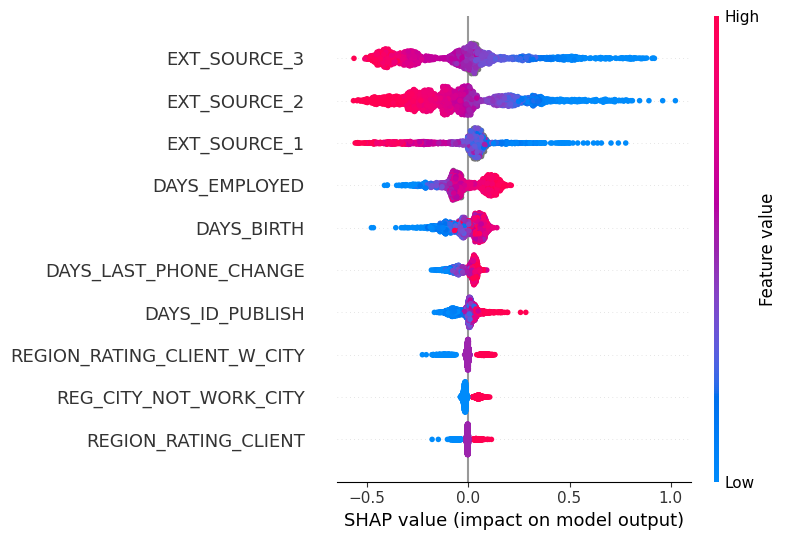

In [41]:
# =====================================
# SHAP analysis for a MLflow XGBoost run
# =====================================

import mlflow
import mlflow.sklearn
import shap
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path

# -----------------------------
# 1) PARAMÈTRES À MODIFIER
# -----------------------------
RUN_ID = "220b6b0558b049688b2ece173f794542" 
TARGET_COL = "TARGET"              # nom de la colonne cible

# -----------------------------
# 2) RÉCUPÉRER LE MODÈLE DU RUN
# -----------------------------
print(f"🔍 Loading model from run: {RUN_ID}")

model_uri = f"runs:/{RUN_ID}/model"
model = mlflow.sklearn.load_model(model_uri)   # ça charge directement le pipeline (imputer + scaler + model)

print("✅ Model loaded from MLflow")

# -----------------------------
# 3) RÉCUPÉRER LES FEATURES UTILISÉES
# -----------------------------
# On récupère les paramètres loggés par MLflow
run = mlflow.get_run(RUN_ID)

feature_set_name = run.data.params["feature_set"]
print(f"📌 Feature set utilisé: {feature_set_name}")

# On récupère les features depuis ton dictionnaire déjà en mémoire
X = df_train[feature_sets[feature_set_name]]
y = df_train[TARGET_COL]

# -----------------------------
# 4) SAMPLE (pour accélérer SHAP)
# -----------------------------
X_sample = X.sample(n=2000, random_state=42)  # SHAP peut être très lent sur dataset complet

# -----------------------------
# 5) CALCUL SHAP VALUES
# -----------------------------
print("⚙️ Calcul des SHAP values...")

# si le modèle est un XGBoost dans un pipeline -> on récupère la dernière étape "model"
if hasattr(model, "named_steps"):
    booster = model.named_steps["model"]
else:
    booster = model  # si jamais pas de pipeline

explainer = shap.TreeExplainer(booster)

# SHAP nécessite les données transformées (Scaler + Imputer via pipeline)
X_transformed = model[:-1].transform(X_sample)  # toutes les étapes sauf le modèle final
shap_values = explainer.shap_values(X_transformed)

print("✅ SHAP values computed")

# -----------------------------
# 6) PLOTS
# -----------------------------
print("📊 Rendering SHAP summary plot...")
shap.summary_plot(shap_values, X_sample, plot_type="dot")


🔍 SHAP local force-plot pour l'index 0


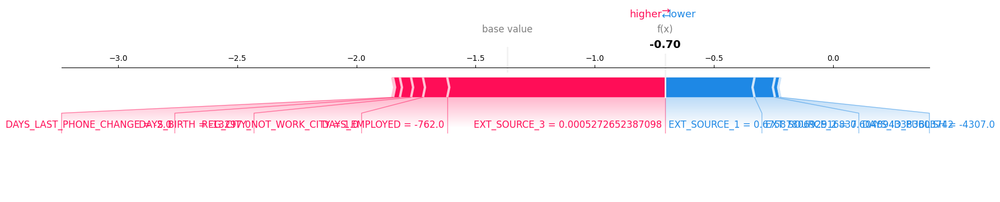

📉 Waterfall plot SHAP pour l'index 0


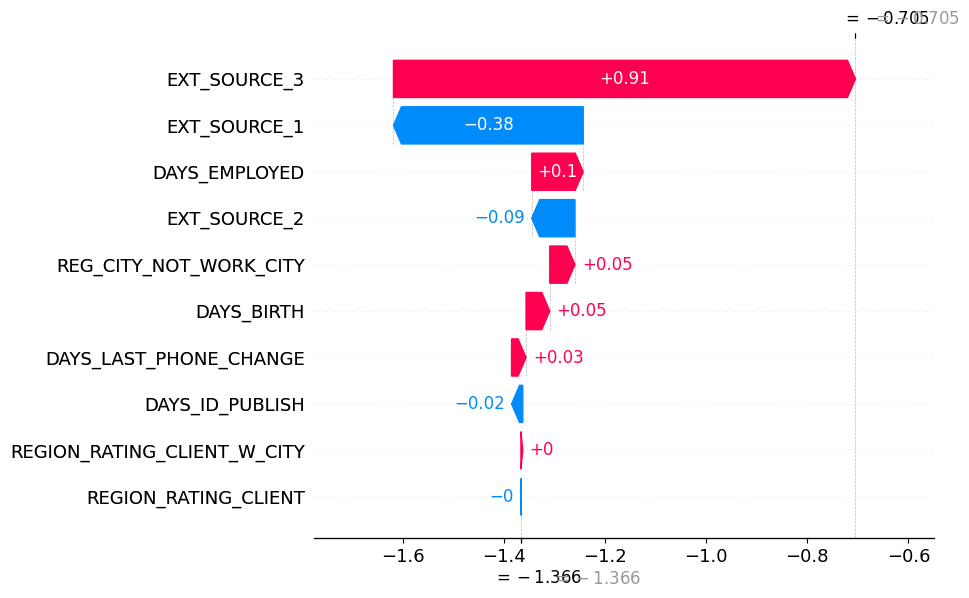

📊 Barplot des contributions locales pour l'index 0


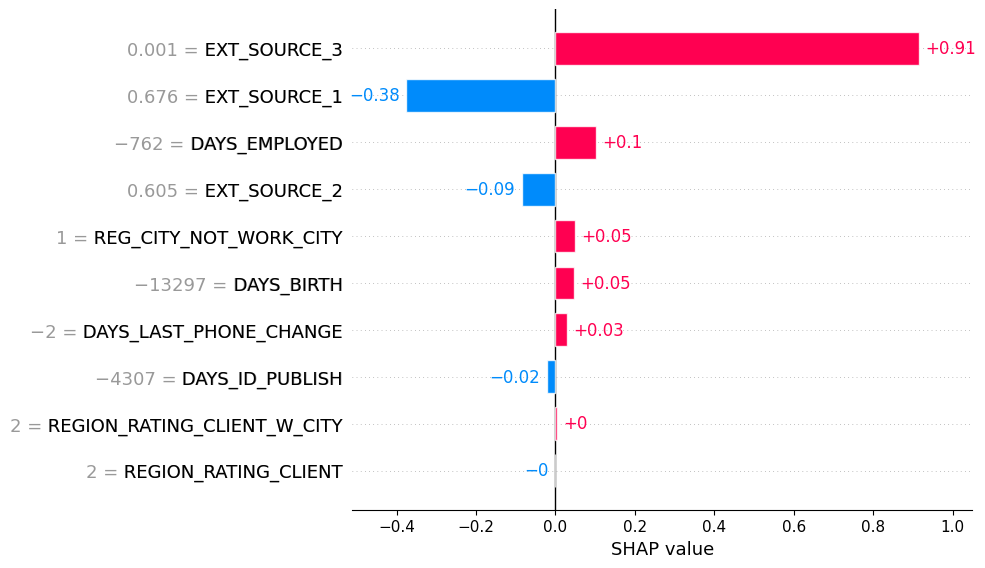

In [45]:
# ============================================
# 7) IMPORTANCE LOCALE SHAP (EXPLICATION LOCALE)
# ============================================

# Choisir un index dans X_sample
index = 0   # exemple : première ligne
x_instance = X_sample.iloc[[index]]

# Transformer la ligne (imputer + scale)
x_transformed = model[:-1].transform(x_instance)

# SHAP values pour cet échantillon
shap_local = explainer.shap_values(x_transformed)[0]

# -----------------------------
# 7A) Force plot (visualisation intuitive)
# -----------------------------
print(f"🔍 SHAP local force-plot pour l'index {index}")

shap.initjs()
shap.force_plot(
    explainer.expected_value, 
    shap_local, 
    x_instance,
    matplotlib=True
)
plt.show()

# -----------------------------
# 7B) Waterfall plot (lecture détaillée des effets)
# -----------------------------
print(f"📉 Waterfall plot SHAP pour l'index {index}")

shap.plots._waterfall.waterfall_legacy(
    explainer.expected_value,
    shap_local,
    feature_names=x_instance.columns
)
plt.show()

# -----------------------------
# 7C) Barplot des contributions locales
# -----------------------------
print(f"📊 Barplot des contributions locales pour l'index {index}")

# Create a SHAP Explanation object for the bar plot
local_explanation = shap.Explanation(
    values=shap_local,
    base_values=explainer.expected_value,
    data=x_instance.values[0],           # <<< transformer en vecteur 1D !
    feature_names=x_instance.columns
)

shap.plots.bar(local_explanation, max_display=10)
plt.show()


# Export du modèle

In [12]:
mlflow.set_tracking_uri("file:///C:/Users/HDGW0570/Documents/Projet_7/mlruns")
mlflow.get_tracking_uri()


'file:///C:/Users/HDGW0570/Documents/Projet_7/mlruns'

In [13]:
import joblib
import mlflow

mlflow.set_tracking_uri("file:///C:/Users/HDGW0570/Documents/Projet_7/mlruns")

best_model = mlflow.sklearn.load_model("runs:/220b6b0558b049688b2ece173f794542/model")

joblib.dump(best_model, "model.pkl")


['model.pkl']

In [7]:
import mlflow
mlflow.get_tracking_uri()


'file:///C:/Users/HDGW0570/Documents/Projet_7/notebooks/mlruns'

In [8]:
import mlflow

